In [1]:
import warnings
warnings.filterwarnings('ignore')
warnings.simplefilter('ignore')
import pandas as pd # for creation of data frames
import numpy as np #
import pyls # PLS: behavioral and mean-centered
import seaborn as sns
import nibabel as nib # for loading niftis etc. as arrays
import matplotlib.pyplot as plt # for plotting data
#the output of plotting commands is displayed inline, directly below the code cell that produced it
%matplotlib inline 
import os,glob
from nilearn import plotting, input_data, image #for plotting & working with niftis
from scipy import stats 

import pathlib
import pyxnat

###################### update path!! #####################################
base_path = '/root_dir/' ####
##########################################################################

#import qBOLD functions
import sys
sys.path.append(os.path.join(base_path + 'scripts/'))
import mqBOLD_functions as qB


### define FSL directories ######################################################
os.environ["FSLDIR"]='/usr/share/fsl/5.0'
os.environ["FSLOUTPUTTYPE"]='NIFTI_GZ'
os.environ["FSLTCLSH"]='/usr/bin/tclsh'
os.environ["FSLWISH"]='/usr/bin/wish'
os.environ["FSLMULTIFILEQUIT"]="True"
os.environ["LD_LIBRARY_PATH"]='/usr/share/fsl/5.0:/usr/lib/fsl/5.0'


#define ANTS directories
os.environ["ANTSPATH"] = '/opt/ants/bin'
os.environ["PATH"] = f'{os.environ["ANTSPATH"]}:{os.environ["PATH"]}'
if "LD_LIBRARY_PATH" in os.environ:
    os.environ["LD_LIBRARY_PATH"] = f'/opt/ants/lib:{os.environ["LD_LIBRARY_PATH"]}'
else:
    os.environ["LD_LIBRARY_PATH"] = '/opt/ants/lib'
#################################################################################

## define variables (please check!)

In [56]:
data_dir = base_path + 'manuscript/data/'
derivatives_dir = data_dir + 'derivatives'
raw_dir = data_dir + 'rawdata'
results_dir = base_path + 'results'

MNI_2mm_brain = derivatives_dir + '/MNI152_T1_2mm_brain.nii.gz'

sns.set_style("whitegrid")
fontsize=25
sids=[76, 77, 78, 79, 70, 71, 72, 73, 74, 75]
conds = ['control', 'calc']
N_subj = len(sids)

coords=(-15, 0, 15, 30, 45, 60, 75, 90)

## run qBOLD toolbox
%run qBOLD_fun.ipynb

df_participants = pd.read_csv(data_dir + '/participants.tsv',sep='\t')

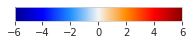

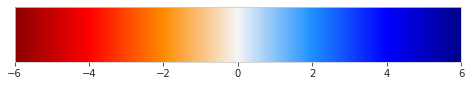

In [4]:
from matplotlib.colors import ListedColormap
from matplotlib.colors import LinearSegmentedColormap
import matplotlib as mpl

colors = ["darkblue", "blue", "dodgerblue",  "whitesmoke","darkorange", "red", "darkred"]
BlueRed = LinearSegmentedColormap.from_list("mycmap", colors)

fig, ax = plt.subplots(figsize=(3,0.5))
fig.subplots_adjust(bottom=0.5)

bounds = [-6, -4, -2, 0, 2, 4, 6]
norm = mpl.colors.Normalize(vmin=-6, vmax=6)

fig.colorbar(mpl.cm.ScalarMappable(norm=norm, cmap=BlueRed), 
             cax=ax, ticks=bounds, orientation='horizontal')

## inverted colormap: BlueRed_r
colors = [ "darkred","red", "darkorange", "whitesmoke", "dodgerblue", "blue","darkblue"]
BlueRed_r = LinearSegmentedColormap.from_list("mycmap", colors)

fig, ax = plt.subplots(figsize=(8, 2))
fig.subplots_adjust(bottom=0.5)

bounds = [-6, -4, -2, 0, 2, 4, 6]
norm = mpl.colors.Normalize(vmin=-6, vmax=6)

fig.colorbar(mpl.cm.ScalarMappable(norm=norm, cmap=BlueRed_r), 
             cax=ax, ticks=bounds, orientation='horizontal')

## Sensitivity analysis: CBV normalization and CBF scaling

In [142]:
###sensitivity of: CBV normalization (2.5%), CBF scaling, OEF: c-parameter

## take median values of R2', CBV, CBF and re-calculate CMRO2, based on range of constant values

## median values: R2': 5.3, CBV: 4.8, OEF: 0.39, CBF: 44.5 --> CMRO2: 127.8

TE=30
BOLD_arr = np.array([0.4])
R2s_baseline_arr = np.array([5.3])
#CBV_arr = np.array([4.8])
CBF_arr_baseline = np.array([36])
CBF_arr_task = np.array([40])

O2sat = 98

########################
## parameters to vary ##
########################
##these are median parameter values
Hct=40
WM_CBV = 0.025
scaling_factor = 0.75

## in percent: vary in 2-percent steps, from -10 to 10 %
Hct_range=np.arange(Hct-0.1*Hct, Hct+0.12*Hct, 0.02*Hct)
WM_CBV_range = np.arange(WM_CBV-0.1*WM_CBV, WM_CBV+0.11*WM_CBV, 0.02*WM_CBV)
scaling_factor_range = np.arange(scaling_factor-0.1*scaling_factor, scaling_factor+0.12*scaling_factor, 0.02*scaling_factor)


Scalings = pd.DataFrame()
    

#########################################################
## CBF scaling factor ##
#########################################################
##these are median parameter values
Hct=40
WM_CBV = 0.025

CMRO2_baseline = np.zeros((11))
CMRO2_perc = np.zeros((11))


for s, scaling_factor in enumerate(scaling_factor_range):
    #print(Hct)
    ########################
    ## normalize CBV   ###
    ########################

    CBV_in = 5.5
    WM_aver = 3
    CBV_arr = CBV_in * WM_CBV/aver * 100
    print(CBV_arr)


    ########################
    ## calculate R2'     ###
    ########################

    ##recalcalute task R2' based on R2' baseline and BOLD change
    R2s_Fujita = FujitaR2ptask_nii(R2s_baseline_arr, BOLD_arr, TE)

    ###################
    ## calculate OEF ##
    ###################

    # [Hz], physiologic constant derived from literature
    # 0.85: factor for small-vessel hematocrit
    C = 4/3*267.61918*np.pi*0.264*(Hct/100)*0.85*3; # 317 Hz

    rCBV = CBV_arr/100.0; #CBV fraction, e.g. CBV_WM = 0.015
    eps=2.2204e-16 #to not divide by zero
    rOEF_task = (R2s_Fujita / (C*rCBV+eps))
    rOEF_baseline = (R2s_baseline_arr / (C*rCBV+eps))

    #print(rOEF_baseline)
    
    #####################
    ## calculate CMRO2 ##
    #####################

    # upscale CSF by 25% because of scanner
    CBF_upscaled_task = CBF_arr_task / scaling_factor # upscale CSF by 25% because of scanner
    CBF_upscaled_base = CBF_arr_baseline / scaling_factor # upscale CSF by 25% because of scanner

    #calculate CaO2 value per subject, O2sat as a fraction
    CaO2 = 0.334 * Hct * 55.6 * float(O2sat)/100;

    ## calculate CMRO2 parameter map
    CMRO2_task = CBF_upscaled_task * rOEF_task * CaO2 /100;
    CMRO2_baseline[s] = CBF_upscaled_base * rOEF_baseline * CaO2 /100;
    CMRO2_perc[s] = (CMRO2_task - CMRO2_baseline[s]) / CMRO2_baseline[s] *100

    print('CMRO2 baseline:' + str(CMRO2_baseline[s]))
    print('CMRO2 %:' + str(CMRO2_perc[s]))

## put in table
Scalings['CMRO2 baseline: varying CBF scaling'] = CMRO2_baseline
#Scalings['CMRO2 %'] = CMRO2_perc


#########################################################
## Hct variation ##
#########################################################
##these are median parameter values
WM_CBV = 0.025
scaling_factor = 0.75

CMRO2_baseline = np.zeros((11))
CMRO2_perc = np.zeros((11))
for s, Hct in enumerate(Hct_range):
    #print(Hct)
    ########################
    ## normalize CBV   ###
    ########################

    CBV_in = 5.5
    WM_aver = 3
    CBV_arr = CBV_in * WM_CBV/aver * 100
    #print(CBV_arr)


    ########################
    ## calculate R2'     ###
    ########################

    ##recalcalute task R2' based on R2' baseline and BOLD change
    R2s_Fujita = FujitaR2ptask_nii(R2s_baseline_arr, BOLD_arr, TE)

    ###################
    ## calculate OEF ##
    ###################

    # [Hz], physiologic constant derived from literature
    # 0.85: factor for small-vessel hematocrit
    C = 4/3*267.61918*np.pi*0.264*(Hct/100)*0.85*3; # 317 Hz

    rCBV = CBV_arr/100.0; #CBV fraction, e.g. CBV_WM = 0.015
    eps=2.2204e-16 #to not divide by zero
    rOEF_task = (R2s_Fujita / (C*rCBV+eps))
    rOEF_baseline = (R2s_baseline_arr / (C*rCBV+eps))

    #print(rOEF_baseline)
    
    #####################
    ## calculate CMRO2 ##
    #####################

    # upscale CSF by 25% because of scanner
    CBF_upscaled_task = CBF_arr_task / scaling_factor # upscale CSF by 25% because of scanner
    CBF_upscaled_base = CBF_arr_baseline / scaling_factor # upscale CSF by 25% because of scanner

    #calculate CaO2 value per subject, O2sat as a fraction
    CaO2 = 0.334 * Hct * 55.6 * float(O2sat)/100;

    ## calculate CMRO2 parameter map
    CMRO2_task = CBF_upscaled_task * rOEF_task * CaO2 /100;
    CMRO2_baseline[s] = CBF_upscaled_base * rOEF_baseline * CaO2 /100;
    CMRO2_perc[s] = (CMRO2_task - CMRO2_baseline[s]) / CMRO2_baseline[s] *100

    print('CMRO2 baseline:' + str(CMRO2_baseline[s]))
    print('CMRO2 %:' + str(CMRO2_perc[s]))

## put in table
Scalings['CMRO2 baseline: varying Hct'] = CMRO2_baseline
#Scalings['CMRO2 %'] = CMRO2_perc

#########################################################
## CBV normalization variation ##
#########################################################
##these are median parameter values
Hct=40
scaling_factor = 0.75

CMRO2_baseline = np.zeros((11))
CMRO2_perc = np.zeros((11))
for s, WM_CBV in enumerate(WM_CBV_range):
    #print(Hct)
    ########################
    ## normalize CBV   ###
    ########################

    CBV_in = 5.5
    WM_aver = 3
    CBV_arr = CBV_in * WM_CBV/aver * 100
    print(CBV_arr)


    ########################
    ## calculate R2'     ###
    ########################

    ##recalcalute task R2' based on R2' baseline and BOLD change
    R2s_Fujita = FujitaR2ptask_nii(R2s_baseline_arr, BOLD_arr, TE)

    ###################
    ## calculate OEF ##
    ###################

    # [Hz], physiologic constant derived from literature
    # 0.85: factor for small-vessel hematocrit
    C = 4/3*267.61918*np.pi*0.264*(Hct/100)*0.85*3; # 317 Hz

    rCBV = CBV_arr/100.0; #CBV fraction, e.g. CBV_WM = 0.015
    eps=2.2204e-16 #to not divide by zero
    rOEF_task = (R2s_Fujita / (C*rCBV+eps))
    rOEF_baseline = (R2s_baseline_arr / (C*rCBV+eps))

    #print(rOEF_baseline)
    
    #####################
    ## calculate CMRO2 ##
    #####################

    # upscale CSF by 25% because of scanner
    CBF_upscaled_task = CBF_arr_task / scaling_factor # upscale CSF by 25% because of scanner
    CBF_upscaled_base = CBF_arr_baseline / scaling_factor # upscale CSF by 25% because of scanner

    #calculate CaO2 value per subject, O2sat as a fraction
    CaO2 = 0.334 * Hct * 55.6 * float(O2sat)/100;

    ## calculate CMRO2 parameter map
    CMRO2_task = CBF_upscaled_task * rOEF_task * CaO2 /100;
    CMRO2_baseline[s] = CBF_upscaled_base * rOEF_baseline * CaO2 /100;
    CMRO2_perc[s] = (CMRO2_task - CMRO2_baseline[s]) / CMRO2_baseline[s] *100

    print('CMRO2 baseline:' + str(CMRO2_baseline[s]))
    print('CMRO2 %:' + str(CMRO2_perc[s]))

## put in table
Scalings['CMRO2 baseline: varying CBV normalization'] = CMRO2_baseline
Scalings['CMRO2 %'] = CMRO2_perc

4.583333333333334
CMRO2 baseline:148.7272459228823
CMRO2 %:8.315863032844147
4.583333333333334
CMRO2 baseline:145.49404492455878
CMRO2 %:8.315863032844138
4.583333333333334
CMRO2 baseline:142.3984269474405
CMRO2 %:8.315863032844174
4.583333333333334
CMRO2 baseline:139.43179305270215
CMRO2 %:8.315863032844158
4.583333333333334
CMRO2 baseline:136.58624625570823
CMRO2 %:8.315863032844154
4.583333333333334
CMRO2 baseline:133.85452133059405
CMRO2 %:8.315863032844184
4.583333333333334
CMRO2 baseline:131.22992287313141
CMRO2 %:8.315863032844174
4.583333333333334
CMRO2 baseline:128.70627051018658
CMRO2 %:8.315863032844165
4.583333333333334
CMRO2 baseline:126.27785031188118
CMRO2 %:8.315863032844156
4.583333333333334
CMRO2 baseline:123.93937160240192
CMRO2 %:8.315863032844137
4.583333333333334
CMRO2 baseline:121.68592848235824
CMRO2 %:8.315863032844147
CMRO2 baseline:133.85452133059408
CMRO2 %:8.315863032844183
CMRO2 baseline:133.85452133059408
CMRO2 %:8.315863032844183
CMRO2 baseline:133.85452

# New data: Preprocessing

## calculate OEF: downsample to CBF lowres first!

### downsample to CBF lowres

sub-p074
sub-r074
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r074
Using single precision for computations.
Input scalar image: /home/tumnic/sepp/neuroenergeticslab_notebooks/erc-wp1/manuscript/results/N40_cond-control_space-MNI152_median_cbv.nii.gz
Reference image: /home/tumnic/sepp/neuroenergeticslab_notebooks/erc-wp1/tmp/p074/mri2/sub-p074/anat/sub-p074_desc-preproc_T1w.nii.gz
The composite transform comprises the following transforms (in order): 
  1. /home/tumnic/sepp/neuroenergeticslab_notebooks/erc-wp1/tmp/p074/mri2/sub-p074/anat/sub-p074_from-MNI152NLin6Asym_to-T1w_mode-image_xfm.h5[0] (type = DisplacementFieldTransform)
  2. /home/tumnic/sepp/neuroenergeticslab_notebooks/erc-wp1/tmp/p074/mri2/sub-p074/anat/sub-p074_from-MNI152NLin6Asym_to-T1w_mode-image_xfm.h5[1] (type = AffineTransform)
Default pixel value: 0
Interpolation type: LinearInterpolateImageFunction
Output warped image: /home/tumnic/sepp/neuroenergeticslab_notebooks/erc-wp1/tmp/p074/mri2/qBOLD/task-c

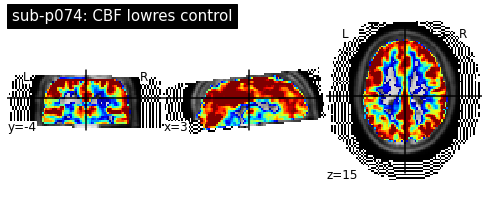

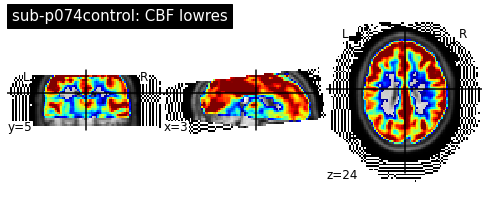

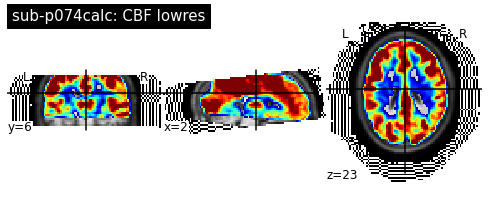

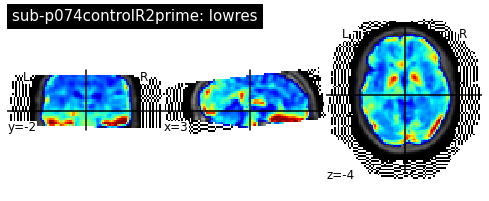

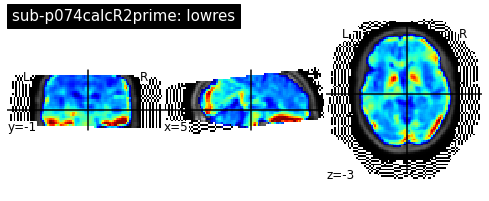

...

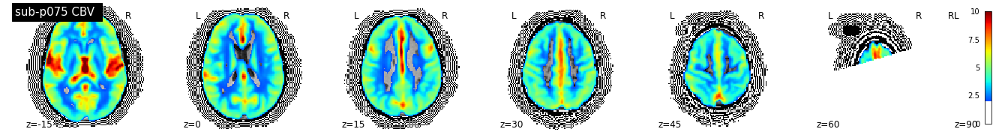

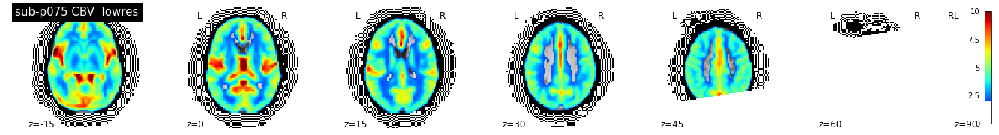

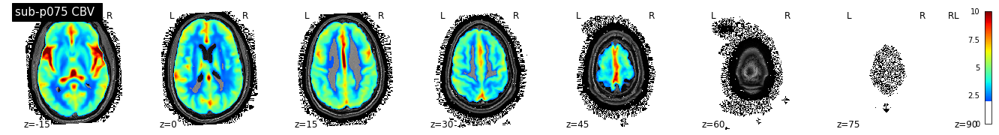

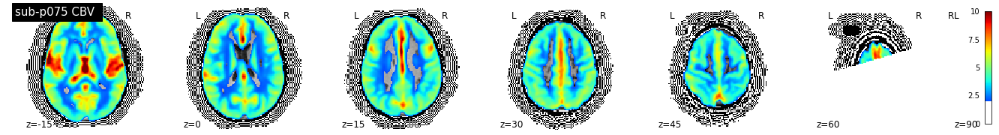

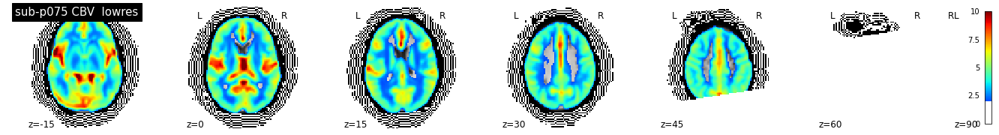

In [58]:
## Co-register all parameter maps to CBF control Lowres
parameters = ['R2prime', 'cbv']

for i,ID in enumerate(sids):
    sub = "sub-p{:03d}".format(ID) # subject id, eg 'p021'
    subj_id = "p{:03d}".format(ID) # subject id, eg 'p021'
    print(sub)

        
    dir_deriv = os.path.join(data_dir, 'derivatives',  sub)
    if not os.path.exists(dir_deriv):
        os.mkdir(dir_deriv)
    dir_deriv_anat = os.path.join(data_dir, 'derivatives',  sub, 'anat')
    if not os.path.exists(dir_deriv_anat):
        os.mkdir(dir_deriv_anat)
    dir_deriv_func = os.path.join(data_dir, 'derivatives',  sub, 'func')
    if not os.path.exists(dir_deriv_func):
        os.mkdir(dir_deriv_func)
    dir_deriv_qmri = os.path.join(data_dir, 'derivatives',  sub, 'qmri')
    if not os.path.exists(dir_deriv_qmri):
        os.mkdir(dir_deriv_qmri)
           
    T1w_T2space = os.path.join(dir_deriv_anat, sub + '_space-T2_T1w.nii.gz'))
    T1w_T2space_brain = os.path.join(dir_deriv_anat,sub + '_space-T2_T1w_brain.nii.gz')
    ! bet {T1w_T2space} {T1w_T2space_brain} -f 0.3
    #plotting.plot_img(T1w_T2space_brain, cmap='Greys', title= sub  +': T1w brain')    
    

    CBF_lowres_ctr = os.path.join(dir_deriv_qmri,  sub + '_task-control_space-lowres_cbf.nii.gz')
    #plotting.plot_img(CBF_lowres_ctr,  threshold=0, cmap='jet', title= sub + ': CBF lowres brain')    

    ## first, generate transform from T1w T2 space to CBF lowres ()
    T1w_lowres = os.path.join(dir_deriv_anat,  sub + '_space-lowres_T1w.nii.gz')
    T1w_lowres_brain = os.path.join(dir_deriv_anat,  sub + '_space-lowres_T1w_brain.nii.gz')
    T2_to_lowres = os.path.join(dir_deriv_anat,   sub + '_space-T2_to_space-lowres.mat')
    
    ! flirt -in {T1w_T2space_brain} -ref {CBF_lowres_ctr} -omat {T2_to_lowres} -out {T1w_lowres_brain} -dof 6 
    ! flirt -in {T1w_T2space} -ref {CBF_lowres_ctr}  -applyxfm -init {T2_to_lowres} -out {T1w_lowres} 
    plotting.plot_img(CBF_lowres_ctr, bg_img=T1w_lowres, threshold=10, vmax=50, cmap='jet', title= sub + ': CBF lowres control')    

        
    for par in parameters:
        if par =='R2prime':
            for k, cond in enumerate(conds): 
                par_T2 = os.path.join( dir_deriv_qmri, sub + '_task-'+cond+'_space-T2_'+par+'.nii.gz'))
                par_lowres = os.path.join(dir_deriv_qmrisub + '_task-'+cond+'_space-lowres_'+par+'.nii.gz')

                ! flirt -in {par_T2} -ref {T1w_lowres_brain} -applyxfm -init {T2_to_lowres} -out {par_lowres} -dof 6 
                plotting.plot_img(par_lowres, bg_img=T1w_lowres, threshold = 0.2, cmap='jet', title= sub + cond + par +': lowres')            

        ## cbv    
        if par == 'cbv':
            for k, cond in enumerate(conds): 

                if cond == 'calc' or cond == 'control': ## take the average, corrected CBV calc maps
                    T1w = os.path.join(dir_deriv_anat, sub + '_desc-preproc_T1w.nii.gz'))
                    CBV_MNIspace = results_dir + '/N40_cond-'+cond + '_space-MNI152_median_cbv.nii.gz'
                    MNI_to_T1 = os.path.join(dir_deriv_anat, sub + '_from-MNI152NLin6Asym_to-T1w_mode-image_xfm.h5')
                    CBV_T1space = os.path.join(dir_deriv_qmri, sub + 'task-'+cond + '_space-T1w_cbv.nii.gz')
                    ! antsApplyTransforms -d 3 --float 1 --verbose 1 -i {CBV_MNIspace} -r {T1w} -t {MNI_to_T1} -o {CBV_T1space} 
                    plotting.plot_img(CBV_T1space, bg_img = T1w, cmap='jet', cut_coords=coords, display_mode='z',colorbar = True, threshold=2, vmin =0, vmax=10, title=sub + ' CBV ')
                    
                    ## from T1w to T2
                    CBV =   os.path.join(dir_deriv_qmri, sub + '_task-'+cond+ '_space-T2_cbv.nii.gz')
                    ! flirt -in {CBV_T1space} -ref {T1w_T2space} -out {CBV} 
                    plotting.plot_img(CBV, bg_img = T1w_T2space, cmap='jet', cut_coords=coords, display_mode='z',colorbar = True, threshold=2, vmin =0, vmax=10, title=sub + ' CBV ')
                    
                    par_lowres = os.path.join(dir_deriv_qmri, sub + '_task-'+cond+'_space-lowres_'+par+'.nii.gz')
                    ## from T2 to lowres CBF
                    ! flirt -in {CBV} -ref {T1w_lowres_brain} -applyxfm -init {T2_to_lowres} -out {par_lowres} -dof 6
                    plotting.plot_img(par_lowres, bg_img = T1w_lowres, cmap='jet', cut_coords=coords, display_mode='z',colorbar = True, threshold=2, vmin =0, vmax=10, title=sub + ' CBV  lowres')

### calculate OEF lowres

sub-p021
sub-r076
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r076
sub-p054
sub-r077
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r077
sub-p059
sub-r078
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r078
sub-p060
sub-r079
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r079
sub-p070
sub-r070
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r070
sub-p071
sub-r071
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r071
sub-p072
sub-r072
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r072
sub-p073
sub-r073
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r073
sub-p074
sub-r074
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r074
sub-p075
sub-r075
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r075


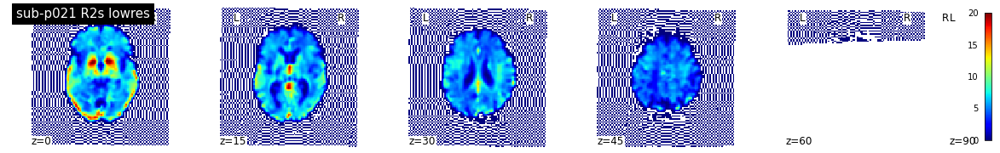

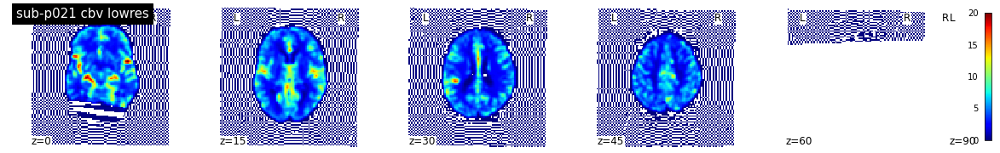

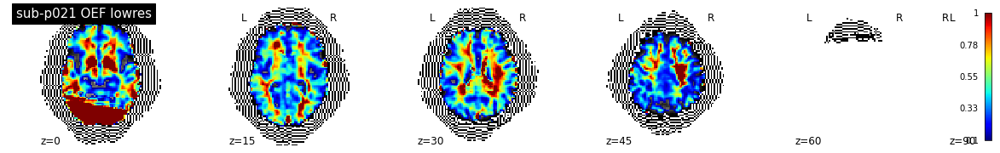

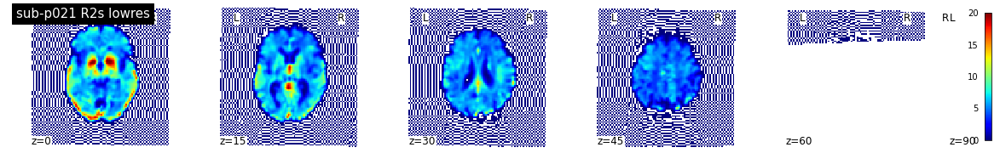

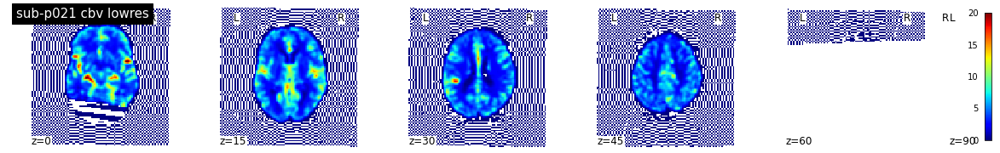

...

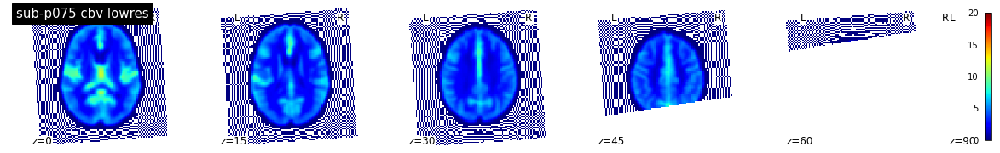

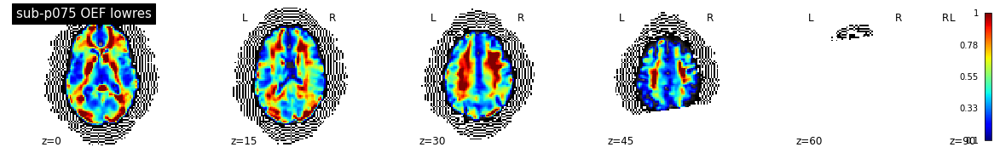

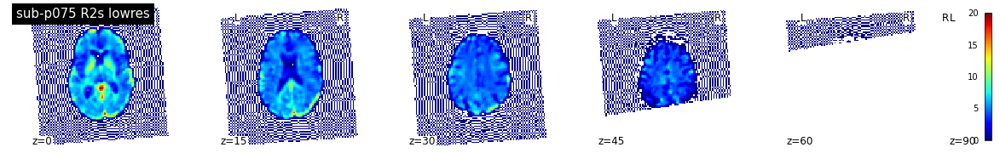

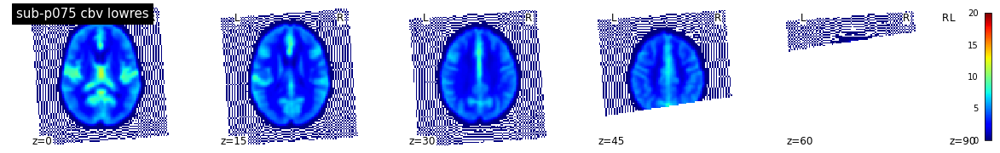

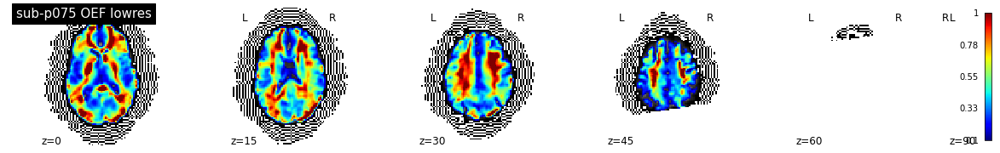

In [61]:
coords=(0, 15, 30, 45, 60, 75, 90)

TE=30

conds = ['control', 'calc']


for i, ID in enumerate(sids): #loop over subjects
    sub = "sub-p{:03d}".format(ID) # subject id, eg 'p021'
    subj_id = "p{:03d}".format(ID) # subject id, eg 'p021'
    print(sub)
    

    dir_deriv = os.path.join(data_dir, 'derivatives',  sub)
    dir_deriv_anat = os.path.join(data_dir, 'derivatives',  sub, 'anat')
    dir_deriv_func = os.path.join(data_dir, 'derivatives',  sub, 'func')
    dir_deriv_qmri = os.path.join(data_dir, 'derivatives',  sub, 'qmri')
        
 
    T1w_T2space_brain = os.path.join(dir_deriv_anat',sub + '_space-T2_T1w_brain.nii.gz')
    T2_to_lowres = os.path.join(dir_deriv_anat,  sub + '_space-T2_to_space-lowres.mat')
    T1w_lowres_brain = os.path.join(dir_deriv_anat, sub + '_space-lowres_T1w_brain.nii.gz')
   
    # download O2 sat & hematocrit values from xnat
    if ID < 70:
        Hct = df_participants.query('participant_id==@sub')['Hct'].values
        O2sat = df_participants.query('participant_id==@sub')['O2sat'].values
    if ID > 70:
        Hct = 38
        O2sat = 98    
        
    for cond in conds:
        ## load R2`
        R2s = os.path.join(dir_deriv_qmri, sub + '_task-'+cond+'_space-lowres_R2prime.nii.gz')
        R2s_nii = nib.load(R2s)
        R2s_arr = np.array(R2s_nii.dataobj)
        plotting.plot_img(R2s, cmap='jet', cut_coords=coords, display_mode='z',colorbar = True, threshold=0, vmin =0, vmax=20, title=sub + ' R2s lowres')

        ###################
        ## calculate OEF ##
        ###################
        ## download corrected CBV map           
        if cond == 'calc' or cond == 'control' : ## for calc, we take the corrected CBV values!
                CBV = os.path.join(dir_deriv_qmri, sub + '_task-'+cond+'_space-lowres_cbv.nii.gz')

        if cond == 'mem' : ## for calc, we take the corrected CBV values!
                CBV =  os.path.join(dir_deriv_qmri,  sub + '_task-control_space-lowres_cbv.nii.gz')
        CBV_nii = nib.load(CBV)
        CBV_arr = np.array(CBV_nii.dataobj)
        plotting.plot_img(CBV, cmap='jet', cut_coords=coords, display_mode='z',colorbar = True, threshold=0, vmin =0, vmax=20, title=sub + ' cbv lowres')

        ##download brain mask
        BrMsk_CSF = os.path.join(dir_deriv_anat, 'BrMsk_CSF_space-lowres.nii.gz')
        
        mask = BrMsk_CSF_arr>0;

        # [Hz], physiologic constant derived from literature
        # 0.85: factor for small-vessel hematocrit
        C = 4/3*267.61918*np.pi*0.264*(Hct/100)*0.85*3; # 317 Hz

        rCBV = CBV_arr/100.0; #CBV fraction, e.g. CBV_WM = 0.015
        rCBV[rCBV < 0] = 0;
        eps=2.2204e-16 #to not divide by zero
        rOEF = (R2s_arr/ (C*rCBV+eps)) * mask

        # reasonable boundary to avoid unreasonably high hot spots
        #rOEFmax_DSC = 5*np.nanmedian(rOEF[mask]);
        rOEFmax_DSC = 5*np.nanmedian(rOEF[mask]);
        if rOEFmax_DSC < 1.5:
                rOEFmax_DSC = 1.5 # FIXED Threshold
        rOEF[abs(rOEF) > rOEFmax_DSC] = rOEFmax_DSC
        rOEF = rOEF *mask

        rOEF_img = nib.Nifti1Image(rOEF, R2s_nii.affine)
        nib.save(rOEF_img,  os.path.join(dir_deriv_qmri, sub + '_task-'+cond+ '_space-lowres_oef.nii.gz'))
        plotting.plot_img(rOEF_img, bg_img = T1w_lowres_brain, cmap='jet', cut_coords=coords, display_mode='z',colorbar = True, threshold=0.1, vmax=1, title=sub + ' OEF lowres')

## calculate CMRO2

sub-p021
sub-r076
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r076
sub-p054
sub-r077
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r077
sub-p059
sub-r078
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r078
sub-p060
sub-r079
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r079
sub-p070
sub-r070
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r070
sub-p071
sub-r071
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r071
sub-p072
sub-r072
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r072
sub-p073
sub-r073
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r073
sub-p074
sub-r074
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r074
sub-p075
sub-r075
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r075


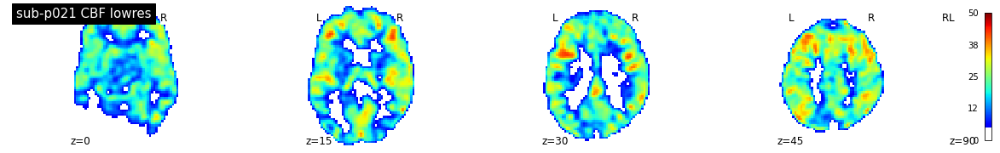

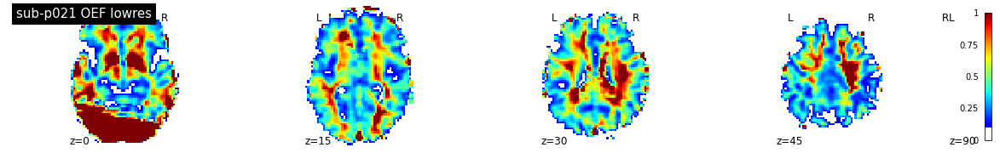

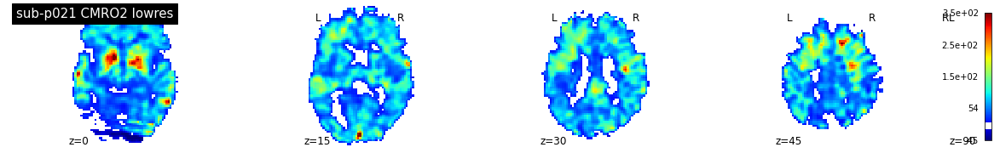

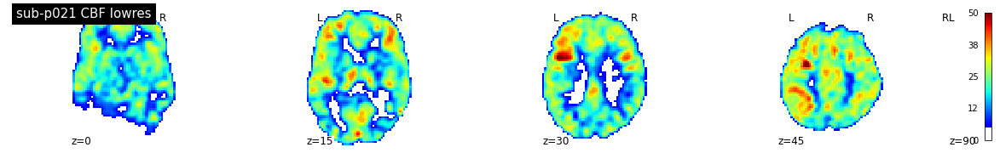

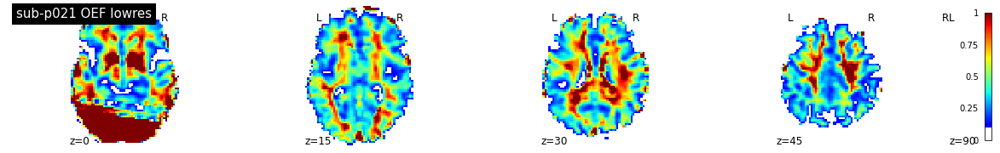

...

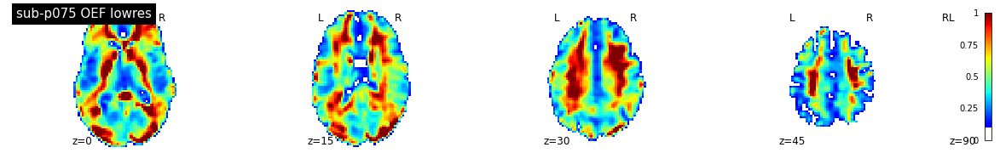

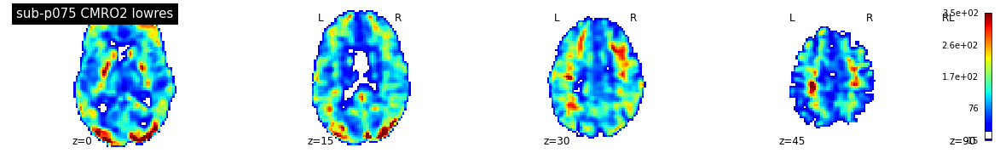

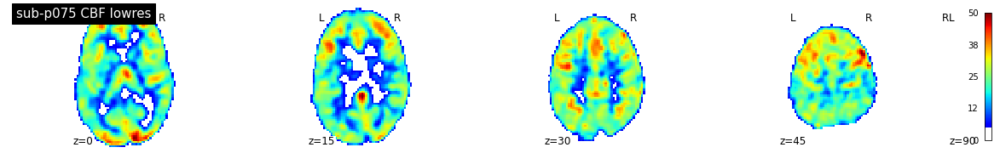

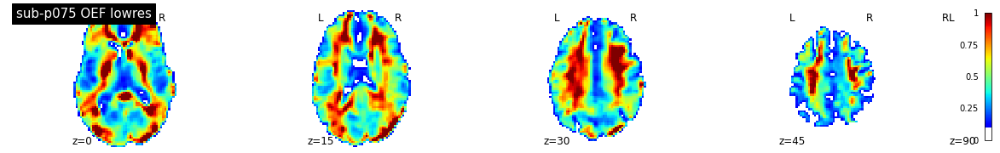

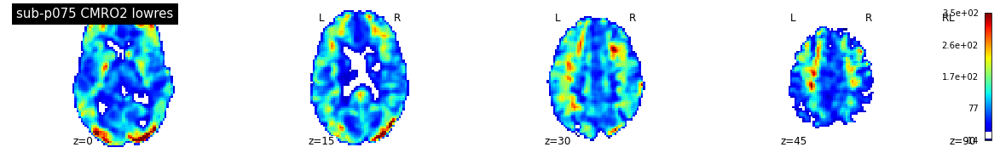

In [62]:
coords=(0, 15, 30, 45, 60, 75, 90)

TE=30

conds = ['control', 'calc']


for i, ID in enumerate(sids): #loop over subjects
    sub = "sub-p{:03d}".format(ID) # subject id, eg 'p021'
    subj_id = "p{:03d}".format(ID) # subject id, eg 'p021'
    print(sub)
    

    dir_deriv = os.path.join(data_dir, 'derivatives',  sub)
    dir_deriv_anat = os.path.join(data_dir, 'derivatives',  sub, 'anat')
    dir_deriv_func = os.path.join(data_dir, 'derivatives',  sub, 'func')
    dir_deriv_qmri = os.path.join(data_dir, 'derivatives',  sub, 'qmri')
    
    # download O2 sat & hematocrit values from xnat
    if ID < 70:
        Hct = df_participants.query('participant_id==@sub')['Hct'].values
        O2sat = df_participants.query('participant_id==@sub')['O2sat'].values
    if ID > 70:
        Hct = 38
        O2sat = 98

    #####################
    ## calculate CMRO2 ##
    #####################
    ##download brain mask: use lowres CBF image
    BrMsk_CSF = os.path.join(dir_deriv_anat, 'BrMsk_CSF_space-lowres.nii.gz')
    BrMsk_CSF_nii = nib.load(BrMsk_CSF)
    BrMsk_CSF_arr = np.array(BrMsk_CSF_nii.dataobj)

    mask = BrMsk_CSF_arr>0;
        
    for cond in conds:

        # download CBF and OEF niftis from xnat
        CBF = os.path.join(dir_deriv_qmri, sub + '_task-' + cond + '_space-lowres_cbf.nii.gz' )
        plotting.plot_img(CBF, cmap='jet', cut_coords=coords, display_mode='z',colorbar = True, threshold=5,vmin=0, vmax=50, title=sub + ' CBF lowres')

        CBF_nii = nib.load(CBF)
        CBF_np= np.array(CBF_nii.dataobj)
        # upscale CSF by 25% because of scanner
        CBF_upscaled = CBF_np / 0.75 # upscale CSF by 25% because of scanner
        
        OEF = os.path.join(dir_deriv_qmri, sub + '_task-'+cond+ '_space-lowres_oef.nii.gz')
        plotting.plot_img(OEF, cmap='jet', cut_coords=coords, display_mode='z',colorbar = True, threshold=0.1,vmin=0, vmax=1, title=sub + ' OEF lowres')

        OEF_nii = nib.load(OEF)
        OEF_np= np.array(OEF_nii.dataobj)

        #calculate CaO2 value per subject, O2sat as a fraction
        CaO2 = 0.334 * Hct * 55.6 * float(O2sat)/100;

        ## calculate CMRO2 parameter map
        CMRO2 = CBF_upscaled * OEF_np * CaO2 /100;
        CMRO2 = CMRO2 * mask

        #store CMRO2 parameter map as nifti
        CMRO2_img = nib.Nifti1Image(CMRO2, OEF_nii.affine)
        nib.save(CMRO2_img, os.path.join(dir_deriv_qmri, sub + '_task-'+cond+ '_space-lowres_cmro2.nii.gz'))            
        CMRO2_lowres = os.path.join(dir_deriv_qmri, sub + '_task-'+cond+ '_space-lowres_cmro2.nii.gz')            
            
        plotting.plot_img(CMRO2_img, cmap='jet', cut_coords=coords, display_mode='z',colorbar = True, threshold=10, vmax=350, title=sub + ' CMRO2 lowres')


## calculate semi-quantitative OEF and CMRO2

### create percchange BOLD images

sub-p021
sub-r076
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r076
sub-p054
sub-r077
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r077
sub-p059
sub-r078
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r078
sub-p060
sub-r079
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r079
sub-p070
sub-r070
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r070
sub-p071
sub-r071
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r071
sub-p072
sub-r072
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r072
sub-p073
sub-r073
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r073
sub-p074
sub-r074
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r074
sub-p075
sub-r075
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r075


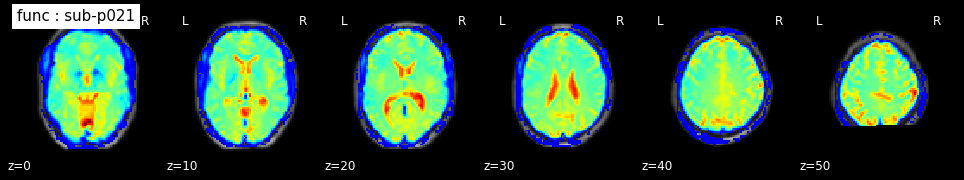

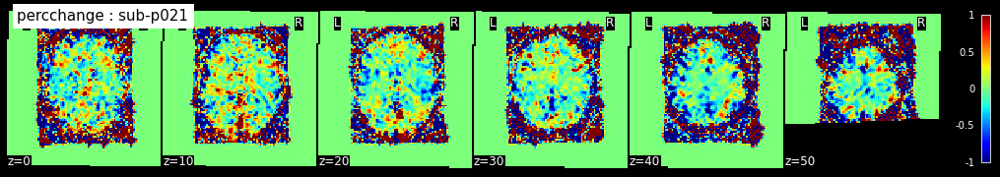

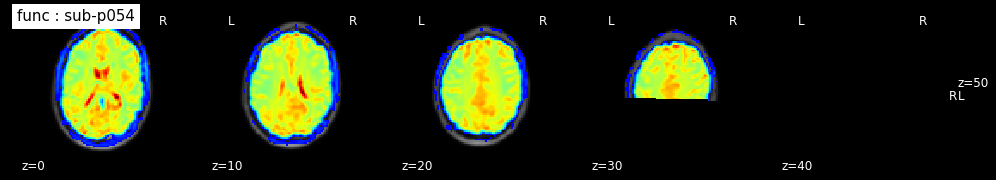

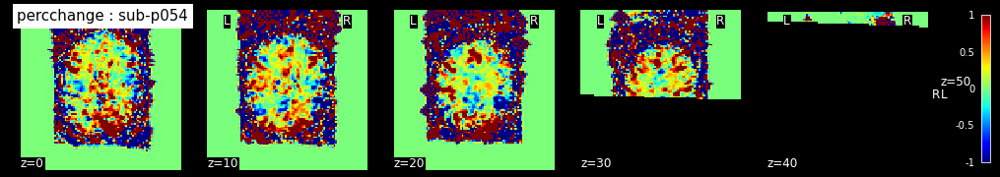

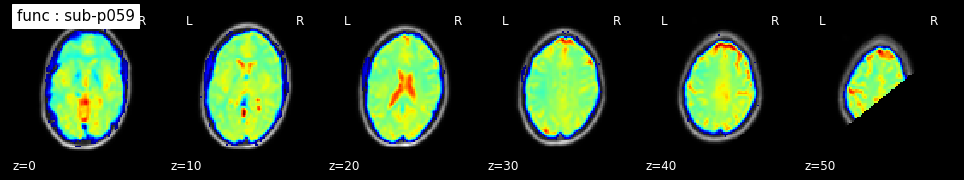

...

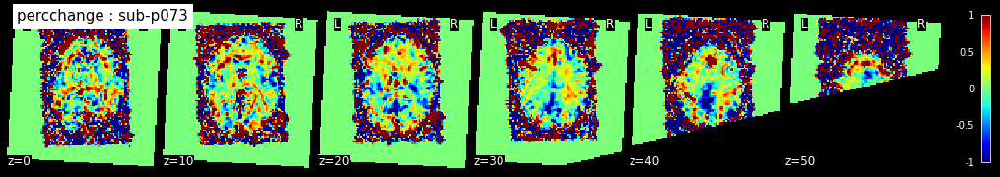

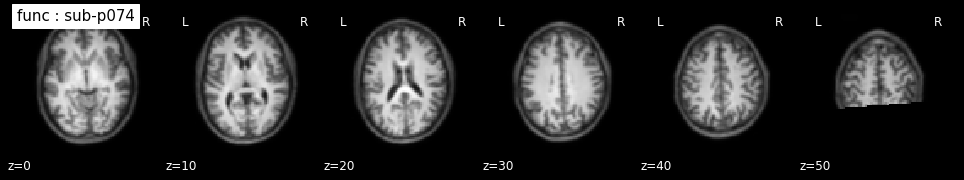

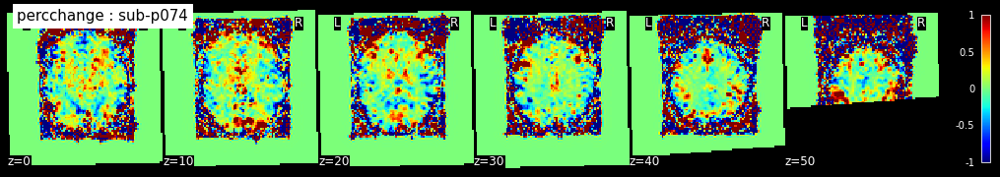

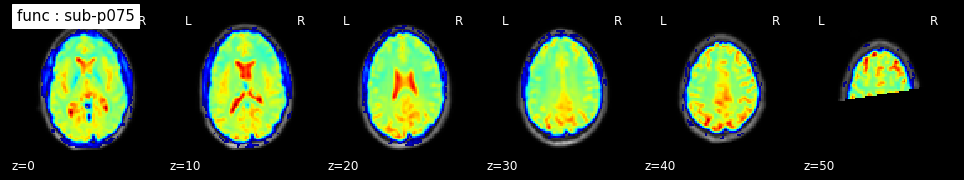

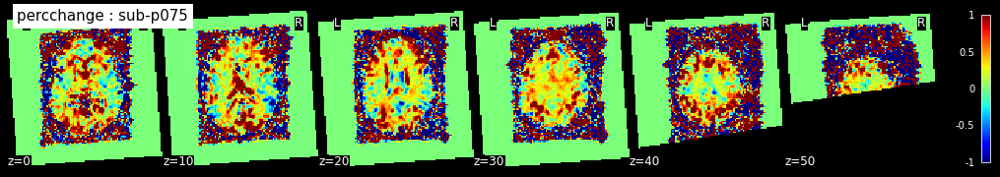

In [64]:
contrasts = ['calccontrol']

## coregister func to T2 map
for i, ID in enumerate(sids): #loop over subjects
    sub = "sub-p{:03d}".format(ID) # subject id, eg 'p021'
    subj_id = "p{:03d}".format(ID) # subject id, eg 'p021'
    print(sub)
    

    dir_deriv = os.path.join(data_dir, 'derivatives',  sub)
    dir_deriv_anat = os.path.join(data_dir, 'derivatives',  sub, 'anat')
    dir_deriv_func = os.path.join(data_dir, 'derivatives',  sub, 'func')
    dir_deriv_qmri = os.path.join(data_dir, 'derivatives',  sub, 'qmri')
    
    
    T1w_lowres_brain = os.path.join(dir_deriv_anat, sub + '_space-lowres_T1w_brain.nii.gz')
    T1w_lowres = os.path.join(dir_deriv_anat,  sub + '_space-lowres_T1w.nii.gz')
    T1w_T1space =  os.path.join(dir_deriv_anat,sub + '_desc-preproc_T1w.nii.gz')
    T1w_T2space = os.path.join(dir_deriv_anat, sub + '_space-T2_T1w.nii.gz'))
    T1w_T2space_brain = os.path.join(dir_deriv_anat,sub + '_space-T2_T1w_brain.nii.gz')
    T1w_to_T2space =  os.path.join(dir_deriv_anat,sub + '_T1w_to_T2space.mat')
    func_lowres = os.path.join(dir_deriv_func,  sub + '_task-locmem_space-lowres_desc-preproc_bold.nii.gz')
        
    ## coregister T1 to lowres space 
    ! epi_reg --epi={func_T1space} --t1={T1w_lowres} --t1brain={T1w_lowres_brain} --out={func_lowres}
    
    func_lowres_slice = image.index_img(func_lowres, 0) ## first volume
    plotting.plot_img(func_lowres_slice,  bg_img =T1w_lowres, cmap='jet',display_mode='z', cut_coords = (0, 10, 20, 30, 40, 50), threshold = 10000, black_bg=True, title = 'func : ' + sub)

## create percchange image ##
#############################                                     
            
    func_img = nib.load(func_lowres)
    func_arr = np.array(func_img.dataobj) 

    ##taking HRF into account, i.e. only take time-points after 5TR = 7sec
    control = func_arr[:, :, :, list(range(80, 100)) + list(range(205, 225)) + list(range(280, 300)) + list(range(355, 375))]
    baseline_control = np.nanmedian(control, axis=3) #median across time-points

    ## get %change per time-point
    percchange_control=np.zeros((func_arr.shape))
    for i in range(0, func_arr.shape[3]):
        percchange_control[:, :, :, i] = 100*(func_arr[:, :, :, i] - baseline_control) / baseline_control

    for l, con in enumerate(contrasts): 

        if con == 'calccontrol':
            percchange = np.nanmedian(percchange_control[:, :, :,list(range(55, 75)) + list(range(155, 175)) + list(range(255, 275)) + list(range(305, 325))], axis=3)

        if con == 'memcontrol':
            percchange = np.nanmedian(percchange_control[:, :, :,list(range(30, 50)) + list(range(105, 125)) + list(range(180, 200)) + list(range(380, 400))], axis=3)

        ## save nifti

        ## save nifti        
        T1w = nib.load(T1w_lowres)
        percchange_img = nib.Nifti1Image(percchange, T1w.affine)
        nib.save(percchange_img, os.path.join(dir_deriv_func,  sub +  '_task-'+con+'_space-lowres_BOLD_percchange.nii.gz'))
        plotting.plot_img(os.path.join(dir_deriv_func,  sub +  '_task-'+con+'_space-lowres_BOLD_percchange.nii.gz'),  cmap='jet', display_mode='z', cut_coords = (0, 10, 20, 30, 40, 50), colorbar=True, black_bg=True, threshold=0, vmin=-1, vmax=1, title = 'percchange : ' + sub)

### create semi-quant OEF and CMRO2 images

sub-p021
sub-r076
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r076
sub-p054
sub-r077
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r077
sub-p059
sub-r078
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r078
sub-p060
sub-r079
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r079
sub-p070
sub-r070
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r070
sub-p071
sub-r071
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r071
sub-p072
sub-r072
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r072
sub-p073
sub-r073
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r073
sub-p074
sub-r074
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r074
sub-p075
sub-r075
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r075


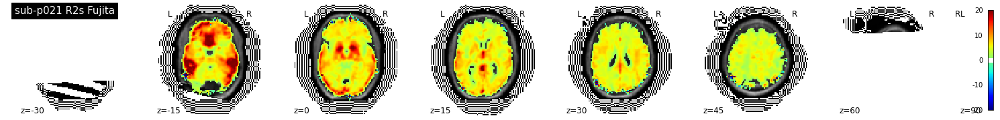

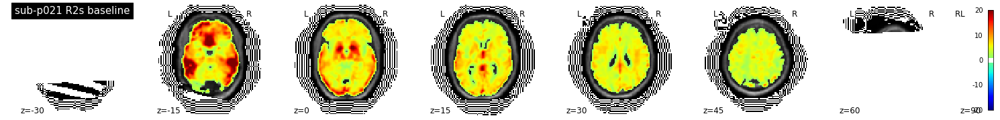

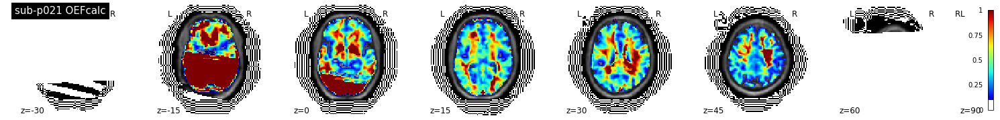

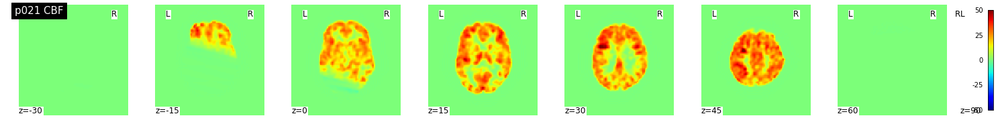

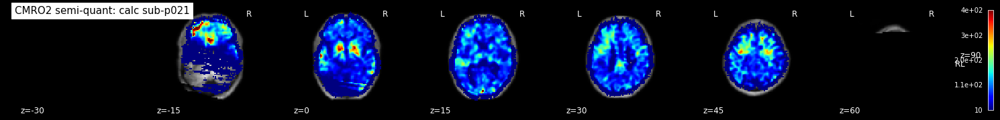

...

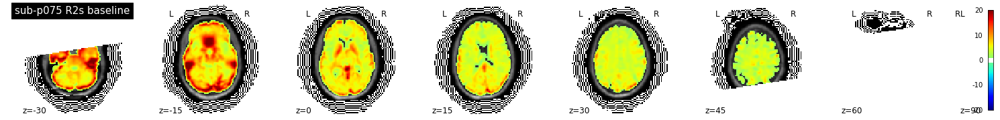

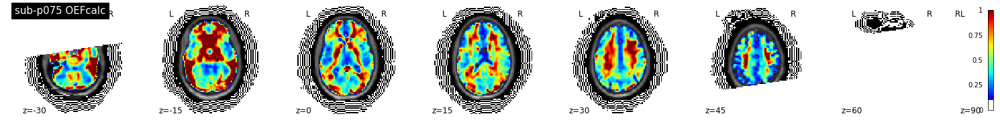

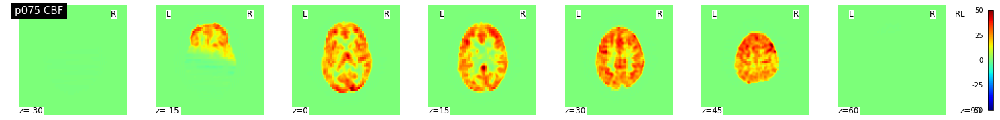

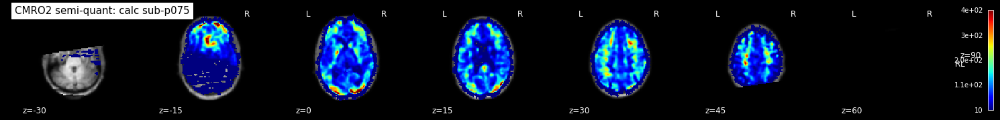

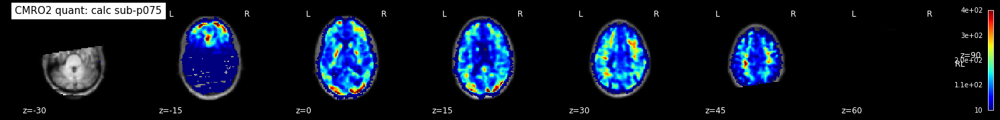

In [65]:

## run qBOLD toolbox
%run qBOLD_fun.ipynb

## which contrast/baseline do we want to look at? ##
#############################################################
baseline='control'
conds=['calc']

#############################################################

coords=(-30, -15, 0, 15, 30, 45, 60, 75, 90)

TE=30

for i, ID in enumerate(sids): #loop over subjects
    sub = "sub-p{:03d}".format(ID) # subject id, eg 'p021'
    subj_id = "p{:03d}".format(ID) # subject id, eg 'p021'
    print(sub)
    

    dir_deriv = os.path.join(data_dir, 'derivatives',  sub)
    dir_deriv_anat = os.path.join(data_dir, 'derivatives',  sub, 'anat')
    dir_deriv_func = os.path.join(data_dir, 'derivatives',  sub, 'func')
    dir_deriv_qmri = os.path.join(data_dir, 'derivatives',  sub, 'qmri')
    
    # download O2 sat & hematocrit values from xnat
    if ID < 70:
        Hct=df_participants.query('participant_id==@sub')['Hct'].values
        O2sat = df_participants.query('participant_id==@sub')['O2sat'].values
    if ID >70:
        Hct = 38
        O2sat = 98
    
    ## load R2` and %BOLD change
    R2s_baseline = os.path.join(dir_deriv_qmri, sub + '_task-'+baseline+'_space-lowres_R2prime.nii.gz')
    R2s_baseline_nii = nib.load(R2s_baseline)
    R2s_baseline_arr = np.array(R2s_baseline_nii.dataobj)
    #plotting.plot_img(R2s_baseline, cmap='jet', cut_coords=coords, display_mode='z',colorbar = True, vmin = -20, vmax=20, title=subj_id + ' R2s baseline')
    T1w_lowres = os.path.join(dir_deriv_anat,  sub + '_space-lowres_T1w.nii.gz')
    
        
    for cond in conds:
        con = cond + baseline
        BOLD = os.path.join(dir_deriv_func,  sub +  '_task-'+con+'_space-lowres_BOLD_percchange.nii.gz') ## input: desc-preproc_bold.nii.gz from fmriprep
        BOLD_nii = nib.load(BOLD)
        BOLD_arr = np.array(BOLD_nii.dataobj)

        ########################
        ## calculate R2' task  ###
        ########################

        ##recalcalute task R2' based on R2' baseline and BOLD change
        R2s_Fujita = FujitaR2ptask_nii(R2s_baseline_arr, BOLD_arr, TE)
        ## turn into nifti and save
        R2s_Fujita_nii = nib.Nifti1Image(R2s_Fujita, R2s_baseline_nii.affine)
        nib.save(R2s_Fujita_nii, os.path.join(dir_deriv_qmri,   sub + '_task-'+cond+'_space-lowres_desc-semi-quant_R2prime.nii.gz'))
        plotting.plot_img(R2s_Fujita_nii,bg_img = T1w_lowres, cmap='jet', cut_coords=coords, display_mode='z',colorbar = True, threshold=1, vmin = -20, vmax=20, title=sub + ' R2s Fujita')
        plotting.plot_img(R2s_baseline, bg_img = T1w_lowres,cmap='jet', cut_coords=coords, display_mode='z',colorbar = True,threshold=1,  vmin = -20, vmax=20, title=sub + ' R2s baseline')

        ###################
        ## calculate OEF ##
        ###################
        ## download corrected CBV map
        if cond == 'calc' or cond == 'control' : ## for calc, we take the corrected CBV values!
                CBV =  os.path.join(dir_deriv_qmri,  sub + '_task-'+ cond + '_space-lowres_cbv.nii.gz')
        if cond == 'mem' : ## for calc, we take the corrected CBV values!
                CBV =  os.path.join(dir_deriv_qmri,  sub + '_task-control_space-lowres_cbv.nii.gz')

        CBV_nii = nib.load(CBV)
        CBV_arr = np.array(CBV_nii.dataobj)

        ##download brain mask: use lowres CBF image
        BrMsk_CSF = os.path.join(dir_deriv_anat, 'BrMsk_CSF_space-lowres.nii.gz')
        BrMsk_CSF_nii = nib.load(BrMsk_CSF)
        BrMsk_CSF_arr = np.array(BrMsk_CSF_nii.dataobj)
        
        mask = BrMsk_CSF_arr>0.5;

        # [Hz], physiologic constant derived from literature
        # 0.85: factor for small-vessel hematocrit
        C = 4/3*267.61918*np.pi*0.264*(Hct/100)*0.85*3; # 317 Hz

        rCBV = CBV_arr/100.0; #CBV fraction, e.g. CBV_WM = 0.015
        rCBV[rCBV < 0] = 0;
        eps=2.2204e-16 #to not divide by zero
        rOEF = (R2s_Fujita / (C*rCBV+eps)) * mask

        # reasonable boundary to avoid unreasonably high hot spots
        #rOEFmax_DSC = 5*np.nanmedian(rOEF[mask]);
        rOEFmax_DSC = 5*np.nanmedian(rOEF[mask]);
        if rOEFmax_DSC < 1.5:
                rOEFmax_DSC = 1.5 # FIXED Threshold
        rOEF[abs(rOEF) > rOEFmax_DSC] = rOEFmax_DSC
        rOEF = rOEF *mask

        rOEF_img = nib.Nifti1Image(rOEF, R2s_baseline_nii.affine)
        nib.save(rOEF_img, os.path.join(dir_deriv_qmri,  sub + '_task-'+cond+'_base-'+baseline+'_space-lowres_desc-semi-quant_oef.nii.gz'))
        rOEF_img = os.path.join(dir_deriv_qmri,  sub + '_task-'+cond+'_base-'+baseline+'_space-lowres_desc-semi-quant_oef.nii.gz')
        plotting.plot_img(rOEF_img, bg_img = T1w_lowres, cmap='jet', cut_coords=coords, display_mode='z',colorbar = True, threshold=0.1, vmin =0, vmax=1, title=sub + ' OEF' + cond)
        
        #####################
        ## calculate CMRO2 ##
        #####################

        # download CBF and OEF niftis from xnat
        CBF = os.path.join(dir_deriv_qmri, sub + '_task-' + cond + '_space-lowres_cbf.nii.gz' )
        plotting.plot_img(CBF, cmap='jet', cut_coords=coords, display_mode='z',colorbar = True, vmin = -50, vmax=50, title=subj_id + ' CBF')

        CBF_nii = nib.load(CBF)
        CBF_np= np.array(CBF_nii.dataobj)
        # upscale CSF by 25% because of scanner
        CBF_upscaled = CBF_np / 0.75 # upscale CSF by 25% because of scanner
    

        OEF_nii = nib.load(rOEF_img)
        OEF_np= np.array(OEF_nii.dataobj)

        #calculate CaO2 value per subject, O2sat as a fraction
        CaO2 = 0.334 * Hct * 55.6 * float(O2sat)/100;

        ## calculate CMRO2 parameter map
        CMRO2 = CBF_upscaled * OEF_np * CaO2 /100;
        CMRO2 = CMRO2 * mask

        #store CMRO2 parameter map as nifti
        CMRO2_img = nib.Nifti1Image(CMRO2, CBV_nii.affine)                     
        nib.save(CMRO2_img, os.path.join(dir_deriv_qmri, sub + '_task-'+cond+'_base-'+baseline+'_space-lowres_desc-semi-quant_cmro2.nii.gz'))                     
        CMRO2_img = os.path.join(dir_deriv_qmri, sub + '_task-'+cond+'_base-'+baseline+'_space-lowres_desc-semi-quant_cmro2.nii.gz')
        
        ## plot output
        plotting.plot_img(CMRO2_img, bg_img=T1w_lowres, cmap='jet',display_mode='z', colorbar=True, black_bg=True, vmax=400, vmin = 10, threshold=0.1,
                   cut_coords=coords, title = 'CMRO2 semi-quant: '+ cond + ' ' + sub)
 
        CMRO2_baseline = os.path.join(dir_deriv_qmri, sub + '_task-control_space-lowres_cmro2.nii.gz')
        plotting.plot_img(CMRO2_baseline, bg_img=T1w_lowres, cmap='jet',display_mode='z', colorbar=True, black_bg=True, vmax=400, vmin = 10, threshold=0.1,
                   cut_coords=coords, title = 'CMRO2 quant: '+ cond + ' ' + sub)

## plot all percchange images in lowres space

sub-p075


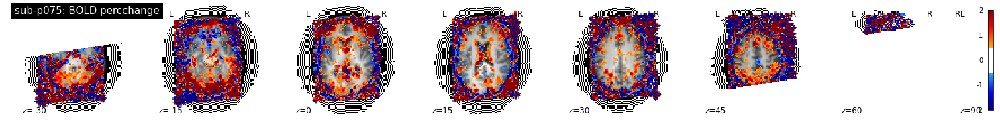

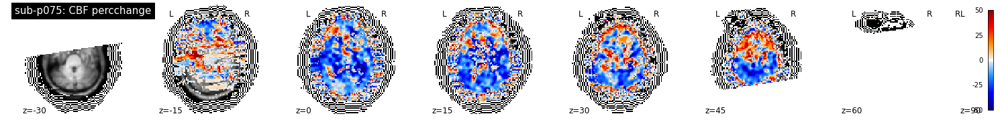

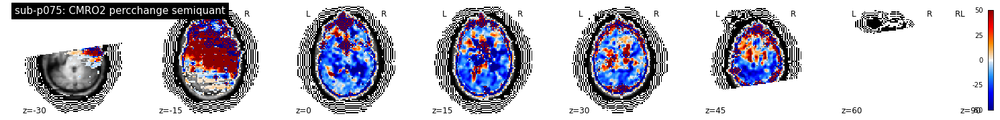

In [10]:
task='calc'
baseline='control'

for i, ID in enumerate(sids): #loop over subjects
    sub = "sub-p{:03d}".format(ID) # subject id, eg 'p021'
    subj_id = "p{:03d}".format(ID) # subject id, eg 'p021'
    print(sub)
    
    dir_deriv = os.path.join(data_dir, 'derivatives',  sub)
    dir_deriv_anat = os.path.join(data_dir, 'derivatives',  sub, 'anat')
    dir_deriv_func = os.path.join(data_dir, 'derivatives',  sub, 'func')
    dir_deriv_qmri = os.path.join(data_dir, 'derivatives',  sub, 'qmri')
    
    T1w_lowres = os.path.join(dir_deriv_anat,  sub + '_space-lowres_T1w.nii.gz')
    T1w_lowres_mask = os.path.join(dir_deriv_anat,   sub + '_space-lowres_T1w_mask.nii.gz')
    ! fslmaths {T1w_lowres} -thr {1} -bin {T1w_lowres_mask}
    #plot=plotting.plot_img(T1w_lowres_mask, bg_img=T1w_lowres, display_mode='z')     
        
    masker = input_data.NiftiMasker(mask_img=T1w_lowres_mask)


    #load percent signal change image
    BOLD_percchange_nii = os.path.join(dir_deriv_func, sub + '_task-'+task + baseline+'_space-lowres_BOLD_percchange.nii.gz')
    plot=plotting.plot_img(BOLD_percchange_nii, bg_img=T1w_lowres, display_mode='z', threshold=0.5, cmap=BlueRed, colorbar = True, black_bg=False,
                   cut_coords = coords, title= sub + ': BOLD percchange', vmin = -2, vmax = 2)     
    
    ## for CBF, create %change    
    CBF_task = masker.fit_transform(os.path.join(dir_deriv_qmri, sub + '_task-' + task + '_space-lowres_cbf.nii.gz' ))
    CBF_baseline = masker.fit_transform(os.path.join(dir_deriv_qmri, sub + '_task-' + baseline + '_space-lowres_cbf.nii.gz' ))
    CBF_percchange = (CBF_task - CBF_baseline) / CBF_baseline *100
    CBF_percchange[abs(CBF_percchange)>60] = 0
    ## create image of CMRO2 percchange per subject ()
    CBF_percchange_nii = masker.inverse_transform(CBF_percchange)
    plot=plotting.plot_img(CBF_percchange_nii, bg_img=T1w_lowres, display_mode='z', threshold=1, cmap=BlueRed, colorbar = True, black_bg=False,
                   cut_coords = coords, title= sub + ': CBF percchange', vmin = -50, vmax = 50)


    ## for CMR02, create %change
    ## baseline
    CMRO2_baseline = masker.fit_transform(os.path.join(dir_deriv_qmri, sub + '_task-' + baseline + '_space-lowres_cmro2.nii.gz'))
    

    CMRO2_task_quant =  masker.fit_transform(os.path.join(dir_deriv_qmri,sub + '_task-' + task + '_space-lowres_cmro2.nii.gz'))
                
    CMRO2_task_semiquant = masker.fit_transform(os.path.join(dir_deriv_qmri,sub + '_task-'+task+'_base-'+baseline+'_space-lowres_desc-semi-quant_cmro2.nii.gz'))
    
    CMRO2_percchange = (CMRO2_task_quant - CMRO2_baseline) / CMRO2_baseline *100
    CMRO2_percchange_seminquant = (CMRO2_task_semiquant - CMRO2_baseline) / CMRO2_baseline *100
    
    ## create image of CMRO2 percchange per subject ()
    CMRO2_percchange_nii = masker.inverse_transform(CMRO2_percchange)
    #plot=plotting.plot_img(CMRO2_percchange_nii, bg_img=T1w_lowres, display_mode='z', threshold=1, cmap=BlueRed, colorbar = True, black_bg=False,
    #               cut_coords = coords, title= sub + ': CMRO2 percchange quant', vmin = -50, vmax = 50)
    
    ## create image of CMRO2 percchange per subject ()
    CMRO2_percchange_nii = masker.inverse_transform(CMRO2_percchange_seminquant)
    plot=plotting.plot_img(CMRO2_percchange_nii, bg_img=T1w_lowres, display_mode='z', threshold=1, cmap=BlueRed, colorbar = True, black_bg=False,
                   cut_coords = coords, title= sub + ': CMRO2 percchange semiquant', vmin = -50, vmax = 50)


## normalization to MNI space

sub-p021
sub-r075
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r075
sub-p054
sub-r075
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r075
sub-p059
sub-r075
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r075
sub-p060
sub-r075
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r075
sub-p070
sub-r075
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r075
sub-p071
sub-r075
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r075
sub-p072
sub-r075
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r075
sub-p073
sub-r075
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r075
sub-p074
sub-r075
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r075
sub-p075
sub-r075
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r075


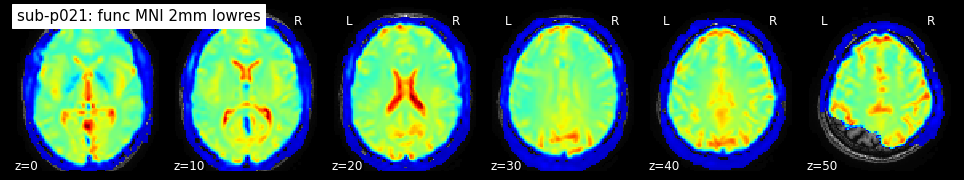

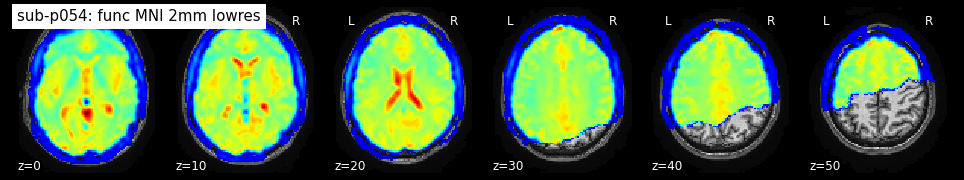

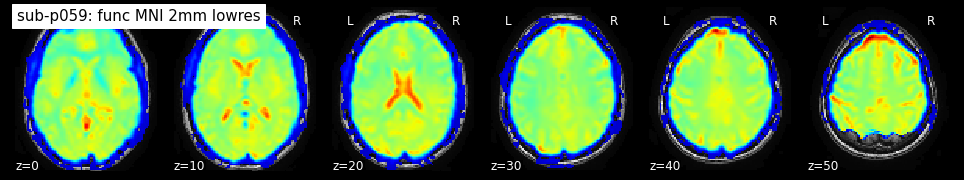

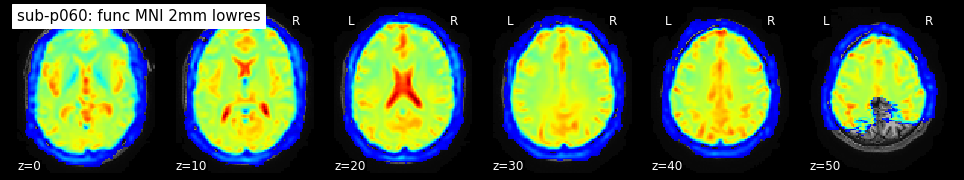

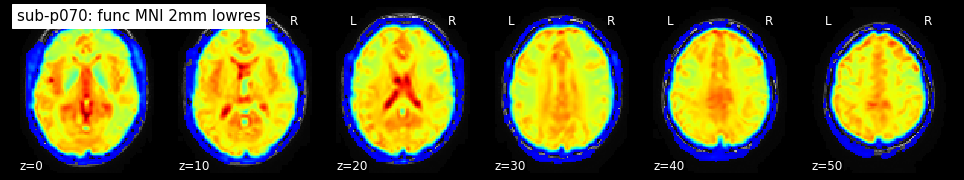

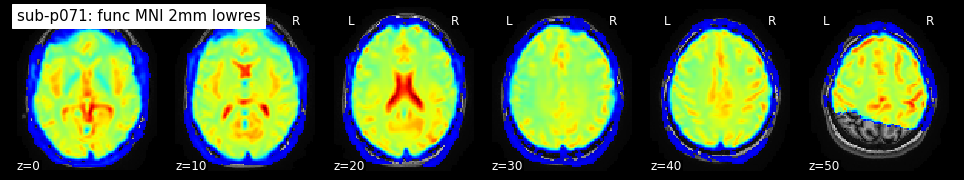

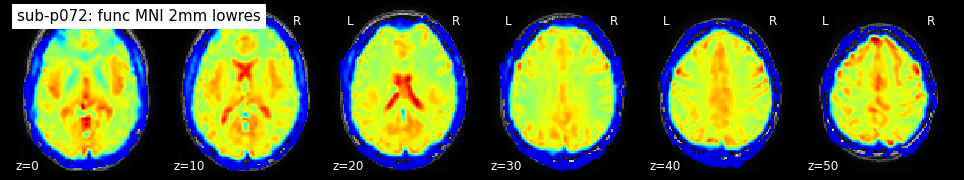

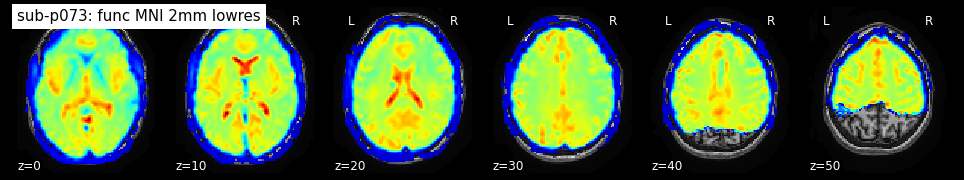

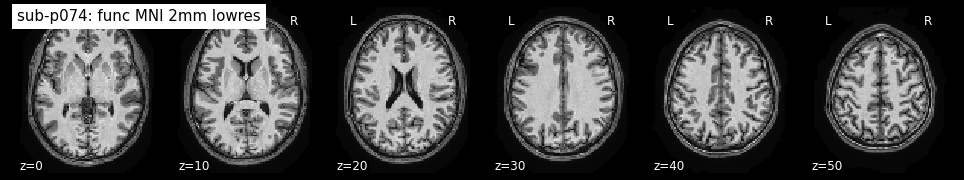

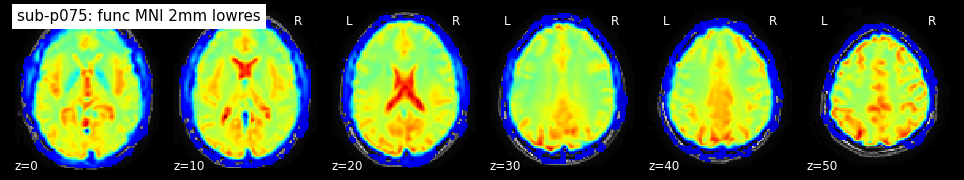

In [66]:

####################################
### func lowres to MNI #############
###################################
for ID in sids:
    sub = "sub-p{:03d}".format(ID) # subject id, eg 'p021'
    subj_id = "p{:03d}".format(ID) # subject id, eg 'p021'
    print(sub)
    
    dir_deriv = os.path.join(data_dir, 'derivatives',  sub)
    dir_deriv_anat = os.path.join(data_dir, 'derivatives',  sub, 'anat')
    dir_deriv_func = os.path.join(data_dir, 'derivatives',  sub, 'func')
    dir_deriv_qmri = os.path.join(data_dir, 'derivatives',  sub, 'qmri')
    
    T1w_lowres = os.path.join(dir_deriv_anat,  sub + '_space-lowres_T1w.nii.gz')
    T1w_lowres_brain = os.path.join(dir_deriv_anat,  sub + '_space-lowres_T1w_brain.nii.gz')
    T1w =  os.path.join(dir_deriv_anat,sub + '_desc-preproc_T1w.nii.gz')
    T1w_brain =  os.path.join(dir_deriv_anat,sub + '_desc-preproc_T1w_brain.nii.gz')
    transform_to_standard= os.path.join(dir_deriv_anat,  sub + '_from-T1w_to-MNI152NLin6Asym_mode-image_xfm.h5')
    T1w_MNIspace =  os.path.join(dir_deriv_anat,  sub + '_space-MNI152NLin6Asym_res-2_desc-preproc_T1w.nii.gz')
      
    func_lowres = os.path.join(dir_deriv_func,  sub + '_task-locmem_space-lowres_desc-preproc_bold.nii.gz')
    
    ! bet {T1w} {T1w_brain} -f 0.3
    
    ##output
    func_highres = os.path.join(dir_deriv_func,  sub + '_task-locmem_space-T1w_desc-preproc_bold.nii.gz')   
    out_MNI = os.path.join(dir_deriv_func,  sub + '_task-locmem_space-MNI152_desc-preproc_bold.nii.gz')
    func_lowres_to_highres = os.path.join(dir_deriv_func,  sub + '_func_lowres_to_highres_T1.mat')

      
    ! epi_reg --epi={func_lowres} --t1={T1w} --t1brain={T1w_brain} --out={func_highres}

    ##apply transformation (saved by fmriprep) from T1 to standard space
    ! antsApplyTransforms -d 3 -e 3 --float 1 --verbose 1 -i {func_highres} -r {T1w_MNIspace} -t {transform_to_standard} -o {out_MNI} 

    ## plot
    func_lowres_slice = image.index_img(out_MNI, 0) ## first volume
    plotting.plot_img(func_lowres_slice, bg_img = T1w_MNIspace, display_mode='z', cmap='jet', cut_coords = (0, 10, 20, 30, 40, 50), threshold = 5000, black_bg=True, title = sub + ': func MNI 2mm lowres')        
 

sub-p021
sub-r075
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r075
sub-p054
sub-r075
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r075
sub-p059
sub-r075
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r075
sub-p060
sub-r075
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r075
sub-p070
sub-r075
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r075
sub-p071
sub-r075
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r075
sub-p072
sub-r075
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r075
sub-p073
sub-r075
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r075
sub-p074
sub-r075
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r075
sub-p075
sub-r075
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r075
sub-p021
sub-r075
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r075
sub-p054
sub-r075
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r075
sub-

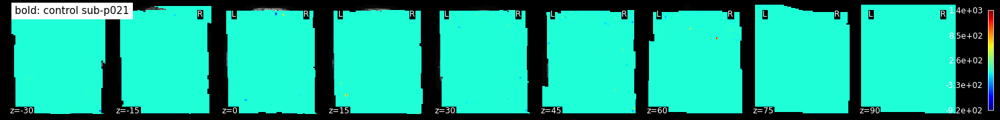

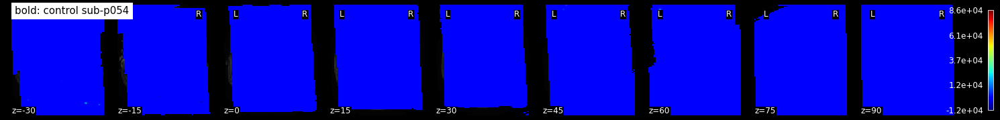

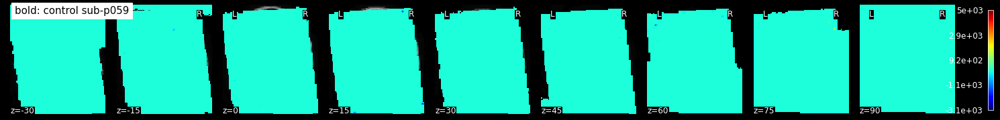

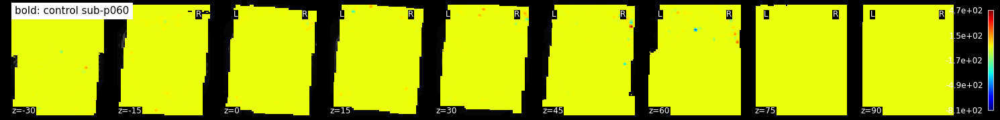

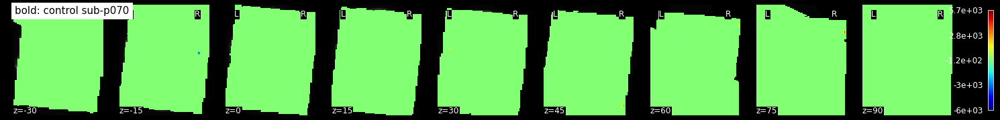

...

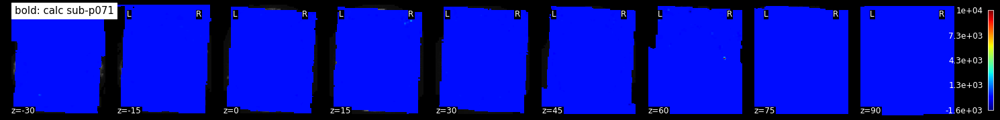

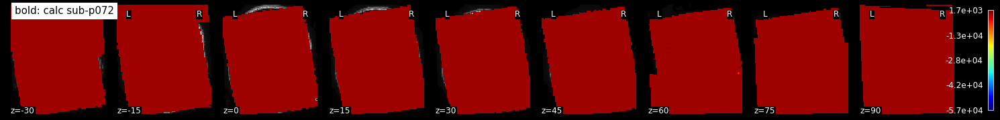

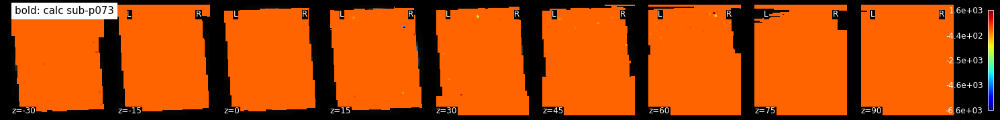

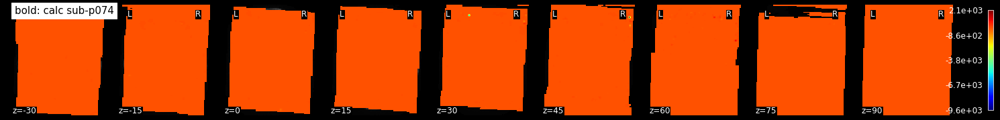

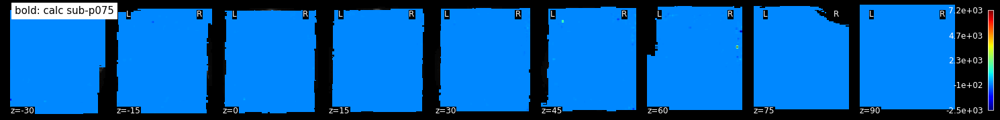

In [81]:
  
#### all parameter maps, original ###
#####################################

parameters = ['bold', 'cbf', 'cmro2', 'bold']
conds=['control', 'calc']
task='calc'
baseline='control'

for par in parameters:
    for ID in sids:
        sub = "sub-p{:03d}".format(ID) # subject id, eg 'p021'
        subj_id = "p{:03d}".format(ID) # subject id, eg 'p021'
        print(sub)

        dir_deriv = os.path.join(data_dir, 'derivatives',  sub)
        dir_deriv_anat = os.path.join(data_dir, 'derivatives',  sub, 'anat')
        dir_deriv_func = os.path.join(data_dir, 'derivatives',  sub, 'func')
        dir_deriv_qmri = os.path.join(data_dir, 'derivatives',  sub, 'qmri')
        
        T1w_lowres = os.path.join(dir_deriv_anat,  sub + '_space-lowres_T1w.nii.gz')    
        T1w =  os.path.join(dir_deriv_anat,sub + '_desc-preproc_T1w.nii.gz')
        T1w_brain =  os.path.join(dir_deriv_anat,sub + '_desc-preproc_T1w_brain.nii.gz')
        lowres_to_T1w = os.path.join(dir_deriv_anat,sub + '_lowres_to_T1w.mat')

        ! flirt -in {T1w_lowres} -ref {T1w_brain} -omat {lowres_to_T1w} -dof 6
        
        if par == 'bold': 
            out_T1w = os.path.join(dir_deriv_func, sub + '_task-'+task + baseline+'_space-T1w_BOLD_percchange.nii.gz')
            transform_to_standard=  os.path.join(dir_deriv_anat,  sub + '_from-T1w_to-MNI152NLin6Asym_mode-image_xfm.h5')
            T1w_MNIspace =  os.path.join(dir_deriv_anat,  sub + '_space-MNI152NLin6Asym_res-2_desc-preproc_T1w.nii.gz')
            out_MNI = os.path.join(dir_deriv_func, sub + '_task-'+task + baseline+'_space-MNI152_BOLD_percchange.nii.gz')
            par_lowres = os.path.join(dir_deriv_func, sub + '_task-'+task + baseline+'_space-lowres_BOLD_percchange.nii.gz')
           
            ##apply transformation from lowres T2 to highres T1 space for parameter maps
            ! flirt -in {par_lowres} -ref {T1w_brain} -applyxfm -init {lowres_to_T1w} -out {out_T1w}

            ##apply transformation (saved by fmriprep) from T1 to standard space
            ! antsApplyTransforms -d 3 --float 1 --verbose 1 -i {out_T1w} -r {T1w_MNIspace} -t {transform_to_standard} -o {out_MNI}
        
            plotting.plot_img(out_MNI, bg_img=T1w_MNIspace, cmap='jet',display_mode='z', colorbar=True, black_bg=True, threshold=0,
                       cut_coords=coords, title = par + ': '+ cond + ' ' + sub)
                
        if par !='bold':
            for cond in conds:
                out_T1w = os.path.join(dir_deriv_qmri, sub + '_task-'+cond+ '_space-T1w_'+par+'.nii.gz')
                transform_to_standard=  os.path.join(dir_deriv_anat,  sub + '_from-T1w_to-MNI152NLin6Asym_mode-image_xfm.h5')
                T1w_MNIspace =  os.path.join(dir_deriv_anat,  sub + '_space-MNI152NLin6Asym_res-2_desc-preproc_T1w.nii.gz')
                out_MNI = os.path.join(dir_deriv_qmri, sub + '_task-'+cond+ '_space-MNI152_'+par+'.nii.gz')
                par_lowres =  os.path.join(dir_deriv_qmri, sub + '_task-' + cond + '_space-lowres_'+par+'.nii.gz' )

                ##apply transformation from lowres T2 to highres T1 space for parameter maps
                ! flirt -in {par_lowres} -ref {T1w_brain} -applyxfm -init {lowres_to_T1w} -out {out_T1w}

                ##apply transformation (saved by fmriprep) from T1 to standard space
                ! antsApplyTransforms -d 3 --float 1 --verbose 1 -i {out_T1w} -r {T1w_MNIspace} -t {transform_to_standard} -o {out_MNI}

                plotting.plot_img(out_MNI, bg_img=T1w_MNIspace, cmap='jet',display_mode='z', colorbar=True, black_bg=True, threshold=20,
                           cut_coords=coords, title = par + ': '+ cond + ' ' + sub)
        

sub-p021
sub-r075
/RAID1/jupytertmp/github/erc-wp1/data_replication_study/sub-r075
Using single precision for computations.
Input scalar image: /home/tumnic/sepp/neuroenergeticslab_notebooks/erc-wp1/tmp/p021/mri2/qBOLD/sub-p021_task-calc_base-control_space-T1w_desc-semi-quant_oef.nii.gz
Reference image: /home/tumnic/sepp/neuroenergeticslab_notebooks/erc-wp1/tmp/p021/mri2/sub-p021/anat/sub-p021_space-MNI152NLin6Asym_res-2_desc-preproc_T1w.nii.gz
The composite transform comprises the following transforms (in order): 
  1. /home/tumnic/sepp/neuroenergeticslab_notebooks/erc-wp1/tmp/p021/mri2/sub-p021/anat/sub-p021_from-T1w_to-MNI152NLin6Asym_mode-image_xfm.h5[0] (type = AffineTransform)
  2. /home/tumnic/sepp/neuroenergeticslab_notebooks/erc-wp1/tmp/p021/mri2/sub-p021/anat/sub-p021_from-T1w_to-MNI152NLin6Asym_mode-image_xfm.h5[1] (type = DisplacementFieldTransform)
Default pixel value: 0
Interpolation type: LinearInterpolateImageFunction
Output warped image: /home/tumnic/sepp/neuroenergeti

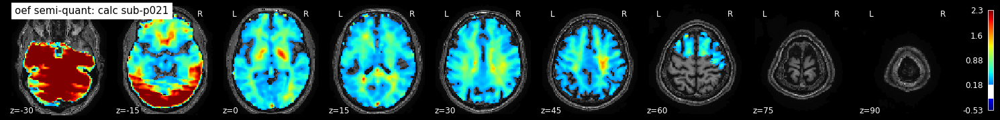

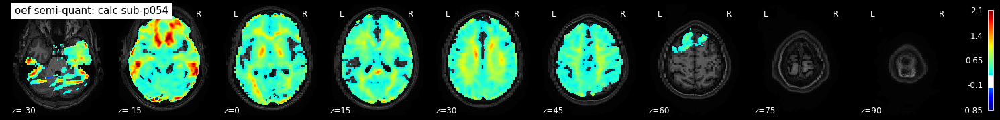

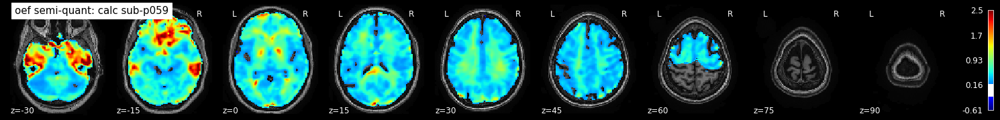

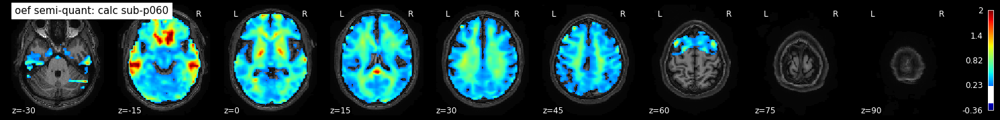

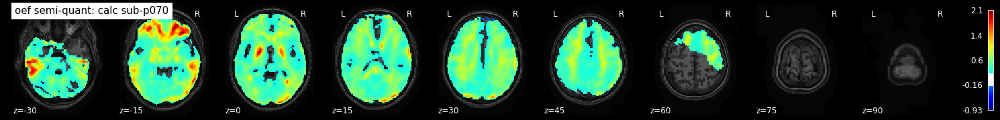

...

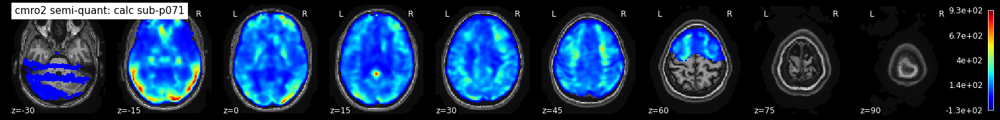

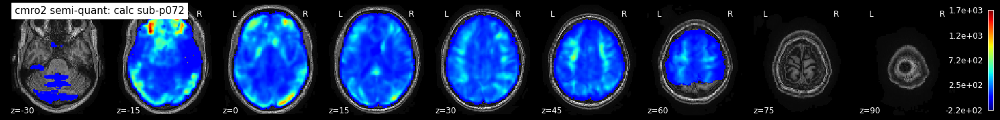

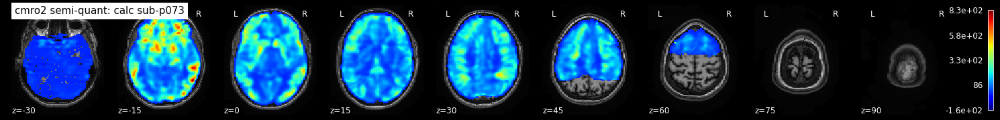

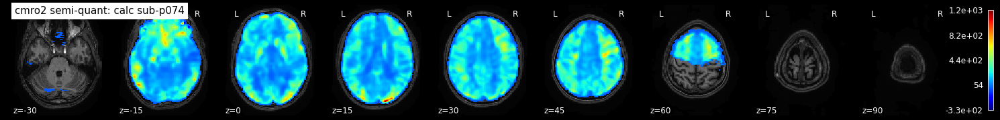

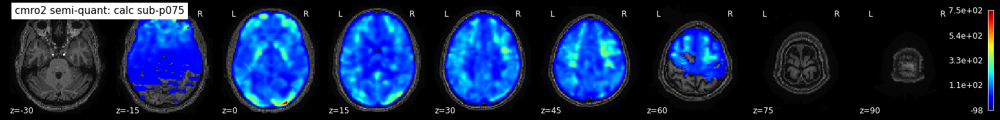

In [82]:
####################################
### CMRO2 & OEF semi-quant #############
###################################
parameters = ['oef', 'cmro2']

baseline='control'
conds=['calc']

for par in parameters:
    for ID in sids:
        sub = "sub-p{:03d}".format(ID) # subject id, eg 'p021'
        subj_id = "p{:03d}".format(ID) # subject id, eg 'p021'
        print(sub)

        dir_deriv = os.path.join(data_dir, 'derivatives',  sub)
        dir_deriv_anat = os.path.join(data_dir, 'derivatives',  sub, 'anat')
        dir_deriv_func = os.path.join(data_dir, 'derivatives',  sub, 'func')
        dir_deriv_qmri = os.path.join(data_dir, 'derivatives',  sub, 'qmri')
        
        T1w_lowres = os.path.join(dir_deriv_anat,  sub + '_space-lowres_T1w.nii.gz')          
        T1w =  os.path.join(dir_deriv_anat,sub + '_desc-preproc_T1w.nii.gz')
        T1w_brain =  os.path.join(dir_deriv_anat,sub + '_desc-preproc_T1w_brain.nii.gz')
        lowres_to_T1w = os.path.join(dir_deriv_anat,sub + '_lowres_to_T1w.mat')

        T1w_MNIspace = os.path.join(dir_deriv_anat,  sub + '_space-MNI152NLin6Asym_res-2_desc-preproc_T1w.nii.gz')
        transform_to_standard= os.path.join(dir_deriv_anat,  sub + '_from-T1w_to-MNI152NLin6Asym_mode-image_xfm.h5')
   
        for cond in conds:
            out_T1w = os.path.join(dir_deriv_qmri, sub + '_task-'+cond+'_base-'+baseline+'_space-T1w_desc-semi-quant_'+par+'.nii.gz')
            T1w_MNIspace = os.path.join(dir_deriv_anat,  sub + '_space-MNI152NLin6Asym_res-2_desc-preproc_T1w.nii.gz')
            out_MNI = os.path.join(dir_deriv_qmri, sub + '_task-'+cond+'_base-'+baseline+'_space-MNI152_desc-semi-quant_'+par+'.nii.gz')
            
            par_lowres = os.path.join(locfolder, 'qBOLD',  sub + '_task-'+cond+'_base-'+baseline+'_space-lowres_desc-semi-quant_'+par+'.nii.gz')

            ##apply transformation from lowres T2 to highres T1 space for parameter maps
            ! flirt -in {par_lowres} -ref {T1w_brain} -applyxfm -init {lowres_to_T1w} -out {out_T1w}

            #plotting.plot_img(out_T1w, bg_img=T1w_brain, cmap='jet',display_mode='z', colorbar=True, black_bg=True, threshold=0.2, vmax=350,
            #           cut_coords=coords, title = par + ' semi-quant: '+ cond + ' ' + sub)
            
            ##apply transformation (saved by fmriprep) from T1 to standard space
            ! antsApplyTransforms -d 3 --float 1 --verbose 1 -i {out_T1w} -r {T1w_MNIspace} -t {transform_to_standard} -o {out_MNI}
            
            plotting.plot_img(out_MNI, bg_img=T1w_MNIspace, cmap='jet',display_mode='z', colorbar=True, black_bg=True, threshold=0.2,
                       cut_coords=coords, title = par + ' semi-quant: '+ cond + ' ' + sub)


## PLS

In [71]:
import pyls # PLS: behavioral and mean-centered
baseline='control'
#baseline='rest'
#task='calc'
task='calc'
#task='mem'


conds = [baseline, task]
contrast=task+baseline
    
sids=[76, 77, 78, 79, 70, 71, 72, 73, 74, 75]

N_subj = str(len(sids))

################### Please specify if only GM mask or GM + CBV + R2' mask!! ######################################

whole_brain_masking = 'GMmask'
#whole_brain_masking = 'CBV_R2smask'

resolution = 'res-2'

MNI_2mm_brain = derivatives_dir + '/MNI152_T1_2mm_brain.nii.gz'

if whole_brain_masking == 'GMmask':
    whole_brain_mask = os.path.join( derivatives_dir, 'task-all_space-MNI152_res-2_SNR_YEO_group_mask.nii.gz')

    
masker = input_data.NiftiMasker(mask_img=whole_brain_mask)
mask_img = masker.fit_transform(MNI_2mm_brain)


### func PLS

In [15]:
## load MNI and apply mask to get right shape for PLS input

PLS_input_localizer_median=np.empty([len(sids)*len(conds), mask_img.shape[1]]) 

for i, ID in enumerate(sids): #loop over subjects
    sub = "sub-p{:03d}".format(ID) # subject id, eg 'p021'
    subj_id = "p{:03d}".format(ID) # subject id, eg 'p021'
    print(sub)
    
    dir_deriv = os.path.join(data_dir, 'derivatives',  sub)
    dir_deriv_anat = os.path.join(data_dir, 'derivatives',  sub, 'anat')
    dir_deriv_func = os.path.join(data_dir, 'derivatives',  sub, 'func')
    dir_deriv_qmri = os.path.join(data_dir, 'derivatives',  sub, 'qmri')

    localizer_normalized = os.path.join(dir_deriv_func,  sub + '_task-locmem_space-MNI152_desc-preproc_bold.nii.gz')
                                                                
    ## apply GM mask (with GM_thr defined)
    localizer_arr = masker.fit_transform(localizer_normalized)
    
    #############################################################
    ##create percent signal change values (baseline = median across time) ##
    #############################################################
 
    timeseries = [] #empty, to be sure to fill it with new values
    baseline_val = []  #empty, to be sure to fill it with new value

    timeseries = localizer_arr #shape: (400, 91406) or (200, 91406)
      
    # baseline = control                     
    if baseline == 'control':
        baseline_val = np.median(timeseries[list(range(80, 100)) + list(range(205, 225)) + list(range(280, 300)) + list(range(355, 375))])                                                     

    percBOLD_4cond= 100 * (timeseries - baseline_val) / baseline_val

    if baseline == 'control':
        percBOLD_baseline = np.median((percBOLD_4cond[list(range(80, 100)) + list(range(205, 225)) + list(range(280, 300)) + list(range(355, 375))]),0)

    if task == 'mem':
        percBOLD_task = np.median((percBOLD_4cond[list(range(30, 50)) + list(range(105, 125)) + list(range(180, 200)) + list(range(380, 400))]), 0)
    if task == 'calc':
        percBOLD_task = np.median((percBOLD_4cond[list(range(55, 75)) + list(range(155, 175)) + list(range(255, 275)) + list(range(305, 325))]), 0)

        
    ## put into PLS data structure ##
    PLS_input_localizer_median[i] = percBOLD_baseline
    PLS_input_localizer_median[i + len(sids)] = percBOLD_task

##save data structure
np.save(os.path.join(results_dir,  'N' + N_subj +'_PLS_func_median_lowres' + '_' + contrast+'_' + whole_brain_masking + '_input.npy'), PLS_input_localizer_median)
    

sub-p021


KeyboardInterrupt: 

###  parameter maps PLS

In [17]:
MNI_arr = masker.fit_transform(MNI_2mm_brain)

#pre-define PLS input: all voxels for every subject per condition
PLS_input_CBF=np.empty([len(sids)*len(conds), MNI_arr.shape[1]])
PLS_input_CMRO2=np.empty([len(sids)*len(conds), MNI_arr.shape[1]])

for i, ID in enumerate(sids): #loop over subjects

    sub = "sub-p{:03d}".format(ID) # subject id, eg 'p021'
    subj_id = "p{:03d}".format(ID) # subject id, eg 'p021'
    print(sub)
    dir_deriv = os.path.join(data_dir, 'derivatives',  sub)
    dir_deriv_anat = os.path.join(data_dir, 'derivatives',  sub, 'anat')
    dir_deriv_func = os.path.join(data_dir, 'derivatives',  sub, 'func')
    dir_deriv_qmri = os.path.join(data_dir, 'derivatives',  sub, 'qmri')

        
    for k, cond in enumerate(conds):        
        
        ## CBF ##
        #########
        
        CBF_normalized = os.path.join(dir_deriv_qmri, sub + '_task-' + cond + '_space-MNI152_cbf.nii.gz')
           
        #plotting.plot_img(CBF_normalized, bg_img=MNI, display_mode='z', threshold = 10, cmap='viridis', black_bg=True, 
        #              cut_coords = (-20, 0,  20,  40, 60, 80, 100), vmin = 10, vmax = 70, title = subj_id)
        
        ## apply GM mask (with GM_thr defined)
        CBF_arr = masker.fit_transform(CBF_normalized)
        PLS_input_CBF[k*len(sids)+i,:]=CBF_arr;

        ## CMRO2 ##
        ###########

        CMRO2_normalized = os.path.join(dir_deriv_qmri,  sub + '_task-' + cond + '_space-MNI152_cmro2.nii.gz')
            
        #plotting.plot_img(CMRO2_normalized, bg_img=MNI, display_mode='z', threshold = 10, cmap='viridis', black_bg=True, 
        #              cut_coords = (-20, 0,  20,  40, 60, 80, 100), vmin = 10, vmax = 70, title = subj_id)
        
        ## apply GM mask (with GM_thr defined)
        CMRO2_arr = masker.fit_transform(CMRO2_normalized)
        PLS_input_CMRO2[k*len(sids)+i,:]=CMRO2_arr;
    
        
np.save(results_dir + '/N' + N_subj +'_PLS_input_CBF_'+resolution+'_' + contrast +'_' + whole_brain_masking +  '.npy', PLS_input_CBF)
np.save(results_dir + '/N' + N_subj +'_PLS_input_CMRO2_'+resolution+'_' + contrast +'_' + whole_brain_masking +  '.npy', PLS_input_CMRO2)



sub-p021
sub-p054
sub-p059
sub-p060
sub-p070
sub-p071
sub-p072
sub-p073
sub-p074
sub-p075


## Run PLS

In [72]:
## functional data 
PLS_input_func_median= np.load(os.path.join(results_dir,  'N' + N_subj +'_PLS_func_median_lowres' + '_' + contrast+'_' + whole_brain_masking + '_input.npy'))

mpls_func_median = pyls.meancentered_pls(PLS_input_func_median, n_cond=len(conds), n_perm=2000, n_boot=2000)
np.save(os.path.join(results_dir,  'N' + N_subj +'_PLS_func_median_lowres' + '_'+contrast+'_' + whole_brain_masking + '.npy'), mpls_func_median)


Running permutations:  32%|###2      | 648/2000 | 00:27<01:20
KeyboardInterrupt



In [ ]:
## CBF and CMRO2
## CBFc
PLS_input_CBF= np.load(os.path.join(results_dir + '/N' + N_subj +'_PLS_input_CBF_'+resolution+'_' + contrast+'_' + whole_brain_masking +  '.npy'))
mpls_CBF = pyls.meancentered_pls(PLS_input_CBF, n_cond=len(conds), n_perm=2000, n_boot=2000)
np.save(os.path.join(results_dir,  'N' + N_subj +'_PLS_cbf_median_lowres'+'_'+contrast+'_' + whole_brain_masking + '.npy'), mpls_CBF)


##CMRO2
PLS_input_CMRO2= np.load(os.path.join(results_dir + '/N' + N_subj +'_PLS_input_CMRO2_'+resolution+'_' + contrast +'_' + whole_brain_masking +  '.npy'))

mpls_CMRO2 = pyls.meancentered_pls(PLS_input_CMRO2, n_cond=len(conds), n_perm=2000, n_boot=2000)
np.save(os.path.join(results_dir,  'N' + N_subj +'_PLS_cmro2_median_lowres'+'_'+contrast+'_' + whole_brain_masking + '.npy'), mpls_CMRO2)


## PLS results

In [74]:
mpls_func = np.load(os.path.join(results_dir,  'N' + N_subj +'_PLS_func_median_lowres' + '_'+contrast+'_' + whole_brain_masking + '.npy'), allow_pickle='TRUE').item()
print('p-values of func PLS: ' + str(mpls_func.permres.pvals))
brain_scores_func= [mpls_func.x_scores[i, 0] for i in range(0,len(mpls_func.x_scores))]## first latent variables (significant)
bootstrap_results_1st_func = [mpls_func.bootres.x_weights_normed[i, 0] for i in range(0, len(mpls_func.bootres.x_weights_normed))] # for first latent variable

p-values of func PLS: [4.99750125e-04 7.52123938e-01]


Running permutations:  32%|###2      | 648/2000 | 00:39<01:20

In [75]:
## design scores
plt.rc('font', size=12) #controls default text size

design_scores_BOLD = [mpls_func.y_scores[i, 0] for i in range(0,len(mpls_func.y_scores))]## first latent variables (significant)

design_scores_df_BOLD = pd.DataFrame(columns = [1], index=conds) 
design_scores_df_BOLD.index.name = 'conditions'

design_scores_df_BOLD.loc[baseline] = design_scores_BOLD[len(sids)-1]
design_scores_df_BOLD.loc[task] = design_scores_BOLD[2*len(sids)-1]

In [76]:
mpls_cbf = np.load(os.path.join(results_dir,  'N' + N_subj +'_PLS_cbf_median_lowres'+ '_'+contrast+'_' + whole_brain_masking + '.npy'), allow_pickle='TRUE').item()
mpls_cmro2 = np.load(os.path.join(results_dir,  'N' + N_subj +'_PLS_cmro2_median_lowres'+ '_'+contrast+'_' + whole_brain_masking + '.npy'), allow_pickle='TRUE').item()

print('p-values of CBF PLS: ' + str(mpls_cbf.permres.pvals))
print('p-values of CMRO2 PLS: ' + str(mpls_cmro2.permres.pvals))
brain_scores_cbf = [mpls_cbf.x_scores[i, 0] for i in range(0,len(mpls_cbf.x_scores))]## first latent variables (significant)
brain_scores_cmro2 = [mpls_cmro2.x_scores[i, 0] for i in range(0,len(mpls_cmro2.x_scores))]## first latent variables (significant)

bootstrap_results_1st_CBF = [mpls_cbf.bootres.x_weights_normed[i, 0] for i in range(0, len(mpls_cbf.bootres.x_weights_normed))] # for first latent variable
bootstrap_results_1st_CMRO2 = [mpls_cmro2.bootres.x_weights_normed[i, 0] for i in range(0, len(mpls_cmro2.bootres.x_weights_normed))] # for first latent variable


p-values of CBF PLS: [0.02548726 0.99150425]
p-values of CMRO2 PLS: [0.05397301 0.29385307]


In [77]:
plt.rc('font', size=12) #controls default text size


design_scores_CBF = [mpls_cbf.y_scores[i, 0] for i in range(0,len(mpls_cbf.y_scores))]## first latent variables (significant)

design_scores_df_CBF = pd.DataFrame(columns = [1], index=conds) 
design_scores_df_CBF.index.name = 'conditions'


design_scores_df_CBF.loc[baseline] = design_scores_CBF[len(sids)-1]
design_scores_df_CBF.loc[task] = design_scores_CBF[2*len(sids)-1]
    
    ## plot ##
    

design_scores_CMRO2 = [mpls_cmro2.y_scores[i, 0] for i in range(0,len(mpls_cmro2.y_scores))]## first latent variables (significant)
design_scores_df_CMRO2 = pd.DataFrame(columns = [1], index=conds) 
design_scores_df_CMRO2.index.name = 'conditions'


    ## 2 conditions
design_scores_df_CMRO2.loc[baseline] = design_scores_CMRO2[len(sids)-1]
design_scores_df_CMRO2.loc[task] = design_scores_CMRO2[2*len(sids)-1]



## plot BSR

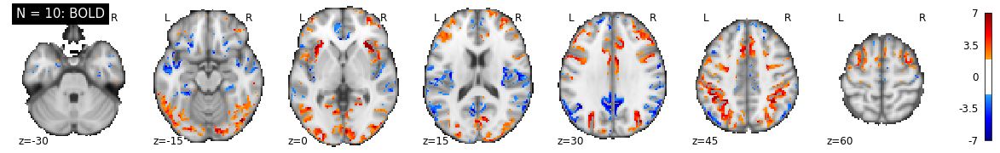

In [20]:
## create BSR images for all modalities, masked 
BSR_thr = 2
#coords=(-30, -20, -10, 0, 10, 20, 30, 40, 50, 60, 70)
coords = (-30, -15, 0, 15, 30, 45, 60)
colors = BlueRed
colors_r = BlueRed_r
maxval = 7
minval = -7

YEO17_2mm = os.path.join(derivatives_dir,'Yeo2011_17Networks_MNI152_FreeSurferConformed2mm_LiberalMask_MNI.nii.gz')

##BOLD
BSR_masked_func = masker.inverse_transform(bootstrap_results_1st_func)
nib.save(BSR_masked_func, os.path.join(results_dir, 'N' + N_subj +'_BSR_meanPLS_func_' + resolution+'_' + contrast + '_' + whole_brain_masking + '.nii.gz'))
BSR_masked_func=   os.path.join(results_dir, 'N' + N_subj +'_BSR_meanPLS_func_' + resolution+'_' + contrast +'_' + whole_brain_masking + '.nii.gz')
BSR_masked_BOLD_YEO =  os.path.join(results_dir, 'N' + N_subj +'_BSR_meanPLS_func_' + resolution+'_' + contrast +'_' + whole_brain_masking + '_YEOmask.nii.gz')


## mask with YEO regions to kick out cerebellum etc
! fslmaths {BSR_masked_func} -mas {YEO17_2mm} {BSR_masked_BOLD_YEO}
    
##BOLD
if design_scores_df_BOLD.loc[task][1] > 0: #higher in calc
    my_color = colors
else:
    my_color = colors_r
plot=plotting.plot_img(BSR_masked_BOLD_YEO, bg_img=MNI_2mm_brain, display_mode='z', threshold=BSR_thr, cmap=my_color, colorbar = True, black_bg=False,
                    cut_coords = coords, title='N = ' + N_subj + ': BOLD', vmin = minval, vmax = maxval)


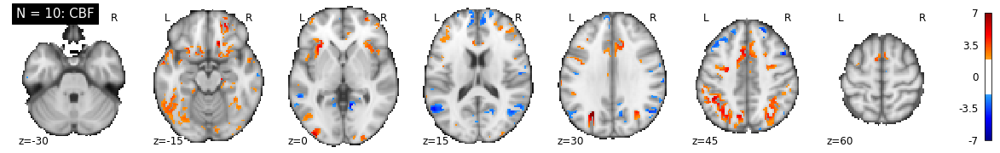

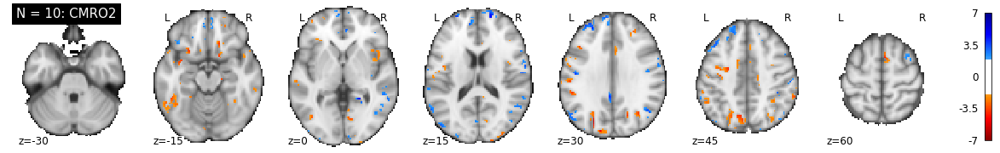

In [21]:

##CBF
BSR_masked_CBF = masker.inverse_transform(bootstrap_results_1st_CBF)
nib.save(BSR_masked_CBF, os.path.join(results_dir, 'N' + N_subj +'_BSR_meanPLS_cbf_' + resolution+'_' + contrast + '_' + whole_brain_masking +'.nii.gz'))
BSR_masked_CBF=  os.path.join(results_dir, 'N' + N_subj +'_BSR_meanPLS_cbf_' + resolution+'_' + contrast +'_' + whole_brain_masking + '.nii.gz')
BSR_masked_CBF_YEO =  os.path.join(results_dir, 'N' + N_subj +'_BSR_meanPLS_cbf_' + resolution+'_' + contrast +'_' + whole_brain_masking + '_YEOmask.nii.gz')

## mask with YEO regions to kick out cerebellum etc
! fslmaths {BSR_masked_CBF} -mas {YEO17_2mm} {BSR_masked_CBF_YEO}


##CMRO2
BSR_masked_CMRO2 = masker.inverse_transform(bootstrap_results_1st_CMRO2)
nib.save(BSR_masked_CMRO2,  os.path.join(results_dir, 'N' + N_subj +'_BSR_meanPLS_cmro2_' + resolution+'_' + contrast + '_' + whole_brain_masking +'.nii.gz'))
BSR_masked_CMRO2=  os.path.join(results_dir, 'N' + N_subj +'_BSR_meanPLS_cmro2_' + resolution+'_' + contrast + '_' + whole_brain_masking +'.nii.gz')
BSR_masked_CMRO2_YEO =   os.path.join(results_dir, 'N' + N_subj +'_BSR_meanPLS_cmro2_' + resolution+'_' + contrast + '_' + whole_brain_masking +'_YEOmask.nii.gz')

## mask with YEO regions to kick out cerebellum etc
! fslmaths {BSR_masked_CMRO2} -mas {YEO17_2mm} {BSR_masked_CMRO2_YEO}





##CBF
if design_scores_df_CBF.loc[task][1] > 0:
    my_color = colors
else:
    my_color =colors_r
plot=plotting.plot_img(BSR_masked_CBF_YEO, bg_img=MNI_2mm_brain, display_mode='z', threshold=BSR_thr, cmap=my_color, colorbar = True, black_bg=False,
                    cut_coords = coords, title='N = ' + N_subj + ': CBF', vmin = minval, vmax = maxval)

##CMRO2
if design_scores_df_CMRO2.loc[task][1] > 0:
        my_color = colors
else:
        my_color = colors_r
plot=plotting.plot_img(BSR_masked_CMRO2_YEO, bg_img=MNI_2mm_brain, display_mode='z', threshold=BSR_thr, cmap=my_color, colorbar = True, black_bg=False,
                    cut_coords = coords, title='N = ' + N_subj + ': CMRO2', vmin = minval, vmax = maxval)


## cluster-threshold  maps

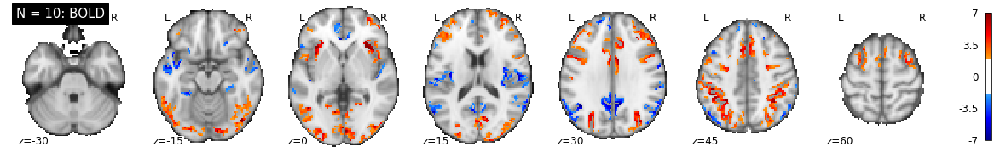

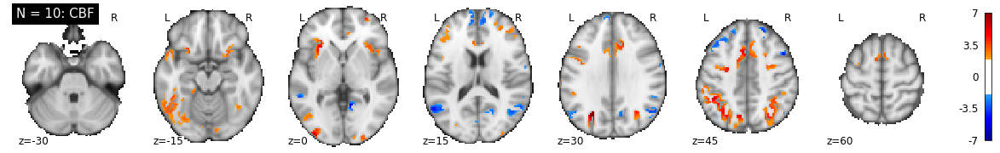

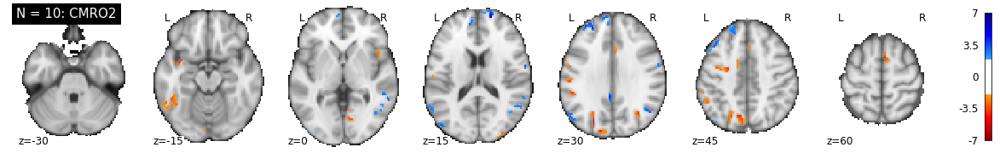

In [22]:
## apply cluster threshold
from nilearn import glm
from matplotlib.colors import ListedColormap

cl_threshold = 30

## create binary colormap
newcmp_pos = ListedColormap(["darkorange"])
newcmp_neg = ListedColormap(["dodgerblue"])


    ############
    ## BOLD ##
    ###########
BSR_cluster_thr = glm.threshold_stats_img(BSR_masked_BOLD_YEO, mask_img=None, alpha=0.05, threshold=BSR_thr, height_control=None, cluster_threshold=cl_threshold, two_sided=True)
nib.save(BSR_cluster_thr[0],results_dir + '/N' + N_subj +'_BSR_meanPLS_func_clusterBSR_' + resolution+'_' +contrast+'_' + whole_brain_masking +'.nii.gz')
BSR_cluster_thr_nii = results_dir + '/N' + N_subj +'_BSR_meanPLS_func_clusterBSR_' + resolution+'_' +contrast+'_' + whole_brain_masking +'.nii.gz'
##BOLD
if design_scores_df_BOLD.loc[task][1] > 0: #higher in calc
        my_color = colors
else:
        my_color = colors_r
plot=plotting.plot_img(BSR_cluster_thr_nii, bg_img=MNI_2mm_brain, display_mode='z', threshold=BSR_thr, cmap=my_color, colorbar = True, black_bg=False,
                    cut_coords = coords, title='N = ' + N_subj + ': BOLD', vmin = minval, vmax = maxval)
plot=plotting.plot_img(BSR_cluster_thr_nii, bg_img=MNI_2mm_brain, display_mode='z', threshold=BSR_thr, cmap=my_color, colorbar = True, black_bg=False,
                    cut_coords = coords, title='N = ' + N_subj + ': BOLD', vmin = minval, vmax = maxval, output_file=results_dir + '/N'+N_subj + '_func_PLS_BSR_clusterthresholded.pdf')



    ############
    ## CBF ##
    #############
BSR_cluster_thr = glm.threshold_stats_img(BSR_masked_CBF_YEO, mask_img=None, alpha=0.05, threshold=BSR_thr, height_control=None, cluster_threshold=cl_threshold, two_sided=True)
nib.save(BSR_cluster_thr[0],results_dir + '/N' + N_subj +'_BSR_meanPLS_cbf_clusterBSR'+ resolution+'_' +contrast+'_' + whole_brain_masking +'.nii.gz')
BSR_cluster_thr_nii = results_dir + '/N' + N_subj +'_BSR_meanPLS_cbf_clusterBSR'+ resolution+'_' +contrast+'_' + whole_brain_masking +'.nii.gz'

##CBF
if design_scores_df_CBF.loc[task][1] > 0:
        my_color = colors
else:
        my_color =colors_r
plot=plotting.plot_img(BSR_cluster_thr_nii, bg_img=MNI_2mm_brain, display_mode='z', threshold=BSR_thr, cmap=my_color, colorbar = True, black_bg=False,
                    cut_coords = coords, title='N = ' + N_subj + ': CBF', vmin = minval, vmax = maxval)
plot=plotting.plot_img(BSR_cluster_thr_nii, bg_img=MNI_2mm_brain, display_mode='z', threshold=BSR_thr, cmap=my_color, colorbar = True, black_bg=False,
                    cut_coords = coords, title='N = ' + N_subj + ': CBF', vmin = minval, vmax = maxval, output_file=results_dir + '/N'+N_subj + '_cbf_PLS_BSR_clusterthresholded.pdf')



    ############
    ## CMRO2 ##
    #############
    ## CMRO2 CALC is CBV-corrected

BSR_cluster_thr = glm.threshold_stats_img(BSR_masked_CMRO2_YEO, mask_img=None, alpha=0.05, threshold=BSR_thr, height_control=None, cluster_threshold=cl_threshold, two_sided=True)
nib.save(BSR_cluster_thr[0],results_dir + '/N' + N_subj +'_BSR_meanPLS_cmro2_clusterBSR'+ resolution+'_' +contrast +'_' + whole_brain_masking +'.nii.gz')
BSR_cluster_thr_nii = results_dir + '/N' + N_subj +'_BSR_meanPLS_cmro2_clusterBSR'+ resolution+'_' +contrast+'_' + whole_brain_masking +'.nii.gz'
    
    ##CMRO2
if design_scores_df_CMRO2.loc[task][1] > 0:
        my_color = colors
else:
        my_color = colors_r
plot=plotting.plot_img(BSR_cluster_thr_nii, bg_img=MNI_2mm_brain, display_mode='z', threshold=BSR_thr, cmap=my_color, colorbar = True, black_bg=False,
                    cut_coords = coords, title='N = ' + N_subj + ': CMRO2', vmin = minval, vmax = maxval)
plot=plotting.plot_img(BSR_cluster_thr_nii, bg_img=MNI_2mm_brain, display_mode='z', threshold=BSR_thr, cmap=my_color, colorbar = True, black_bg=False,
                    cut_coords = coords, title='N = ' + N_subj + ': CMRO2', vmin = minval, vmax = maxval, output_file=results_dir + '/N'+N_subj + '_cmro2_PLS_BSR_clusterthresholded.pdf')


### create BOLD mask

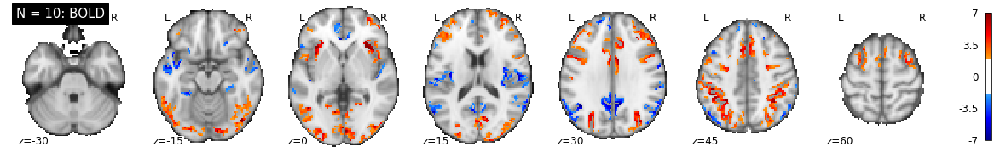

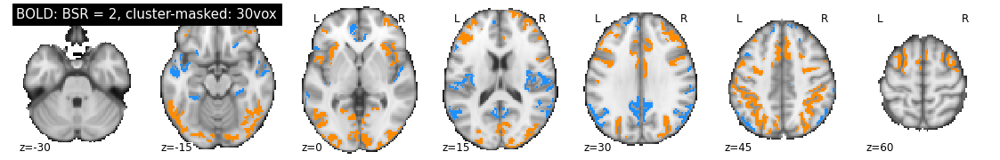

In [23]:
## apply cluster threshold
from nilearn import glm
from matplotlib.colors import ListedColormap

cl_threshold = 30
BSR_thr = 2

## create binary colormap
newcmp_pos = ListedColormap(["darkorange"])
newcmp_neg = ListedColormap(["dodgerblue"])


    ############
    ## BOLD ##
    ###########
BSR_cluster_thr = glm.threshold_stats_img(BSR_masked_BOLD_YEO, mask_img=None, alpha=0.05, threshold=BSR_thr, height_control=None, cluster_threshold=cl_threshold, two_sided=True)
nib.save(BSR_cluster_thr[0],results_dir + '/N' + N_subj +'_BSR_meanPLS_func_clusterBSR_' + resolution+'_' +contrast+'_' + whole_brain_masking +'.nii.gz')
BSR_cluster_thr_nii = results_dir + '/N' + N_subj +'_BSR_meanPLS_func_clusterBSR_' + resolution+'_' +contrast+'_' + whole_brain_masking +'.nii.gz'
##BOLD
if design_scores_df_BOLD.loc[task][1] > 0: #higher in calc
        my_color = colors
else:
        my_color = colors_r
plot=plotting.plot_img(BSR_cluster_thr_nii, bg_img=MNI_2mm_brain, display_mode='z', threshold=BSR_thr, cmap=my_color, colorbar = True, black_bg=False,
                    cut_coords = coords, title='N = ' + N_subj + ': BOLD', vmin = minval, vmax = maxval)
    
## separate into positive and negative clusters
if design_scores_df_BOLD.loc[task][1] > 0: #if task = orange
        ! fslmaths {BSR_cluster_thr_nii} -thr {BSR_thr} {BSR_cluster_thr_nii}_pos
        ! fslmaths {BSR_cluster_thr_nii} -uthr {-BSR_thr} {BSR_cluster_thr_nii}_neg
if design_scores_df_BOLD.loc[task][1] < 0: #if task = orange
        ! fslmaths {BSR_cluster_thr_nii} -thr {BSR_thr} {BSR_cluster_thr_nii}_neg
        ! fslmaths {BSR_cluster_thr_nii} -uthr {-BSR_thr} {BSR_cluster_thr_nii}_pos     
 
## binarize and save
neg_nii = results_dir + '/N' + N_subj +'_BSR_meanPLS_func_clusterBSR_' + resolution+'_' +contrast+'_' + whole_brain_masking +'.nii.gz_neg.nii.gz'
pos_nii = results_dir + '/N' + N_subj +'_BSR_meanPLS_func_clusterBSR_' + resolution+'_' +contrast+'_' + whole_brain_masking +'.nii.gz_pos.nii.gz'
neg_nii_bin = results_dir + '/N' + N_subj +'_BSR_meanPLS_func_clusterBSR_'+ resolution+'_'  +contrast+'_' + whole_brain_masking +'_neg_bin.nii.gz'
pos_nii_bin = results_dir + '/N' + N_subj +'_BSR_meanPLS_func_clusterBSR_' + resolution+'_' +contrast+'_' + whole_brain_masking +'_pos_bin.nii.gz'
! fslmaths {neg_nii} -abs -bin {neg_nii_bin}
! fslmaths {pos_nii} -abs -bin {pos_nii_bin}


##plot binarized
display = plotting.plot_img(BSR_cluster_thr_nii + '_pos.nii.gz', bg_img=MNI_2mm_brain, threshold = 0, display_mode='z', cmap=newcmp_pos, 
                    cut_coords = coords, title='BOLD: BSR = ' + str(BSR_thr) + ', cluster-masked: 30vox')
display.add_overlay(BSR_cluster_thr_nii + '_neg.nii.gz',cmap=newcmp_neg)


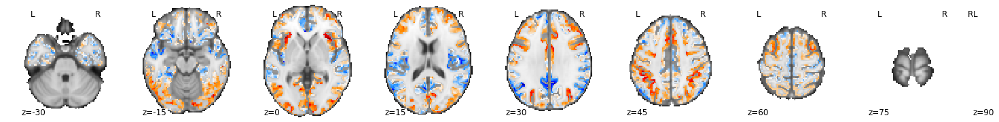

In [105]:
## BOLD
from nilearn import datasets
from nilearn import surface 
from nilearn.surface import load_surf_mesh
from matplotlib import colors as clr

colormap=BlueRed_r


fsaverage = datasets.fetch_surf_fsaverage()

maxval = 1
newcmp = ListedColormap([ "dodgerblue", "darkorange"])
newcmp_surface_r = ListedColormap(["dodgerblue","lightgrey", "lightgrey", "darkorange"])
newcmp_surface = ListedColormap(["darkorange","lightgrey", "lightgrey", "dodgerblue"])


maxval = 6
if design_scores_df_BOLD.loc[task][1] > 0:
    newcmp = BlueRed
    newcmp_surface = BlueRed
else:
    newcmp =BlueRed_r
    newcmp_surface = BlueRed_r


#BSR_cluster_thr_nii = results_dir + '/N' + N_subj +'_BSR_meanPLS_func_clusterBSR_' + resolution+'_' +contrast+'_' + whole_brain_masking +'.nii.gz'
BSR_cluster_thr_nii = os.path.join(results_dir, 'N' + N_subj +'_BSR_meanPLS_func_' + resolution+'_' + contrast +'_' + whole_brain_masking + '_YEOmask.nii.gz')


plot = plotting.plot_img(BSR_cluster_thr_nii, bg_img=MNI_2mm_brain,  threshold=0, display_mode='z', cmap=newcmp, 
                    cut_coords = coords)

texture_left = surface.vol_to_surf(BSR_cluster_thr_nii, fsaverage['pial_left'])
texture_right = surface.vol_to_surf(BSR_cluster_thr_nii, fsaverage['pial_right'])

fig, ax = plt.subplots(figsize=(10, 10), ncols=2, subplot_kw={"projection": "3d"})
plot = plotting.plot_surf_stat_map(fsaverage.infl_left, texture_left,
                           hemi='left', view='medial',colorbar=False,
                            bg_map=fsaverage['sulc_left'], bg_on_data=True,
                           darkness=.3,  vmax=maxval, threshold=0, 
                            cmap=newcmp_surface, axes=ax[0])
                                 
plotting.plot_surf_stat_map(fsaverage.infl_right, texture_right,
                           hemi='right', view='medial',colorbar=False,
                            bg_map=fsaverage['sulc_right'], bg_on_data=True,
                           darkness=.3, vmax=maxval, threshold=0,
                            cmap=newcmp_surface, axes=ax[1],
                           output_file=results_dir + '/N' + N_subj +'_BSR_meanPLS_BOLD_binary_' + resolution+'_' +contrast+'_' + whole_brain_masking +'_right.pdf')
plt.tight_layout()

fig, ax = plt.subplots(figsize=(10, 10), ncols=2, subplot_kw={"projection": "3d"})
plotting.plot_surf_stat_map(fsaverage.infl_left, texture_left,
                           hemi='left', view='lateral', colorbar=False,
                           bg_map=fsaverage['sulc_left'], bg_on_data=True,
                           darkness=.3,  vmax=maxval, threshold=0,
                            cmap=newcmp_surface, axes=ax[0])
plotting.plot_surf_stat_map(fsaverage.infl_right, texture_right,
                           hemi='right', view='lateral',colorbar=False,
                            bg_map=fsaverage['sulc_right'], bg_on_data=True,
                           darkness=.3,  vmax=maxval, threshold=0,
                            cmap=newcmp_surface, axes=ax[1],
                            output_file=results_dir + '/N' + N_subj +'_BSR_meanPLS_BOLD_binary_' + resolution+'_' +contrast+'_' + whole_brain_masking + '_left.pdf', dpi=300)

plt.tight_layout()

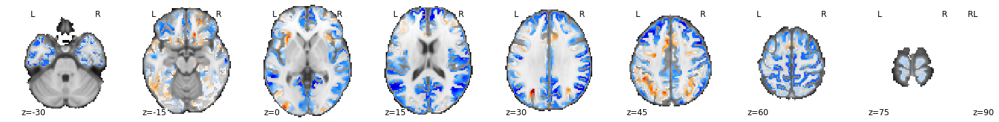

In [106]:
### CBF  as surface plot
from nilearn import datasets
from nilearn import surface 
from nilearn.surface import load_surf_mesh
from matplotlib import colors as clr


BSR_cluster_thr_nii =  os.path.join(results_dir, 'N' + N_subj +'_BSR_meanPLS_cbf_' + resolution+'_' + contrast +'_' + whole_brain_masking + '_YEOmask.nii.gz')
maxval = 6
if design_scores_df_CBF.loc[task][1] > 0:
    newcmp = BlueRed
    newcmp_surface = BlueRed
else:
    newcmp =BlueRed_r
    newcmp_surface = BlueRed_r

fsaverage = datasets.fetch_surf_fsaverage()


plot = plotting.plot_img(BSR_cluster_thr_nii, bg_img=MNI_2mm_brain,  threshold=0, display_mode='z', cmap=newcmp, 
                    cut_coords = coords)

texture_left = surface.vol_to_surf(BSR_cluster_thr_nii, fsaverage['pial_left'])
texture_right = surface.vol_to_surf(BSR_cluster_thr_nii, fsaverage['pial_right'])

fig, ax = plt.subplots(figsize=(10, 10), ncols=2, subplot_kw={"projection": "3d"})
plot = plotting.plot_surf_stat_map(fsaverage.infl_left, texture_left,
                           hemi='left', view='medial',colorbar=False,
                            bg_map=fsaverage['sulc_left'], bg_on_data=True,
                           darkness=.3,  vmax=maxval, threshold=0, 
                            cmap=newcmp_surface, axes=ax[0])
                                 
plotting.plot_surf_stat_map(fsaverage.infl_right, texture_right,
                           hemi='right', view='medial',colorbar=False,
                            bg_map=fsaverage['sulc_right'], bg_on_data=True,
                           darkness=.3, vmax=maxval, threshold=0,
                            cmap=newcmp_surface, axes=ax[1],
                           output_file=results_dir + '/N' + N_subj +'_BSR_meanPLS_CBF_' + resolution+'_' +contrast+'_' + whole_brain_masking +'_right.pdf')
plt.tight_layout()

fig, ax = plt.subplots(figsize=(10, 10), ncols=2, subplot_kw={"projection": "3d"})
plotting.plot_surf_stat_map(fsaverage.infl_left, texture_left,
                           hemi='left', view='lateral', colorbar=False,
                           bg_map=fsaverage['sulc_left'], bg_on_data=True,
                           darkness=.3,  vmax=maxval, threshold=0,
                            cmap=newcmp_surface, axes=ax[0])
plotting.plot_surf_stat_map(fsaverage.infl_right, texture_right,
                           hemi='right', view='lateral',colorbar=False,
                            bg_map=fsaverage['sulc_right'], bg_on_data=True,
                           darkness=.3,  vmax=maxval, threshold=0,
                            cmap=newcmp_surface, axes=ax[1],
                            output_file=results_dir + '/N' + N_subj +'_BSR_meanPLS_CBF_' + resolution+'_' +contrast+'_' + whole_brain_masking + '_left.pdf', dpi=300)

plt.tight_layout()

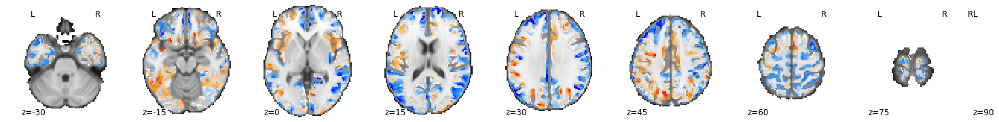

In [107]:
### CMRO2  as surface plot
from nilearn import datasets
from nilearn import surface 
from nilearn.surface import load_surf_mesh
from matplotlib import colors as clr


BSR_cluster_thr_nii =  os.path.join(results_dir, 'N' + N_subj +'_BSR_meanPLS_cmro2_' + resolution+'_' + contrast +'_' + whole_brain_masking + '_YEOmask.nii.gz')
maxval = 6
if design_scores_df_CMRO2.loc[task][1] > 0:
    newcmp = BlueRed
    newcmp_surface = BlueRed
else:
    newcmp =BlueRed_r
    newcmp_surface = BlueRed_r

fsaverage = datasets.fetch_surf_fsaverage()


plot = plotting.plot_img(BSR_cluster_thr_nii, bg_img=MNI_2mm_brain,  threshold=0, display_mode='z', cmap=newcmp, 
                    cut_coords = coords)

texture_left = surface.vol_to_surf(BSR_cluster_thr_nii, fsaverage['pial_left'])
texture_right = surface.vol_to_surf(BSR_cluster_thr_nii, fsaverage['pial_right'])

fig, ax = plt.subplots(figsize=(10, 10), ncols=2, subplot_kw={"projection": "3d"})
plot = plotting.plot_surf_stat_map(fsaverage.infl_left, texture_left,
                           hemi='left', view='medial',colorbar=False,
                            bg_map=fsaverage['sulc_left'], bg_on_data=True,
                           darkness=.3,  vmax=maxval, threshold=0, 
                            cmap=newcmp_surface, axes=ax[0])
                                 
plotting.plot_surf_stat_map(fsaverage.infl_right, texture_right,
                           hemi='right', view='medial',colorbar=False,
                            bg_map=fsaverage['sulc_right'], bg_on_data=True,
                           darkness=.3, vmax=maxval, threshold=0,
                            cmap=newcmp_surface, axes=ax[1],
                           output_file=results_dir + '/N' + N_subj +'_BSR_meanPLS_CMRO2_' + resolution+'_' +contrast+'_' + whole_brain_masking +'_right.pdf')
plt.tight_layout()

fig, ax = plt.subplots(figsize=(10, 10), ncols=2, subplot_kw={"projection": "3d"})
plotting.plot_surf_stat_map(fsaverage.infl_left, texture_left,
                           hemi='left', view='lateral', colorbar=False,
                           bg_map=fsaverage['sulc_left'], bg_on_data=True,
                           darkness=.3,  vmax=maxval, threshold=0,
                            cmap=newcmp_surface, axes=ax[0])
plotting.plot_surf_stat_map(fsaverage.infl_right, texture_right,
                           hemi='right', view='lateral',colorbar=False,
                            bg_map=fsaverage['sulc_right'], bg_on_data=True,
                           darkness=.3,  vmax=maxval, threshold=0,
                            cmap=newcmp_surface, axes=ax[1],
                            output_file=results_dir + '/N' + N_subj +'_BSR_meanPLS_CMRO2_' + resolution+'_' +contrast+'_' + whole_brain_masking + '_left.pdf', dpi=300)

plt.tight_layout()

## Histograms: distribution within PLS mask

func
sub-p021
sub-p054
sub-p059
sub-p060
sub-p070
sub-p071
sub-p072
sub-p073
sub-p074
sub-p075
func positive median: 0.42465120553970337
IQR positive:  0.35559357330203056
func negative median: -0.28254255652427673
IQR negative:  0.24390726163983345
cbf
sub-p021
sub-p054
sub-p059
sub-p060
sub-p070
sub-p071
sub-p072
sub-p073
sub-p074
sub-p075
cbf positive median: 5.8884183168411255
IQR positive:  9.627481788396835
cbf negative median: -2.6641058921813965
IQR negative:  9.131444305181503
cmro2
sub-p021
sub-p054
sub-p059
sub-p060
sub-p070
sub-p071
sub-p072
sub-p073
sub-p074
sub-p075
cmro2 positive median: 2.985996127128601
IQR positive:  10.453953297808766
cmro2 negative median: -2.0275086760520935
IQR negative:  10.041574537754059


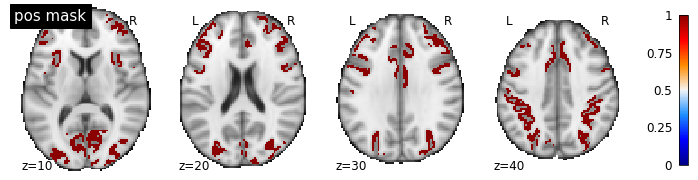

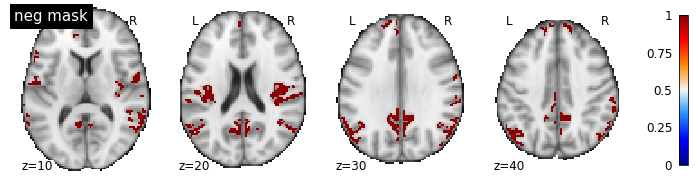

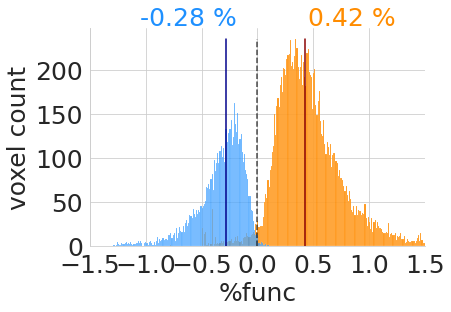

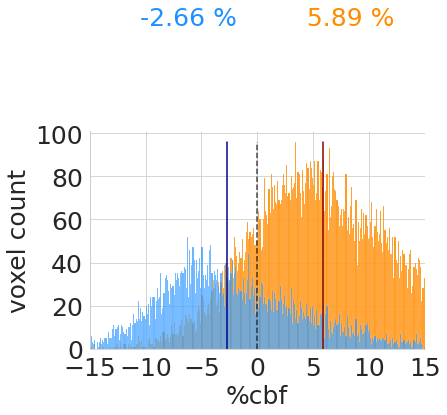

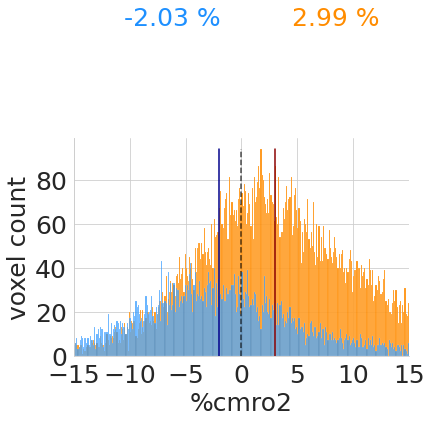

In [93]:
fontsize = 25
plt.rcParams['legend.title_fontsize'] = 'x-large'
sns.set_style("whitegrid")

##########################################################
## please select which parameters you want to look at! ##
##########################################################
parameters = ['func',  'cbf','cmro2']
#parameters = ['T2Smap']
#parameters = ['cbv']
#parameters = ['T2Smap']


df_percchange_median = pd.DataFrame(columns=parameters)
df_percchange_subj = pd.DataFrame(columns=parameters)
df_percchange_vox = pd.DataFrame(columns=parameters)


BSR_pos_nii_mask = results_dir + '/N' + N_subj +'_BSR_meanPLS_func_clusterBSR_' + resolution+'_' +contrast+'_' + whole_brain_masking +'_pos_bin.nii.gz'
plotting.plot_img(BSR_pos_nii_mask, bg_img = MNI_2mm_brain, cmap=BlueRed, cut_coords=(10, 20, 30, 40), display_mode='z',colorbar = True, threshold=0, vmin = 0, vmax = 1, title= 'pos mask')
masker_pos = input_data.NiftiMasker(mask_img = BSR_pos_nii_mask)        
pos_img=masker_pos.fit_transform(BSR_pos_nii_mask)
BSR_neg_nii_mask = results_dir + '/N' + N_subj +'_BSR_meanPLS_func_clusterBSR_' + resolution+'_' +contrast+'_' + whole_brain_masking +'_neg_bin.nii.gz'
plotting.plot_img(BSR_neg_nii_mask,bg_img = MNI_2mm_brain,  cmap=BlueRed, cut_coords=(10, 20, 30, 40), display_mode='z',colorbar = True, threshold=0,vmin = 0, vmax = 1, title= 'neg mask')
masker_neg = input_data.NiftiMasker(mask_img = BSR_neg_nii_mask) 
neg_img=masker_neg.fit_transform(BSR_neg_nii_mask)

for par in parameters: 
    print(par)
    percchange_pos = np.zeros((len(sids), len(np.argwhere(pos_img))))
    percchange_neg = np.zeros((len(sids), len(np.argwhere(neg_img))))

    for i, ID in enumerate(sids): #loop over subjects
        sub = "sub-p{:03d}".format(ID) # subject id, eg 'p021'
        print(sub)
        sub_id = "p{:03d}".format(ID) # subject id, eg 'p021'

        dir_deriv = os.path.join(data_dir, 'derivatives',  sub)
        dir_deriv_anat = os.path.join(data_dir, 'derivatives',  sub, 'anat')
        dir_deriv_func = os.path.join(data_dir, 'derivatives',  sub, 'func')
        dir_deriv_qmri = os.path.join(data_dir, 'derivatives',  sub, 'qmri')

        #load percent signal change image
        if par == 'func':
            percchange_img = os.path.join(dir_deriv_func, sub + '_task-'+task + baseline+'_space-MNI152_BOLD_percchange.nii.gz')
            percchange_arr_pos = masker_pos.fit_transform(percchange_img)
            percchange_arr_neg = masker_neg.fit_transform(percchange_img)
        if par !='func':
            par_map_task = os.path.join(dir_deriv_qmri, sub + '_task-' + task + '_space-MNI152_' + par + '.nii.gz')
            par_map_baseline = os.path.join(dir_deriv_qmri, sub + '_task-' + baseline + '_space-MNI152_' + par + '.nii.gz')  

            task_arr_pos = masker_pos.fit_transform(par_map_task)
            task_arr_neg = masker_neg.fit_transform(par_map_task)
            baseline_arr_pos = masker_pos.fit_transform(par_map_baseline)
            baseline_arr_neg = masker_neg.fit_transform(par_map_baseline)
            if par == 'cbf': ##upscale by 25%
                task_arr_pos = task_arr_pos/0.75
                task_arr_neg = task_arr_neg/0.75
                baseline_arr_pos = baseline_arr_pos/0.75
                baseline_arr_neg = baseline_arr_neg/0.75
            percchange_arr_pos = (task_arr_pos - baseline_arr_pos) / baseline_arr_pos *100
            percchange_arr_neg = (task_arr_neg - baseline_arr_neg) / baseline_arr_neg *100


        percchange_pos[i,:] = percchange_arr_pos
        percchange_neg[i,:] = percchange_arr_neg

    ## calculate median values across subjects
    percchange_median_pos = np.median(percchange_pos, axis=0)
    percchange_median_neg = np.median(percchange_neg, axis=0)
    df_percchange_vox[par] = [percchange_median_pos, percchange_median_neg]

    ## store median across voxels, per subject
    df_percchange_subj[par] =  [np.nanmedian(percchange_pos, axis=1), np.nanmedian(percchange_neg, axis=1)]

    ## median across all voxels
    pos_median = np.nanmedian(percchange_median_pos)
    neg_median = np.nanmedian(percchange_median_neg)
    df_percchange_median[par]=[pos_median, neg_median]

    print(par + ' positive median: ' + str(pos_median))

    ## print interquartile range
    # First quartile (Q1) 
    Q1 = np.percentile(percchange_median_pos, 25, interpolation = 'midpoint') 
    # Third quartile (Q3) 
    Q3 = np.percentile(percchange_median_pos, 75, interpolation = 'midpoint') 
    # Interquaritle range (IQR) 
    IQR = Q3 - Q1 

    print('IQR positive:  ' + str(IQR))

    print(par + ' negative median: ' + str(neg_median))
    ## print interquartile range
    # First quartile (Q1) 
    Q1 = np.percentile(percchange_median_neg, 25, interpolation = 'midpoint') 
    # Third quartile (Q3) 
    Q3 = np.percentile(percchange_median_neg, 75, interpolation = 'midpoint') 
    # Interquaritle range (IQR) 
    IQR = Q3 - Q1 

    print('IQR negative:  ' + str(IQR))

    ## plot only BOLD masked values        
    fig,ax = plt.subplots(1)      


    if par == 'func': 
        ax.set_xlim(-1.5, 1.5)
        width = 0.01
        brange = (-1.3, 1.5)
        #brange_neg = (-2.5, 0.5)
    else:
        ax.set_xlim(-15, 15)
        width = 0.1
        brange= (-15, 15)

    sns.histplot(percchange_median_pos, ax=ax, color='darkorange', alpha=0.9, bins=500, binrange = brange, binwidth= width)
    sns.histplot(percchange_median_neg, ax=ax, color='dodgerblue', alpha=0.7,  bins=500, binrange=brange, binwidth=width)

    #[t, p_pos] = stats.ttest_1samp(a=percchange_median_pos, popmean=0)
    #[t, p_neg] = stats.ttest_1samp(a=percchange_median_neg, popmean=0)
    #print('p-value positive change: ' + str(round(p_pos, 3)))           
    #print('p-value negative change: ' + str(round(p_neg, 3)))         

    ymin,ymax = ax.get_ylim()
    max_val = ymax - (0.05*ymax)
    plt.vlines(0, 0, max_val, color='black', alpha=0.7, linestyles='dashed')
    #ax.set_ylim(0, max_val)
    ax.set_xlabel('%' + par, fontsize=fontsize)
    ax.set_ylabel('voxel count', fontsize =fontsize)
    #ax.set_title(N_subj + ' subjects:'  + ' ' +  par + ' ' + CMRO2_mode + ' % signal change within ' + mask + ' mask')
    ax.plot([pos_median, pos_median], [0, max_val], color='darkred')
    ax.plot([neg_median, neg_median], [0, max_val], color='darkblue')
    if par == 'func' and task == 'calc':
        ax.text(brange[1]-0.7*brange[1], 250, str(round(np.nanmedian(percchange_median_pos), 2))+' %', color='darkorange', fontsize=fontsize)
        ax.text(brange[1]-1.7*brange[1], 250, str(round(np.nanmedian(percchange_median_neg), 2))+' %', color='dodgerblue', fontsize=fontsize)
    if par == 'func' and task == 'mem':
        ax.text(brange[1]-0.7*brange[1], 200, str(round(np.nanmedian(percchange_median_pos), 2))+' %', color='darkorange', fontsize=fontsize)
        ax.text(brange[1]-1.7*brange[1], 200, str(round(np.nanmedian(percchange_median_neg), 2))+' %', color='dodgerblue', fontsize=fontsize)
    if par != 'func':
        ax.text(brange[1]-0.7*brange[1], 150, str(round(np.nanmedian(percchange_median_pos), 2))+' %', color='darkorange', fontsize=fontsize)
        ax.text(brange[1]-1.7*brange[1], 150, str(round(np.nanmedian(percchange_median_neg), 2))+' %', color='dodgerblue', fontsize=fontsize)

    ## plot median %change values as legend
    #ax.legend(fontsize=16, loc='upper right', bbox_to_anchor=(0.4, 1))
    #set x-tick and y-ticke label size
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontsize(fontsize)

    for pos in ['right', 'top']:
        ax.spines[pos].set_visible(False)

    fig.show()
    fig.savefig(results_dir + '/N' + N_subj  + '_'+ contrast + '_' + par+'_percchange_histogram.png', dpi=300, bbox_inches='tight')

sub-p021
sub-p054
sub-p059
sub-p060
sub-p070
sub-p071
sub-p072
sub-p073
sub-p074
sub-p075
cbf
baseline positive ROI: 44.79639434814453, IQR: 12.59057331085205
baseline negative ROI: 41.52175045013428, IQR: 14.8017258644104
baseline positive ROI: 2.2603588104248047, IQR: 4.099087238311768
baseline negative ROI: -1.0081238746643066, IQR: 3.488649368286133
normal distribution within positive BOLD mask, p-value: 9.843130957125355e-228
normal distribution within negative BOLD mask, p-value: 1.4362165626243969e-10
median pos. delta value: 2.2604
median neg. delta value: -1.0081
sub-p021
sub-p054
sub-p059
sub-p060
sub-p070
sub-p071
sub-p072
sub-p073
sub-p074
sub-p075
cmro2
baseline positive ROI: 141.21739196777344, IQR: 80.73147392272949
baseline negative ROI: 125.82881164550781, IQR: 63.131479263305664
baseline positive ROI: 3.1936378479003906, IQR: 11.580307606607676
baseline negative ROI: -1.9403810501098633, IQR: 10.57508134841919
normal distribution within positive BOLD mask, p-value: 0.

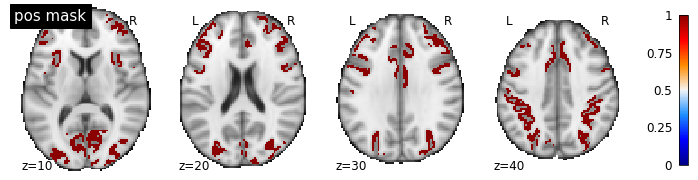

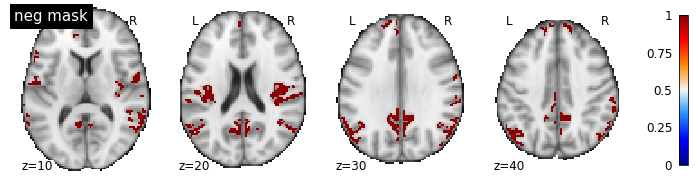

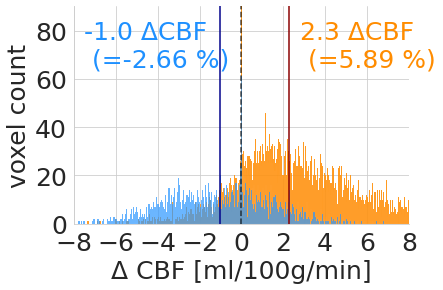

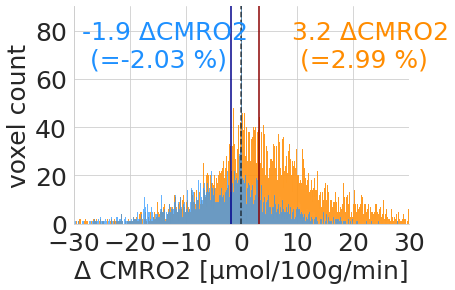

In [111]:
## delta values ##
#################################################


import scipy 
from scipy import stats
from sklearn.utils import check_random_state

fontsize = 25
plt.rcParams['legend.title_fontsize'] = 'x-large'


##########################################################
## please select which parameters you want to look at! ##
##########################################################
parameters = ['cbf','cmro2']
parameters = ['cbf','cmro2']

#parameters = ['T2Smap', 'cbf', 'cmro2']

BSR_pos_nii_mask = results_dir + '/N' + N_subj +'_BSR_meanPLS_func_clusterBSR_' + resolution+'_' +contrast+'_' + whole_brain_masking +'_pos_bin.nii.gz'
plotting.plot_img(BSR_pos_nii_mask, bg_img = MNI_2mm_brain, cmap=BlueRed, cut_coords=(10, 20, 30, 40), display_mode='z',colorbar = True, threshold=0, vmin = 0, vmax = 1, title= 'pos mask')
masker_pos = input_data.NiftiMasker(mask_img = BSR_pos_nii_mask)        
pos_img=masker_pos.fit_transform(BSR_pos_nii_mask)
BSR_neg_nii_mask = results_dir + '/N' + N_subj +'_BSR_meanPLS_func_clusterBSR_' + resolution+'_' +contrast+'_' + whole_brain_masking +'_neg_bin.nii.gz'
plotting.plot_img(BSR_neg_nii_mask,bg_img = MNI_2mm_brain,  cmap=BlueRed, cut_coords=(10, 20, 30, 40), display_mode='z',colorbar = True, threshold=0,vmin = 0, vmax = 1, title= 'neg mask')
masker_neg = input_data.NiftiMasker(mask_img = BSR_neg_nii_mask) 
neg_img=masker_neg.fit_transform(BSR_neg_nii_mask)

for par in parameters:

    delta_pos = np.zeros((len(sids), len(np.argwhere(pos_img))))
    delta_neg = np.zeros((len(sids), len(np.argwhere(neg_img))))
    task_pos = np.zeros((len(sids), len(np.argwhere(pos_img))))
    task_neg = np.zeros((len(sids), len(np.argwhere(neg_img))))
    baseline_pos = np.zeros((len(sids), len(np.argwhere(pos_img))))
    baseline_neg = np.zeros((len(sids), len(np.argwhere(neg_img))))

    for i, ID in enumerate(sids): #loop over subjects

        sub = "sub-p{:03d}".format(ID) # subject id, eg 'p021'
        print(sub)
        sub_id = "p{:03d}".format(ID) # subject id, eg 'p021'

        sub_dir = os.path.join(data_dir, sub)
        locfolder = tmp_dir + sub_id + '/' +  exp   


        #load percent signal change image
        par_map_task = os.path.join(locfolder, 'qBOLD', sub + '_task-' + task + '_space-MNI152_' + par + '.nii.gz')
        par_map_baseline = os.path.join(locfolder,  'qBOLD', sub + '_task-' + baseline + '_space-MNI152_' + par + '.nii.gz')  


        task_arr_pos = masker_pos.fit_transform(par_map_task)
        task_arr_neg = masker_neg.fit_transform(par_map_task)
        baseline_arr_pos = masker_pos.fit_transform(par_map_baseline)
        baseline_arr_neg = masker_neg.fit_transform(par_map_baseline)
        if par == 'cbf': ##upscale by 25%
            task_arr_pos = task_arr_pos/0.75
            task_arr_neg = task_arr_neg/0.75
            baseline_arr_pos = baseline_arr_pos/0.75
            baseline_arr_neg = baseline_arr_neg/0.75
        delta_arr_pos = task_arr_pos - baseline_arr_pos
        delta_arr_neg = task_arr_neg - baseline_arr_neg

        delta_pos[i,:] = delta_arr_pos
        delta_neg[i,:] = delta_arr_neg
        task_pos[i,:] = task_arr_pos
        task_neg[i,:] = task_arr_neg
        baseline_pos[i,:] = baseline_arr_pos
        baseline_neg[i,:] = baseline_arr_neg

    ## calculate median values across subjects
    delta_median_pos = np.median(delta_pos, axis=0)
    delta_median_neg = np.median(delta_neg, axis=0)
    task_median_pos = np.median(task_pos, axis=0)
    task_median_neg = np.median(task_neg, axis=0)
    baseline_median_pos = np.median(baseline_pos, axis=0)
    baseline_median_neg = np.median(baseline_neg, axis=0)

    print(par)

    ##print baseline IQR ## 
    #######################
    # First quartile (Q1) 
    Q1 = np.percentile(baseline_median_pos, 25, interpolation = 'midpoint') 
    # Third quartile (Q3) 
    Q3 = np.percentile(baseline_median_pos, 75, interpolation = 'midpoint') 
    # Interquaritle range (IQR) 
    IQR = Q3 - Q1 
    print('baseline positive ROI: ' + str(np.nanmedian(baseline_median_pos)) + ', IQR: ' + str(IQR))
    # First quartile (Q1) 
    Q1 = np.percentile(baseline_median_neg, 25, interpolation = 'midpoint') 
    # Third quartile (Q3) 
    Q3 = np.percentile(baseline_median_neg, 75, interpolation = 'midpoint') 
    # Interquaritle range (IQR) 
    IQR = Q3 - Q1         
    print('baseline negative ROI: ' + str(np.nanmedian(baseline_median_neg))+ ', IQR: ' + str(IQR))

    ##print delta IQR ## 
    #######################
    # First quartile (Q1) 
    Q1 = np.percentile(delta_median_pos, 25, interpolation = 'midpoint') 
    # Third quartile (Q3) 
    Q3 = np.percentile(delta_median_pos, 75, interpolation = 'midpoint') 
    # Interquaritle range (IQR) 
    IQR = Q3 - Q1 
    print('baseline positive ROI: ' + str(np.nanmedian(delta_median_pos)) + ', IQR: ' + str(IQR))
    # First quartile (Q1) 
    Q1 = np.percentile(delta_median_neg, 25, interpolation = 'midpoint') 
    # Third quartile (Q3) 
    Q3 = np.percentile(delta_median_neg, 75, interpolation = 'midpoint') 
    # Interquaritle range (IQR) 
    IQR = Q3 - Q1         
    print('baseline negative ROI: ' + str(np.nanmedian(delta_median_neg))+ ', IQR: ' + str(IQR))


    ## test for normality: if significant,no normal distribution!
    stat_pos_norm, p_value_pos_norm= stats.normaltest(delta_median_pos, axis=0, nan_policy='propagate')
    stat_neg_norm, p_value_neg_norm= stats.normaltest(delta_median_neg, axis=0, nan_policy='propagate')
    print('normal distribution within positive BOLD mask, p-value: ' + str(p_value_pos_norm))
    print('normal distribution within negative BOLD mask, p-value: ' + str(p_value_neg_norm))

    ##permutation test, because data are smoothed/non-independent
    #[true_diff_pos, p_pos] = permtest_rel(task_median_pos, baseline_median_pos, n_perm=2000)
    #print('permutation statistics within BOLD pos regions: ' + str(round(p_pos, 6)))

    #[true_diff_neg, p_neg] = permtest_rel(task_median_neg, baseline_median_neg, n_perm=2000)
    #print('permutation statistics within BOLD neg regions: ' + str(round(p_neg, 6)))


    ## plot only BOLD masked values        
    fig,ax = plt.subplots(1)            

    if par == 'cbf':
        x_val = 2.1
        max_val = 90
        #max_val = 70
        ax.set_xlim(-8, 8)
        brange = (-8,8)
        width = brange[1]/500
        axis_title = 'Δ CBF [ml/100g/min]'
    if par == 'cmro2':
        #max_val = 400
        max_val = 90
        x_val = 0.6
        ax.set_xlim(-30,30)
        brange = (-30,30)
        width = brange[1]/500
        axis_title = 'Δ CMRO2 [μmol/100g/min]'
    if par == 'cbv':
        #max_val = 400
        max_val = 90
        x_val = 0.6
        ax.set_xlim(-1,1)
        brange = (-1,1)
        ax.set_xticks([-1,-0.5, 0, 0.5, 1])
        width = brange[1]/500
        axis_title = 'Δ CBV [%vol]'
    if par == 'T2Smap':
        #max_val = 400
        max_val = 90
        x_val = 0.6
        ax.set_xlim(-2,2)
        ax.set_xticks([-2,-1, 0, 1, 2])
        brange = (-2,2)
        width = brange[1]/500
        axis_title = 'Δ T2* [ms]'
        
        
    sns.histplot(delta_median_pos, ax=ax, color='darkorange', alpha=0.9, bins=500, binrange = brange, binwidth= width)
    sns.histplot(delta_median_neg, ax=ax, color='dodgerblue', alpha=0.7,  bins=500, binrange=brange, binwidth=width)

    #max_val = ymax - (0.1*ymax)

    plt.vlines(0, 0, max_val, color='black', alpha=0.7, linestyles='dashed')
    #ax.set_xlim(-x_val, x_val)
    ax.set_ylim(0, max_val)
    ax.set_yticks((0, 20, 40, 60, 80))
    ax.set_xlabel(axis_title, fontsize=fontsize)
    ax.set_ylabel('voxel count', fontsize=fontsize)
    #ax.set_title(N_subj + ' subjects:'  + ' ' +  par + ' ' + CMRO2_mode + ' raw delta within ' + mask + ' mask')
    ax.plot([np.median(delta_median_pos), np.median(delta_median_pos)], [0, max_val], color='darkred')
    ax.plot([np.median(delta_median_neg), np.median(delta_median_neg)], [0, max_val], color='darkblue')
    # absolute median values as text in plot
    if par == 'cbf':
        ax.text(brange[0]-0.06*brange[0], 65,''+ str(round(np.median(delta_median_neg), 1))+' ΔCBF\n (='+ str(round(df_percchange_median[par][1], 2))+' %)', color='dodgerblue', fontsize=fontsize)            
        ax.text(brange[1]-0.65*brange[1], 65, ''+str(round(np.median(delta_median_pos), 1))+' ΔCBF\n (='+ str(round(df_percchange_median[par][0], 2))+' %)', color='darkorange', fontsize=fontsize)
    if par == 'cmro2':
        ax.text(brange[0]-0.05*brange[0], 65,''+ str(round(np.median(delta_median_neg), 1))+' ΔCMRO2\n (='+ str(round(df_percchange_median[par][1], 2))+' %)', color='dodgerblue', fontsize=fontsize)            
        ax.text(brange[1]-0.7*brange[1], 65,''+ str(round(np.median(delta_median_pos), 1))+' ΔCMRO2\n (='+ str(round(df_percchange_median[par][0],2))+' %)', color='darkorange', fontsize=fontsize)
    if par == 'cbv':
        ax.text(brange[0]-0.05*brange[0], 65,''+ str(round(np.median(delta_median_neg), 2))+' ΔCBV\n (='+ str(round(df_percchange_median[par][1], 2))+' %)', color='dodgerblue', fontsize=fontsize)            
        ax.text(brange[1]-0.7*brange[1], 65,''+ str(round(np.median(delta_median_pos), 2))+' ΔCBV\n (='+ str(round(df_percchange_median[par][0],2))+' %)', color='darkorange', fontsize=fontsize)
    if par == 'T2Smap':
        ax.text(brange[0]-0.05*brange[0], 65,''+ str(round(np.median(delta_median_neg), 2))+' ΔT2*\n (='+ str(round(df_percchange_median[par][1], 2))+' %)', color='dodgerblue', fontsize=fontsize)            
        ax.text(brange[1]-0.7*brange[1], 65,''+ str(round(np.median(delta_median_pos), 2))+' ΔT2*\n (='+ str(round(df_percchange_median[par][0],2))+' %)', color='darkorange', fontsize=fontsize)

    print('median pos. delta value: ' + str(round(np.median(delta_median_pos), 4)))
    print('median neg. delta value: ' + str(round(np.median(delta_median_neg), 4)))

    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontsize(fontsize)

    ## plot median %change values as legend
    #ax.legend(fontsize=18, loc='upper right', bbox_to_anchor=(0.35, 1.05))

    for pos in ['right', 'top']:
        ax.spines[pos].set_visible(False)

    fig.show()
    fig.savefig(results_dir + '/N' + N_subj +'_mask_'   + contrast + '_' + par+'_delta_histogram.png', dpi=300, bbox_inches='tight')


### native space analysis

In [ ]:
## 1st level GLM masks: output from fmriprep
import shutil

## define z-threshold for ROI
z_thr=2.5

parameters=['cbf','cmro2', 'func']


df_ROI_fMRI_median_values = pd.DataFrame(columns=['ID', 'par', 'ROI', 'cond', 'median', 'mean', 'std'])
df_ROI_qBOLD_median_values = pd.DataFrame(columns=['ID', 'par', 'ROI', 'cond', 'median', 'mean', 'std', 'num_vox'])

for i, ID in enumerate(sids): #loop over subjects
#for i, ID in enumerate(sids_cbv): #loop over subjects

    sub = "sub-p{:03d}".format(ID) # subject id, eg 'p021'
    print(sub)
    sub_id = "p{:03d}".format(ID) # subject id, eg 'p021'

    dir_deriv = os.path.join(data_dir, 'derivatives',  sub)
    dir_deriv_anat = os.path.join(data_dir, 'derivatives',  sub, 'anat')
    dir_deriv_func = os.path.join(data_dir, 'derivatives',  sub, 'func')
    dir_deriv_qmri = os.path.join(data_dir, 'derivatives',  sub, 'qmri')

    #load percent signal change image
    par_map_task = os.path.join(dir_deriv_qmri, sub + '_task-' + task + '_space-MNI152_' + par + '.nii.gz')
    par_map_baseline = os.path.join(dir_deriv_qmri, sub + '_task-' + baseline + '_space-MNI152_' + par + '.nii.gz')  

 
    for par in parameters:
                         
        if par == 'func':# output from fmriprep, registered to T2 space
            par_map =  os.path.join(dir_deriv_func, sub+ '_task-all_space-T2_desc-preproc_bold.nii.gz')
            par_map_img = nib.load(par_map)
            par_map_arr = np.array(par_map_img.dataobj) 
            if ID<56:
                ROIs = ['calccontrol', 'controlcalc', 'calcrest','restcalc', 'memcontrol', 'controlmem'] #visuomotor: control>rest
            if ID>55:
                ROIs = ['calccontrol', 'controlcalc']

            #mask with 1st level masks
            for ROI in ROIs: #loop over ROIs of interest
                ROI_nii = os.path.join(dir_deriv_func, sub + '_1stlevel_'+ROI+'_space-T2_qBmasked.nii.gz')
                ROI_nii_zthr = os.path.join(dir_deriv_func, sub + '_1stlevel_'+ROI+'_space-T2_zthr_qBmasked.nii.gz')
                ! fslmaths {ROI_nii} -thr {z_thr} {ROI_nii_zthr} 
                ROI_arr = np.array(nib.load(ROI_nii_zthr).dataobj)    
                par_masked = par_map_arr[ROI_arr>0.0001]
                par_median = np.nanmedian(par_masked, axis=0) #median across voxels per ROI
                if ID<56:
                    baseline_control = np.median(par_median[list(range(80, 100)) + list(range(205, 225)) + list(range(280, 300)) + list(range(355, 375))])  
                    baseline_rest = np.median(par_median[list(range(5, 25)) + list(range(130, 150)) + list(range(230, 250)) + list(range(330, 350))])
                    calc = par_median[list(range(55, 75)) + list(range(155, 175)) + list(range(255, 275)) + list(range(305, 325))]
                    mem = par_median[list(range(30, 50)) + list(range(105, 125)) + list(range(180, 200)) + list(range(380, 400))] 

                    perc_calc_control = 100* (calc - baseline_control) / baseline_control
                    par_median = np.nanmedian(perc_calc_control, axis=0)
                    par_mean = np.nanmean(perc_calc_control, axis=0)
                    par_std = np.nanstd(perc_calc_control, axis=0) 
                    new_row = {'ID':ID, 'par':par, 'ROI': ROI, 'cond':'calccontrol', 'median':par_median, 'mean':par_mean, 'std':par_std}
                    df_ROI_fMRI_median_values = df_ROI_fMRI_median_values.append(new_row, ignore_index = True)  

                    perc_mem_control = 100* (mem - baseline_control) / baseline_control
                    par_median = np.nanmedian(perc_mem_control, axis=0)
                    par_mean = np.nanmean(perc_mem_control, axis=0)
                    par_std = np.nanstd(perc_mem_control, axis=0) 
                    new_row = {'ID':ID, 'par':par, 'ROI': ROI, 'cond':'memcontrol', 'median':par_median, 'mean':par_mean, 'std':par_std}
                    df_ROI_fMRI_median_values = df_ROI_fMRI_median_values.append(new_row, ignore_index = True)  

                    perc_calc_rest = 100* (calc - baseline_rest) / baseline_rest
                    par_median = np.nanmedian(perc_calc_rest, axis=0)
                    par_mean = np.nanmean(perc_calc_rest, axis=0)
                    par_std = np.nanstd(perc_calc_rest, axis=0) 
                    new_row = {'ID':ID, 'par':par, 'ROI': ROI, 'cond':'calcrest', 'median':par_median, 'mean':par_mean, 'std':par_std}
                    df_ROI_fMRI_median_values = df_ROI_fMRI_median_values.append(new_row, ignore_index = True)  

                    perc_mem_rest = 100* (mem - baseline_rest) / baseline_rest
                    par_median = np.nanmedian(perc_mem_rest, axis=0)
                    par_mean = np.nanmean(perc_mem_rest, axis=0)
                    par_std = np.nanstd(perc_mem_rest, axis=0 )           
                    new_row = {'ID':ID, 'par':par, 'ROI': ROI, 'cond':'memrest', 'median':par_median, 'mean':par_mean, 'std':par_std}
                    df_ROI_fMRI_median_values = df_ROI_fMRI_median_values.append(new_row, ignore_index = True)  

                if ID>55:
                    baseline_control = np.median(par_median[list(range(5, 25)) + list(range(55, 75)) + list(range(105, 125)) + list(range(155, 175))])  
                    calc = par_median[list(range(30, 50)) + list(range(80, 100)) + list(range(130, 150)) + list(range(180, 200))]

                    perc_calc_control = 100* (calc - baseline_control) / baseline_control
                    par_median = np.nanmedian(perc_calc_control, axis=0)
                    par_mean = np.nanmean(perc_calc_control, axis=0)
                    par_std = np.nanstd(perc_calc_control, axis=0) 
                    new_row = {'ID':ID, 'par':par, 'ROI': ROI, 'cond':'calccontrol', 'median':par_median, 'mean':par_mean, 'std':par_std}
                    df_ROI_fMRI_median_values = df_ROI_fMRI_median_values.append(new_row, ignore_index = True)  

            ## save as csv after each subject
            df_ROI_fMRI_median_values.to_csv(os.path.join(results_dir, '1stlevel_ROIs_masked_fMRI.csv'))


        if par != 'func':#filtered func, output from fmriprep, registered to T2 space
            if ID<56:
                conds = ['rest', 'control', 'mem', 'calc']
                ROIs = ['calccontrol', 'controlcalc', 'calcrest','restcalc', 'memcontrol', 'controlmem'] #visuomotor: control>rest
            if ID>55:
                conds = ['control','calc']
                ROIs = ['calccontrol', 'controlcalc']

                
            for cond in conds: 
                if par != 'cmro2':
                    par_map =  os.path.join(dir_deriv, 'qmri', sub + '_task-'+cond+'_space-'+resolution+'_'+ par +'.nii')
                if par == 'cmro2'  and cond == 'calc':
                    if os.path.isfile(os.path.join(dir_deriv_qmri, sub + '_task-'+cond+'_space-'+resolution+'_desc-CBV_'+ par +'.nii.gz')):
                        par_map =  os.path.join(dir_deriv_qmri, sub + '_task-'+cond+'_space-'+resolution+'_desc-CBV_'+ par +'.nii.gz')
                    if os.path.isfile(os.path.join(dir_deriv_qmri, sub + '_task-'+cond+'_space-'+resolution+'_desc-CBV_'+ par +'.nii')):
                        par_map =  os.path.join(dir_deriv_qmri, sub + '_task-'+cond+'_space-'+resolution+'_desc-CBV_'+ par +'.nii')
                        
                if par == 'cmro2' and cond != 'calc':
                    if os.path.isfile(os.path.join(dir_deriv_qmri, sub + '_task-'+cond+'_space-'+resolution+'_desc-orig_'+ par +'.nii.gz')):
                        par_map =  os.path.join(dir_deriv_qmri, sub + '_task-'+cond+'_space-'+resolution+'_desc-orig_'+ par +'.nii.gz')
                    if os.path.isfile(os.path.join(dir_deriv_qmri, sub + '_task-'+cond+'_space-'+resolution+'_desc-orig_'+ par +'.nii')):
                        par_map =  os.path.join(dir_deriv_qmri, sub + '_task-'+cond+'_space-'+resolution+'_desc-orig_'+ par +'.nii')

                par_map_img = nib.load(par_map)
                par_map_arr = np.array(par_map_img.dataobj)
                
                #if par == 'cmro2': ## value without CBF upscaling
                #    par_map_arr = par_map_arr * 1.25

                ## if CBF, values have to be upscaled by 25% because of background supression pulses!
                if par == 'cbf': 
                    par_map_arr = par_map_arr / 0.75 

                #mask with 1st level masks
                for ROI in ROIs: #loop over ROIs of interest
                    ROI_nii = os.path.join(dir_deriv_func, sub + '_1stlevel_'+ROI+'_space-'+resolution+'_qBmasked.nii.gz')
                    ROI_nii_zthr = os.path.join(dir_deriv_func, sub + '_1stlevel_'+ROI+'_space-'+resolution+'_zthr_qBmasked.nii.gz')
                    ! fslmaths {ROI_nii} -thr {z_thr} {ROI_nii_zthr} 
                    ROI_arr = np.array(nib.load(ROI_nii_zthr).dataobj)    
                    par_masked = par_map_arr[ROI_arr>0.0001]
                    par_median = np.nanmedian(par_masked)
                    par_mean = np.nanmean(par_masked)
                    par_std = np.nanstd(par_masked)
                    par_num_vox = len(par_masked)

                    #store values in dataframe
                    new_row = {'ID':ID, 'par':par, 'ROI': ROI, 'cond':cond, 'median':par_median, 'mean':par_mean, 'std':par_std, 'num_vox':par_num_vox}
                    df_ROI_qBOLD_median_values = df_ROI_qBOLD_median_values.append(new_row, ignore_index = True)

                ## save as csv after each subject
                df_ROI_qBOLD_median_values.to_csv(os.path.join(results_dir, '1stlevel_ROIs_masked_qBOLD.csv'))

In [ ]:
## Please specify task & baseline ##
####################################

## define which conditions to plot
################################################################################################

baseline = 'control'
baseline_label='CTRL'

task = 'calc'
task_label='CALC'

################################################################################################


labels=[baseline_label, task_label]

contrast = task + baseline #for fMRI %change values
ROIs =[task + baseline, baseline + task] ## GLM ROIs 
conds = [baseline, task]




N_subj = str(len(sids))
GM_thresh = 0.5

In [ ]:
### func BOLD data
df_BOLD=pd.DataFrame()
for k, ROI in enumerate(ROIs):                   
    df_df_BOLD = pd.DataFrame()
    for i, ID in enumerate(sids): 
        BOLD = df_ROI_fMRI_median_values.query(f"par=='func' & ROI=='{ROI}' & cond=='{contrast}' & ID=={ID}")['median'].values                      
        new_row = {'ID':ID, 'median':BOLD[0]}
        df_df_BOLD = df_df_BOLD.append(new_row, ignore_index = True)                    

    df_BOLD[ROI] = df_df_BOLD['median']
    
    fig, ax = plt.subplots(1, 1, figsize=(1.5,6))
    
    if ROI == 'calccontrol' or ROI == 'calcrest' or ROI == 'memcontrol':
        colors = ['darkorange']
    if ROI == 'controlcalc'or ROI == 'restcalc' or ROI == 'controlmem':
        colors = ['dodgerblue']
        
    sns.boxplot(data = df_df_BOLD['median'],  orient='v', ax=ax,palette=colors, saturation=0.8,
                   boxprops={"edgecolor": (.6, .6, .6, .5)}, flierprops={"marker": "x"},
                   medianprops={"color": "black"})
    sns.swarmplot(data = df_df_BOLD['median'], orient='v', ax=ax, color='grey')
    plt.hlines(0, -0.6, 0.6, color='black', alpha=0.8, linestyles='dashed')
    ax.text(-0.3, 1.5, str(round(np.median(df_df_BOLD['median']), 2))+' %', color=colors[0], fontsize=fontsize)
    
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
            label.set_fontsize(fontsize)
    ax.set_ylabel('%BOLD', fontsize=fontsize)
    ax.set_ylim(-0.9,1.6)
    #ax.set_title(ROI + ' region: ' + contrast)
    
    for pos in ['right', 'top']:
        ax.spines[pos].set_visible(False)

    ax.set_xticklabels([labels[1]])
    
    fig.show()
    print(contrast + ' BOLD % change = '+ str(np.median(df_df_BOLD['median'])) )
    print(contrast + ' BOLD % change = '+ str(np.mean(df_df_BOLD['median'])) + ' +/- ' +str(np.std(df_df_BOLD['median'])))
    
    fig.savefig(os.path.join(results_dir,  'N'+N_subj + '_1stlevel_ROI_func_' + ROI + '_boxplots.png'), dpi=300, bbox_inches='tight')


In [ ]:
## CBF data 
from scipy import stats

grey_palette=["grey", "grey", "grey"]

for k, ROI in enumerate(ROIs): ## for ROIs                  
    fig, ax = plt.subplots(1,figsize=(2.5,6))
    df_qBOLD = pd.DataFrame()
    ID_colour_code=[]
    for cond in conds:
        qBOLD=np.zeros(len(sids))
        qBOLD_diff=np.zeros(len(sids))
        for i, ID in enumerate(sids): 
            qBOLD[i] = df_ROI_qBOLD_median_values.query(f"par=='cbf' & ROI=='{ROI}' & cond=='{cond}' & ID=={ID}")['median'].values  
            qBOLD_diff[i] = df_ROI_qBOLD_median_values.query(f"par=='cbf' & ROI=='{ROI}' & cond=='{task}' & ID=={ID}")['median'].values - df_ROI_qBOLD_median_values.query(f"par=='cbf' & ROI=='{ROI}' & cond=='{baseline}' & ID=={ID}")['median'].values  
        if cond=='control' or cond=='rest': ##baseline
            df_qBOLD['baseline'] = qBOLD                 
        if cond=='calc' or cond=='mem': ##task
            df_qBOLD['task'] = qBOLD                 

    ## significance: paired t-tests
    [tvalue, pvalue] = stats.ttest_rel(df_qBOLD['task'], df_qBOLD['baseline'])
    
    ## print mean and std values
    CBF_baseline = df_ROI_qBOLD_median_values.query(f"par=='cbf' & ROI=='{ROI}' & cond=='{baseline}' & ID=={sids}")['median'].values
    CBF_task = df_ROI_qBOLD_median_values.query(f"par=='cbf' & ROI=='{ROI}' & cond=='{task}' & ID=={sids}")['median'].values
    print('CBF baseline = ' + str(np.mean(CBF_baseline)) + ' +/- ' + str(np.std(CBF_baseline)))
    print('CBF task = ' + str(np.mean(CBF_task)) + ' +/- ' + str(np.std(CBF_task)))
    print('delta CBF = ' + str(np.nanmedian(df_qBOLD['task']-df_qBOLD['baseline'])) + ' +/- ' + str(np.std(df_qBOLD['task']-df_qBOLD['baseline'])))
    print('t-value = ' + str(tvalue))
    print('p-value = ' + str(pvalue))
    
    
    ##%signal change
    df_qBOLD['percchange']  = (df_qBOLD['task'] - df_qBOLD['baseline']) / df_qBOLD['baseline'] * 100
    
    ## get colors for line, depending if percchange is negative or positive
    if ROI=='calccontrol' or ROI =='calcrest' or ROI == 'memcontrol': ## activation ROI
        df_CBF_percchange = df_qBOLD['percchange']
        colors=my_colors_act
        for s in range(0, len(sids)):
            if qBOLD_diff[s]>0:
                ID_colour_code.append('gray')
            if qBOLD_diff[s]<0:
                ID_colour_code.append('red')        
    if ROI=='controlcalc' or ROI == 'restcalc' or ROI == 'controlmem': ##deactivation ROI
        colors=my_colors_deact
        for s in range(0, len(sids)):
            if qBOLD_diff[s]<0:
                ID_colour_code.append('gray')
            if qBOLD_diff[s]>0:
                ID_colour_code.append('red') 
                
    sns.boxplot(data = df_qBOLD,  orient='v', ax=ax,palette=colors, saturation=0.8,
                   boxprops={"edgecolor": (.6, .6, .6, .5)}, flierprops={"marker": "x"},
                   medianprops={"color": "black"})
    #sns.swarmplot(data = df_qBOLD, orient='v', ax=ax, color='grey')
    sns.stripplot(data = df_qBOLD, orient='v', ax=ax, palette=grey_palette)
    for line, ID in enumerate(sids): # for each subject separately
        ax.plot((df_ROI_qBOLD_median_values.query(f"par=='cbf' & ROI=='{ROI}' & cond=='{baseline}' & ID=={ID}")['median'].values, 
                   df_ROI_qBOLD_median_values.query(f"par=='cbf' & ROI=='{ROI}' & cond=='{task}' & ID=={ID}")['median'].values),   
                  linewidth=0.5, color=ID_colour_code[line]) #plot lines = subjects 

    ## plot significance
    #axis.plot([0, 0, 1, 1], [83, 84, 84, 83], lw=1.5, c='black')
    
    if pvalue<0.001:
        ax.text(0.5, 89, "**", ha='center', va='bottom', color='black', fontsize=fontsize)
        ax.hlines(89, 0, 1, color='black')
    if pvalue<0.05 and pvalue>0.001:
        ax.text(0.5, 89, "*", ha='center', va='bottom', color='black', fontsize=fontsize)
        ax.hlines(89, 0, 1, color='black')
        
    ax.text(-0.1, 84, str(round(np.median(df_qBOLD['percchange']), 2))+'%', color=colors[1], fontsize=fontsize, alpha=1)
    ax.set_ylim(25, 90)
    ax.set_ylabel('CBF [ml/100g/min]', fontsize=fontsize)
    ax.set_xlim(-0.5, 1.5)
    ax.set_xticks((0,1), labels=labels)

    for pos in ['right', 'top']:
            ax.spines[pos].set_visible(False)
            
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
            label.set_fontsize(fontsize)
            
    fig.show()
    
    fig.savefig(os.path.join(results_dir, 'N'+N_subj + '_1stlevel_ROI_cbf_'+ ROI + '_boxplots.png'), dpi=300, bbox_inches='tight')


In [ ]:
## CMRO2

from scipy import stats
grey_palette=["grey", "grey", "grey"]

for k, ROI in enumerate(ROIs): ## for ROIs                  
    fig, ax= plt.subplots(1, figsize=(2.5,6))
    df_qBOLD= pd.DataFrame()
    ID_colour_code=[]
    for cond in conds:
        qBOLD=np.zeros(len(sids))
        qBOLD_diff=np.zeros(len(sids))
        for i, ID in enumerate(sids): 
            qBOLD[i] = df_ROI_qBOLD_median_values.query(f"par=='cmro2' & ROI=='{ROI}' & cond=='{cond}' & ID=={ID}")['median'].values  
            qBOLD_diff[i] = df_ROI_qBOLD_median_values.query(f"par=='cmro2' & ROI=='{ROI}' & cond=='{task}' & ID=={ID}")['median'].values - df_ROI_qBOLD_median_values.query(f"par=='cmro2' & ROI=='{ROI}' & cond=='{baseline}' & ID=={ID}")['median'].values  
        if cond=='control' or cond=='rest': ##baseline
            df_qBOLD['baseline'] = qBOLD                 
        if cond=='calc' or cond=='mem': ##task
            df_qBOLD['task'] = qBOLD                 

     
    ## significance: paired t-tests
    [tvalue, pvalue] = stats.ttest_rel(df_qBOLD['task'], df_qBOLD['baseline'])
    
    ## print mean and std values
    CMRO2_baseline = df_ROI_qBOLD_median_values.query(f"par=='cmro2' & ROI=='{ROI}' & cond=='{baseline}' & ID=={sids}")['median'].values
    CMRO2_task = df_ROI_qBOLD_median_values.query(f"par=='cmro2' & ROI=='{ROI}' & cond=='{task}' & ID=={sids}")['median'].values
    print('CMRO2 baseline = ' + str(np.mean(CMRO2_baseline)) + ' +/- ' + str(np.std(CMRO2_baseline)))
    print('CMRO2_task task = ' + str(np.mean(CMRO2_task)) + ' +/- ' + str(np.std(CMRO2_task)))
    print('delta CMRO2 = ' + str(np.nanmedian(df_qBOLD['task']-df_qBOLD['baseline'])) + ' +/- ' + str(np.std(df_qBOLD['task']-df_qBOLD['baseline'])))
    print('t-value = ' + str(tvalue))
    print('p-value = ' + str(pvalue))
    
    ##%signal change
    df_qBOLD['percchange']  = (df_qBOLD['task'] - df_qBOLD['baseline']) / df_qBOLD['baseline'] * 100 
    
    if ROI=='calccontrol' or ROI =='calcrest' or ROI == 'memcontrol': ## activation ROI
        colors=my_colors_act
        for s in range(0, len(sids)):
            if qBOLD_diff[s]>0:
                ID_colour_code.append('gray')
            if qBOLD_diff[s]<0:
                ID_colour_code.append('red')        
    if ROI=='controlcalc' or ROI == 'restcalc' or ROI == 'controlmem': ##deactivation ROI
        colors=my_colors_deact
        for s in range(0, len(sids)):
            if qBOLD_diff[s]<0:
                ID_colour_code.append('gray')
            if qBOLD_diff[s]>0:
                ID_colour_code.append('red') 
                
    sns.boxplot(data = df_qBOLD,  orient='v', ax=ax,palette=colors,saturation=0.8,
                   boxprops={"edgecolor": (.6, .6, .6, .5)}, flierprops={"marker": "x"},
                   medianprops={"color": "black"})
    sns.stripplot(data = df_qBOLD, orient='v', ax=ax, palette=grey_palette)
    for line, ID in enumerate(sids): # for each subject separately
        ax.plot((df_ROI_qBOLD_median_values.query(f"par=='cmro2' & ROI=='{ROI}' & cond=='{baseline}' & ID=={ID}")['median'].values, 
                   df_ROI_qBOLD_median_values.query(f"par=='cmro2' & ROI=='{ROI}' & cond=='{task}' & ID=={ID}")['median'].values),   
                  linewidth=0.5, color=ID_colour_code[line]) #plot lines = subjects 

    ## plot significance
    #axis.plot([0, 0, 1, 1], [200, 202, 202, 200], lw=1.5, c='black')
    if pvalue<0.001:
        ax.text(0.5, 190, "**", ha='center', va='bottom', color='black', fontsize=fontsize)
        ax.hlines(190, 0, 1, color='black')
    if pvalue<0.05 and pvalue>0.001:
        ax.text(0.5, 190, "*", ha='center', va='bottom', color='black', fontsize=fontsize)
        ax.hlines(190, 0, 1, color='black')
        
    ax.text(-0.1, 181, str(round(np.median(df_qBOLD['percchange']), 2))+'%', color=colors[1], fontsize=fontsize, alpha=1)
    ax.set_ylim(70, 190)
    ax.set_ylabel('CMRO2  [µmol/100g/min]', fontsize=fontsize)
    ax.set_xlim(-0.5, 1.5)

    for pos in ['right', 'top']:
            ax.spines[pos].set_visible(False)
            
    for label in (ax.get_xticklabels() + ax.get_yticklabels()):
            label.set_fontsize(fontsize)
    ax.set_xticks((0,1), labels=labels)
                                
    fig.show()
    
    fig.savefig(os.path.join(results_dir, 'N'+N_subj + '_1stlevel_ROI_cmro2_'+ ROI + '_boxplots.png'), dpi=300, bbox_inches='tight')



# Discordant & concordant voxels

In [6]:
## Please which CMRO2 version to use ##
###################################################
sids=[76, 77, 78, 79, 70, 71, 72, 73, 74, 75]

###### Choose if semi-quantitative CMRO2 or fully quantitative CMRO2!
################################################################################
CMRO2_quant = 'semi-quant'
#CMRO2_quant = 'fully-quant'

## Please specify task & baseline ##
####################################

#baseline='rest'
baseline='control'
task='calc'
#task='mem'

conds = [baseline, task]
contrast=task+baseline


##########################################################
## please select which group task mask to apply!! ##
##########################################################

#masks = ['Yeo', 'PLS BOLD', 'PLS CBF', 'GLM BOLD']
#masks = ['PLS CBF', 'PLS CMRO2', 'PLS OEF']
mask = [ 'PLS BOLD'] ## this is the PLS BOLD group mask
#mask = ['PLS CBF']
#masks = ['GLM_BOLD']


### other variables ##############
##################################

N_subj = str(len(sids))
GM_thresh = 0.5
BSR_thr=2

################### Please specify if only GM mask or GM + CBV + R2' mask!! ######################################

whole_brain_masking = 'GMmask'
#whole_brain_masking = 'CBV_R2smask'

############## Please specify if MNI 2mm space or lowres MNI space !! #####################
resolution = 'res-2'
#resolution = 'lowres' ##here, it's also MNI 2mm space, but CMRO2 was calculated beforehands in lowres native space!

MNI_2mm_brain = derivatives_dir + '/MNI152_T1_2mm_brain.nii.gz'

if whole_brain_masking == 'GMmask':
    whole_brain_mask = os.path.join( derivatives_dir, 'task-all_space-MNI152_res-2_SNR_YEO_group_mask.nii.gz')
if whole_brain_masking == 'CBV_R2smask':
    whole_brain_mask = os.path.join(derivatives_dir, 'N40_CBV_R2s_mask_'+resolution+'.nii.gz')
    #whole_brain_mask = os.path.join(derivatives_dir, 'N' + str(len(sids)) + '_CBV_R2s_mask.nii.gz')
       
##########################################################################################

masker_GM = input_data.NiftiMasker(mask_img=whole_brain_mask)
mask_img = masker_GM.fit_transform(MNI_2mm_brain)

sub-p021
sub-p054
sub-p059
sub-p060
sub-p070
sub-p071
sub-p072
sub-p073
sub-p074
sub-p075


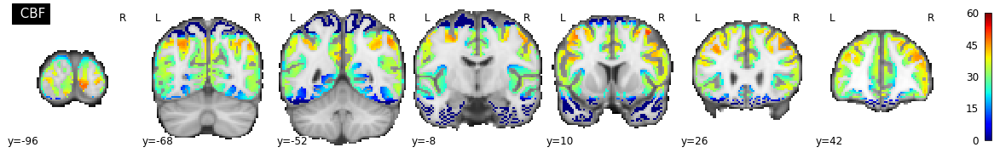

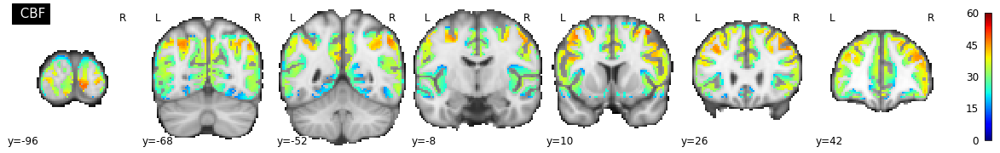

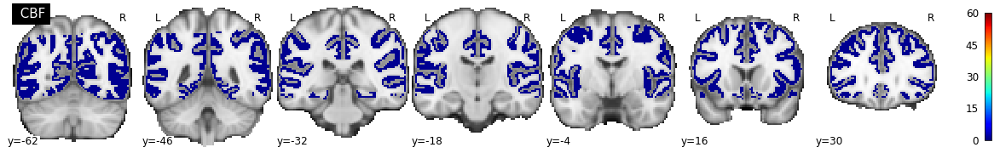

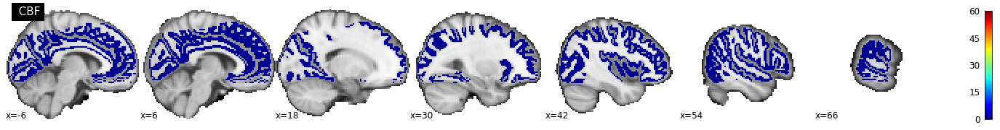

In [51]:
### create mask (upper and lower slices cut) from CBF data
SNR_GM_BOLD_mask_arr = np.array(nib.load(whole_brain_mask).dataobj)
SNR_GM_mask_len = len (SNR_GM_BOLD_mask_arr[abs(SNR_GM_BOLD_mask_arr)>0])
CBF_sids = np.zeros((len(sids), SNR_GM_mask_len))

for i, ID in enumerate(sids): #loop over subjects
    sub = "sub-p{:03d}".format(ID) # subject id, eg 'p021'
    subj_id = "p{:03d}".format(ID) # subject id, eg 'p021'
    print(sub)
    dir_deriv = os.path.join(data_dir, 'derivatives',  sub)
    dir_deriv_anat = os.path.join(data_dir, 'derivatives',  sub, 'anat')
    dir_deriv_func = os.path.join(data_dir, 'derivatives',  sub, 'func')
    dir_deriv_qmri = os.path.join(data_dir, 'derivatives',  sub, 'qmri')

    CBF_nii = os.path.join(dir_deriv_qmri, sub + '_task-control_space-MNI152_cbf.nii.gz')

    CBF_sids[i, :] =  masker_GM.fit_transform(CBF_nii)
    
CBF_median = np.nanmedian(CBF_sids, axis=0)
CBF_nifti = masker_GM.inverse_transform(CBF_median)
nib.save(CBF_nifti, os.path.join(results_dir, 'CBF_median.nii.gz'))
plot=plotting.plot_img(CBF_nifti, bg_img=MNI_2mm_brain, threshold = 0, cmap='jet', colorbar=True,
                display_mode='y', title=   ' CBF',vmin=0, vmax=60)
CBF_nii = os.path.join(results_dir, 'CBF_median.nii.gz')
CBF_nii_thr = os.path.join(results_dir, 'CBF_median_thr.nii.gz')

! fslmaths {CBF_nii} -thr {15} {CBF_nii_thr}
plot=plotting.plot_img(CBF_nii_thr, bg_img=MNI_2mm_brain, threshold = 0, cmap='jet', colorbar=True,
                display_mode='y', title=   ' CBF',vmin=0, vmax=60)

## create msk
CBF_nii_mask = os.path.join(results_dir, 'CBF_median_mask.nii.gz')
! fslmaths {CBF_nii_thr} -bin {CBF_nii_mask}
plot=plotting.plot_img(CBF_nii_mask, bg_img=MNI_2mm_brain, threshold = 0, cmap='jet', colorbar=True,
                display_mode='y', title=   ' CBF',vmin=0, vmax=60)
plot=plotting.plot_img(CBF_nii_mask, bg_img=MNI_2mm_brain, threshold = 0, cmap='jet', colorbar=True,
                display_mode='x', title=   ' CBF',vmin=0, vmax=60)

masker_GM = input_data.NiftiMasker(mask_img=whole_brain_mask)
mask_img = masker_GM.fit_transform(MNI_2mm_brain)

### calculate percchange values within group mask

sub-p021
sub-p054
sub-p059
sub-p060
sub-p070
sub-p071
sub-p072
sub-p073
sub-p074
sub-p075


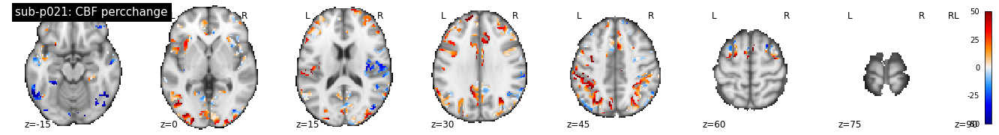

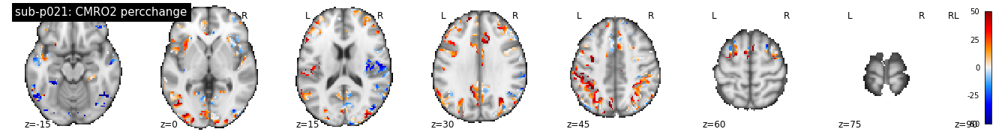

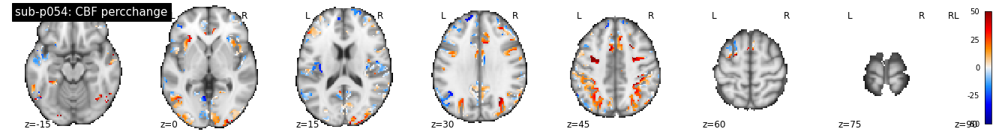

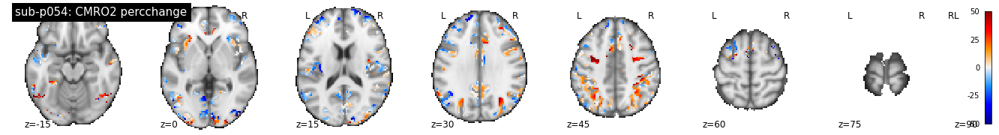

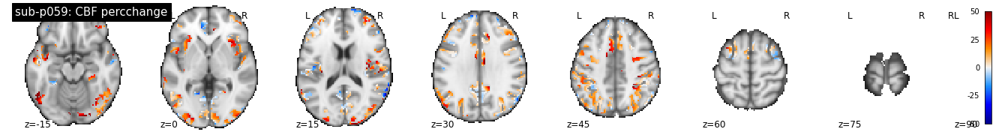

...

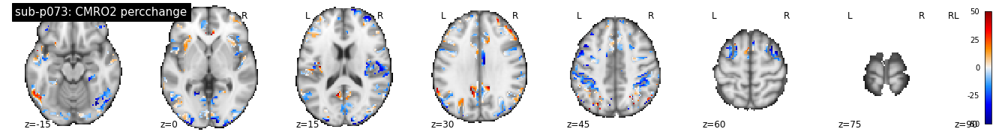

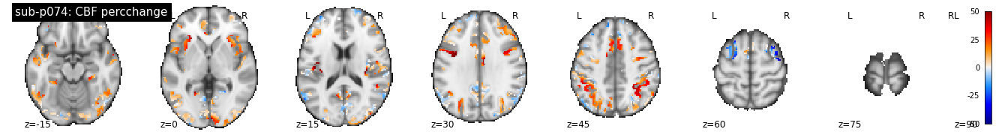

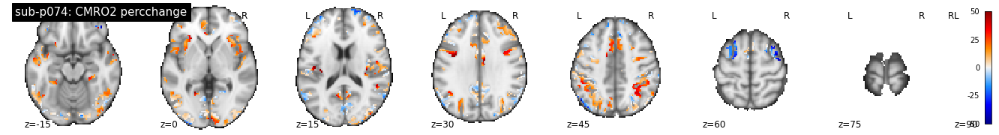

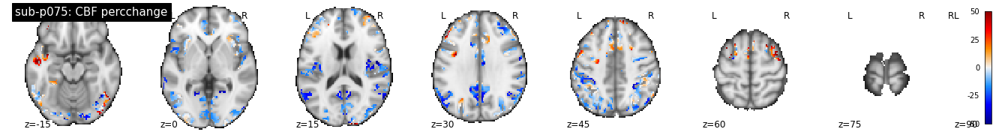

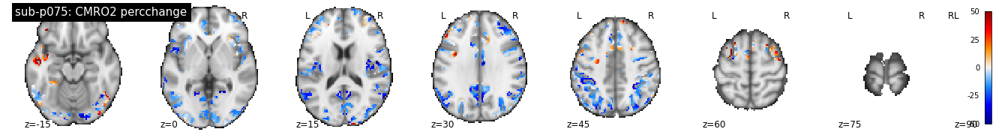

In [8]:

BOLD_percchange = np.zeros((len(sids), mask_len))
CBF_percchange = np.zeros((len(sids), mask_len))
CMRO2_percchange = np.zeros((len(sids), mask_len))

## SNR-GM mask (same mask was used for the PLS input)
SNR_GM_BOLD_mask_arr = np.array(nib.load(whole_brain_mask).dataobj)
SNR_GM_mask_len = len (SNR_GM_BOLD_mask_arr[abs(SNR_GM_BOLD_mask_arr)>0])
BOLD_percchange_GM = np.zeros((len(sids), SNR_GM_mask_len))
CBF_percchange_GM = np.zeros((len(sids), SNR_GM_mask_len))
CMRO2_percchange_GM = np.zeros((len(sids), SNR_GM_mask_len))

for i, ID in enumerate(sids): #loop over subjects
    sub = "sub-p{:03d}".format(ID) # subject id, eg 'p021'
    subj_id = "p{:03d}".format(ID) # subject id, eg 'p021'
    print(sub)
    dir_deriv = os.path.join(data_dir, 'derivatives',  sub)
    dir_deriv_anat = os.path.join(data_dir, 'derivatives',  sub, 'anat')
    dir_deriv_func = os.path.join(data_dir, 'derivatives',  sub, 'func')
    dir_deriv_qmri = os.path.join(data_dir, 'derivatives',  sub, 'qmri')

    #load percent signal change image
    BOLD_percchange_nii = nib.load(os.path.join(dir_deriv_func, sub + '_task-'+contrast+'_space-MNI152_BOLD_percchange.nii.gz'))
    BOLD_percchange[i, :] = masker.fit_transform(BOLD_percchange_nii) 
    BOLD_percchange_GM[i, :] = masker_GM.fit_transform(BOLD_percchange_nii) 
        
    ## for CBF, create %change    
    CBF_task = masker.fit_transform(os.path.join(dir_deriv_qmri, sub + '_task-' + task + '_space-MNI152_cbf.nii.gz'))/0.75
    CBF_baseline = masker.fit_transform(os.path.join(dir_deriv_qmri, sub + '_task-' + baseline + '_space-MNI152_cbf.nii.gz'))/0.75
    CBF_percchange[i, :]  = (CBF_task - CBF_baseline) / CBF_baseline *100
    CBF_percchange[i, :][abs(CBF_percchange[i, :])>60]  = np.nan ## kick out values that are unreasonably high!
    
    CBF_baseline_GM = masker_GM.fit_transform(os.path.join(dir_deriv_qmri, sub + '_task-' + baseline + '_space-MNI152_cbf.nii.gz'))/0.75
    CBF_task_GM = masker_GM.fit_transform(os.path.join(dir_deriv_qmri, sub + '_task-' + task + '_space-MNI152_cbf.nii.gz'))/0.75
    CBF_percchange_GM[i, :]  = (CBF_task_GM - CBF_baseline_GM) / CBF_baseline_GM *100
    CBF_percchange_GM[i, :][abs(CBF_percchange_GM[i, :])>60]  = np.nan ## kick out values that are unreasonably high!

    ## create image of CMRO2 percchange per subject ()
    CBF_percchange_nii = masker.inverse_transform(CBF_percchange[i, :])
    plot=plotting.plot_img(CBF_percchange_nii, bg_img=MNI_2mm_brain, display_mode='z', threshold=0, cmap=BlueRed, colorbar = True, black_bg=False,
                   cut_coords = coords, title= sub + ': CBF percchange', vmin = -50, vmax = 50)

    ## for CMR02, create %change
    ## baseline
    CMRO2_baseline = masker.fit_transform(os.path.join(dir_deriv_qmri, sub + '_task-' + baseline + '_space-MNI152_cmro2.nii.gz'))
    
    if CMRO2_quant == 'fully-quant':
        ## task
        CMRO2_task =  masker.fit_transform(os.path.join(dir_deriv_qmri, sub + '_task-' + task + '_space-MNI152_cmro2.nii.gz'))
                
    if CMRO2_quant == 'semi-quant':
        ## task
        CMRO2_task = masker.fit_transform(os.path.join(dir_deriv_qmri, sub + '_task-'+task+'_base-'+baseline+'_space-MNI152_desc-semi-quant_cmro2.nii.gz'))
    
    CMRO2_percchange[i, :]  = (CMRO2_task- CMRO2_baseline) / CMRO2_baseline *100 
    CMRO2_percchange[i, :][np.isinf(CMRO2_percchange[i, :])]  = np.nan
    CMRO2_percchange[i, :][abs(CMRO2_percchange[i, :])>60]  = np.nan ## kick out values that are unreasonably high!
    
    ## create image of CMRO2 percchange per subject ()
    #CMRO2_percchange_nii = masker.inverse_transform(CMRO2_percchange[i, :])
    #plot=plotting.plot_img(CMRO2_percchange_nii, bg_img=MNI_2mm_brain, display_mode='z', threshold=0, cmap=BlueRed, colorbar = True, black_bg=False,
    #               cut_coords = coords, title= sub + ': CMRO2 percchange', vmin = -100, vmax = 100)
   
    ## GM mask
    ## baseline
    CMRO2_baseline_GM = masker_GM.fit_transform(os.path.join(dir_deriv_qmri, sub + '_task-' + baseline + '_space-MNI152_cmro2.nii.gz'))
    
    if CMRO2_quant == 'fully-quant':
        ## task
        CMRO2_task_GM = masker_GM.fit_transform(os.path.join(dir_deriv_qmri, sub + '_task-' + task + '_space-MNI152_cmro2.nii.gz'))
                
    if CMRO2_quant == 'semi-quant':
        ## task
        CMRO2_task_GM = masker_GM.fit_transform(os.path.join(dir_deriv_qmri, sub + '_task-'+task+'_base-'+baseline+'_space-MNI152_desc-semi-quant_cmro2.nii.gz'))
                                                                                      
    CMRO2_percchange_GM[i, :]  = (CMRO2_task_GM - CMRO2_baseline_GM) / CMRO2_baseline_GM *100       
    CMRO2_percchange_GM[i, :][np.isinf(CMRO2_percchange_GM[i, :])]  = np.nan
    CMRO2_percchange_GM[i, :][abs(CMRO2_percchange_GM[i, :])>60]  = np.nan ## kick out values that are unreasonably high!
    
    ## create image of CMRO2 percchange per subject ()
    CMRO2_percchange_nii = masker.inverse_transform(CMRO2_percchange[i, :])
    plot=plotting.plot_img(CMRO2_percchange_nii, bg_img=MNI_2mm_brain, display_mode='z', threshold=0, cmap=BlueRed, colorbar = True, black_bg=False,
                   cut_coords = coords, title= sub + ': CMRO2 percchange', vmin = -50, vmax = 50)


## save % change
BOLD_percchange_median = np.nanmedian(BOLD_percchange, axis=0)
CBF_percchange_median = np.nanmedian(CBF_percchange, axis=0)
CMRO2_percchange_median = np.nanmedian(CMRO2_percchange, axis=0)

BOLD_percchange_median_GM = np.nanmedian(BOLD_percchange_GM, axis=0)
CBF_percchange_median_GM = np.nanmedian(CBF_percchange_GM, axis=0)
CMRO2_percchange_median_GM = np.nanmedian(CMRO2_percchange_GM, axis=0)


## Scatterplot

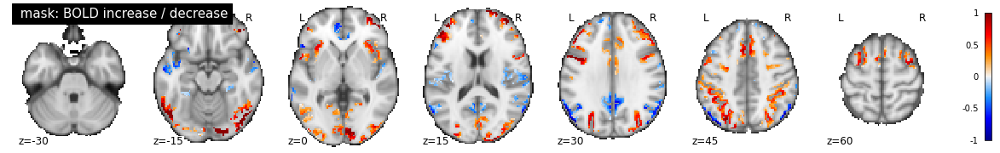

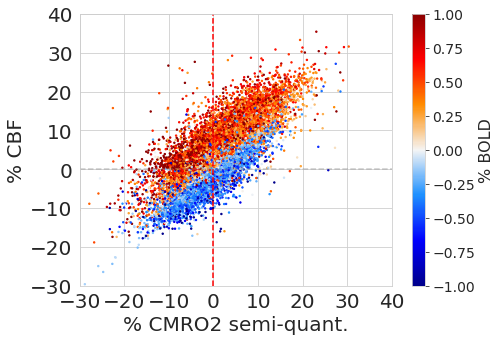

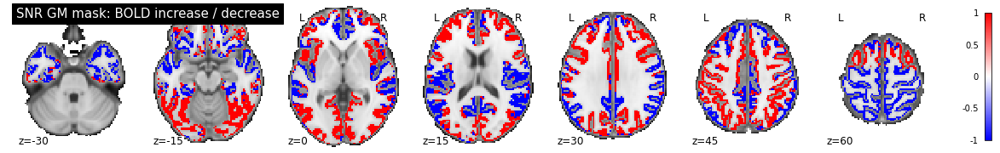

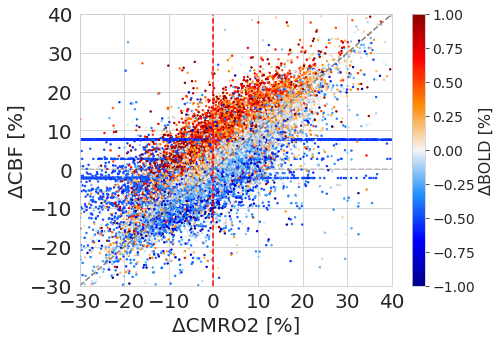

In [9]:
from matplotlib.colors import ListedColormap

colors_lightorange = ListedColormap(["navajowhite"])
colors_lightblue = ListedColormap(["lightskyblue"])

coords = (-30, -15, 0, 15, 30, 45, 60)
#DMN = os.path.join(tmp_dir,'Yeo2011_17Networks_MNI152_FreeSurferConformed2mm_MNI_DMN.nii.gz')
colors=BlueRed

fontsize=20

BOLD_nifti = masker.inverse_transform(BOLD_percchange_median)
plot=plotting.plot_img(BOLD_nifti, bg_img=MNI_2mm_brain, threshold = 0, display_mode='z', cmap=colors, colorbar=True,
                cut_coords = coords,  title=   ' mask: BOLD increase / decrease',vmin=-1, vmax=1 )

## plot %signal change in CMRO2 and CBF vs. BOLD (in color) ##
##############################################################

## group mask ##
###################

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(-30, 40, num=200)

## plot %signal change in CMRO2 and CBF vs. BOLD (in color)
fig, ax = plt.subplots(1, 1, figsize=(7,5))
scatter = ax.scatter(CMRO2_percchange_median, CBF_percchange_median, c=BOLD_percchange_median, s=2, cmap = colors, vmin=-1, vmax=1)

cbar = plt.colorbar(scatter)
cbar.set_label("% BOLD", fontsize=16)
cbar.ax.tick_params(labelsize=14)
# Plot regression line
#ax.plot(xseq, a + b * xseq, color="grey", lw=2.5, linestyle='dashed');
#ax.text(20, 40, 'b=' + str(round(b, 2)), fontsize=fontsize)
    

plt.hlines(0, -30, 40, color='grey', alpha=0.4, linestyles='dashed')
plt.vlines(0, -30, 40, color='red',alpha=1, linestyles='dashed')

ax.set_xlabel('% CMRO2 semi-quant.', fontsize=fontsize)
ax.set_ylabel('% CBF', fontsize=fontsize)
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontsize(fontsize)
    
ax.set_xlim(-30,40)
ax.set_ylim(-30,40)

fig.savefig(results_dir + '/CMRO2_CBF'+ '_mask_' +  contrast +  '_' +'.png', dpi=300, bbox_inches='tight')

plt.show()


## GM SNR mask ##
#################

## plot only BOLD
BOLD = np.zeros((1, len(BOLD_percchange_median_GM)))
BOLD[0, BOLD_percchange_median_GM>0.001] = 1
BOLD[0, BOLD_percchange_median_GM<-0.001] = -1
BOLD_sum = np.sum(BOLD, axis=0)

BOLD_nifti = masker_GM.inverse_transform(BOLD_sum)

plot=plotting.plot_img(BOLD_nifti, bg_img=MNI_2mm_brain, threshold = 0, display_mode='z', cmap='bwr', colorbar=True,
                cut_coords = coords,  title= 'SNR GM mask: BOLD increase / decrease')
#plot.add_contours(DMN,  colors='black', alpha = 1, linewidths=0.3)

# Create sequence of 100 numbers from 0 to 100 
#xseq = np.linspace(-30, 40, num=200)

## plot %signal change in CMRO2 and CBF vs. BOLD (in color)
fig, ax = plt.subplots(1, 1, figsize=(7,5))
scatter = ax.scatter(CMRO2_percchange_median_GM, CBF_percchange_median_GM, c=BOLD_percchange_median_GM, s=2, cmap = colors, vmin=-1, vmax=1)
# Plot regression line
#ax.plot(xseq, a + b * xseq, color="grey", lw=2.5, linestyle='dashed');
#ax.text(20, 40, 'b=' + str(round(b, 2)), fontsize=fontsize)

cbar = plt.colorbar(scatter)
cbar.set_label("ΔBOLD [%]", fontsize=16)
cbar.ax.tick_params(labelsize=14)

#ax.set_title("change in BOLD, median across subjects, SNR GM mask")

plt.hlines(0, -30, 40, color='grey', alpha=0.4, linestyles='dashed')
plt.vlines(0, -30, 40, color='red',alpha=1, linestyles='dashed')

ax.set_xlabel('ΔCMRO2 [%]', fontsize=fontsize)
ax.set_ylabel('ΔCBF [%]', fontsize=fontsize)
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontsize(fontsize)
ax.plot([-30, 40], [-30, 40], color='gray', linestyle='--')


ax.set_xlim(-30,40)
ax.set_ylim(-30,40)

fig.savefig(results_dir + '/CMRO2_CBF'+ '_mask_' + contrast +  '_' +'_'+whole_brain_masking+'.png', dpi=300, bbox_inches='tight')

plt.show()


## pie-charts

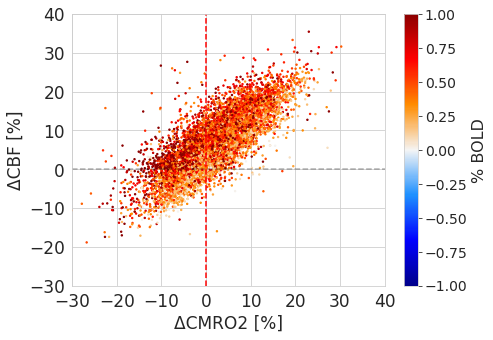

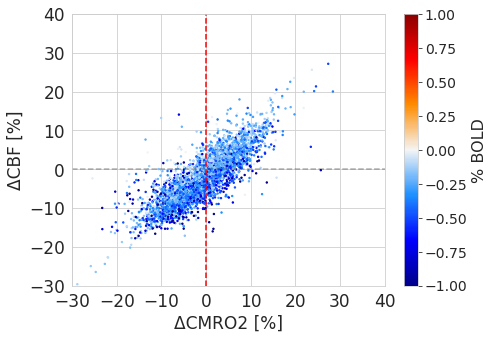

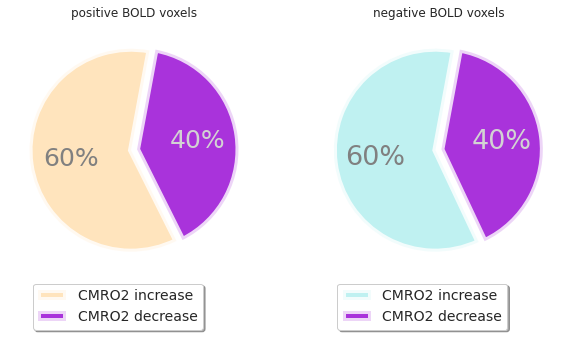

In [10]:
sns.set_style("whitegrid")
## only look at fully quant CMRO2 and within BOLD PLS region 

coords = (-30, -15, 0, 15, 30, 45, 60)
DMN = os.path.join(derivatives_dir,'Yeo2011_7Networks_MNI152_FreeSurferConformed2mm_MNI_DMN.nii.gz')
colors = BlueRed
colors_bin = ListedColormap(["dodgerblue", "darkorange"])
colors_lightorange = ListedColormap(["navajowhite"])
colors_lightblue = ListedColormap(["paleturquoise"])


##############################################################
fontsize=17 
plt.rcParams['legend.title_fontsize'] = 'x-large'


## group mask ##
###################

## only positive BOLD voxels ##
###############################

BOLD_percchange_median_pos = np.delete(BOLD_percchange_median, np.where(BOLD_percchange_median<=0))
CMRO2_percchange_median_pos = np.delete(CMRO2_percchange_median, np.where(BOLD_percchange_median<=0)) 
CBF_percchange_median_pos = np.delete(CBF_percchange_median, np.where(BOLD_percchange_median<=0)) 

### get regression equation and plot line
# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)

#b, a = np.polyfit(CMRO2_percchange_median_pos, CBF_percchange_median_pos, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(-40, 40, num=200)


## plot %signal change in CMRO2 and CBF vs. BOLD (in color)
fig, ax = plt.subplots(1, 1, figsize=(7,5))

scatter = ax.scatter(CMRO2_percchange_median_pos, CBF_percchange_median_pos, c=BOLD_percchange_median_pos, s=2, cmap =colors, vmin=-1, vmax=1)
# Plot regression line
#ax.plot(xseq, a + b * xseq, color="grey", lw=2.5, linestyle='dashed');
#ax.text(20, 40, 'b=' + str(round(b, 2)), fontsize=fontsize)

cbar = plt.colorbar(scatter)
cbar.set_label("% BOLD", fontsize=16)
cbar.ax.tick_params(labelsize=14)
    
plt.hlines(0, -30, 40, color='black', alpha=0.3, linestyles='dashed')
plt.vlines(0, -30, 40, color='red',alpha=1, linestyles='dashed')

ax.set_xlabel('ΔCMRO2 [%]', fontsize=fontsize)
ax.set_ylabel('ΔCBF [%]', fontsize=fontsize)

for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontsize(fontsize)
    
ax.set_xlim(-30,40)
ax.set_ylim(-30,40)
fig.savefig(results_dir + '/CMRO2_CBF'+ '_mask_'  + contrast +  '_pos.png', dpi=300, bbox_inches='tight')

plt.show()


## only negative BOLD voxels ##
###############################
BOLD_percchange_median_neg = np.delete(BOLD_percchange_median, np.where(BOLD_percchange_median>=0))
CMRO2_percchange_median_neg = np.delete(CMRO2_percchange_median, np.where(BOLD_percchange_median>=0)) ## where BOLD percchange is negative
CBF_percchange_median_neg = np.delete(CBF_percchange_median, np.where(BOLD_percchange_median>=0)) ## where BOLD percchange is negative

### get regression equation and plot line
# Fit linear regression via least squares with numpy.polyfit
# It returns an slope (b) and intercept (a)
# deg=1 means linear fit (i.e. polynomial of degree 1)
#b, a = np.polyfit(CMRO2_percchange_median_neg, CBF_percchange_median_neg, deg=1)

# Create sequence of 100 numbers from 0 to 100 
xseq = np.linspace(-40, 40, num=200)

## plot %signal change in CMRO2 and CBF vs. BOLD (in color)
fig, ax = plt.subplots(1, 1, figsize=(7,5))
scatter = ax.scatter(CMRO2_percchange_median_neg, CBF_percchange_median_neg, c=BOLD_percchange_median_neg, s=2, cmap =colors, vmin=-1, vmax=1)
# Plot regression line
#ax.plot(xseq, a + b * xseq, color="grey", lw=2.5, linestyle='dashed');
#ax.text(20, 40, 'b=' + str(round(b, 2)), fontsize=fontsize)

cbar = plt.colorbar(scatter)
cbar.set_label("% BOLD", fontsize=16)
cbar.ax.tick_params(labelsize=14)

plt.hlines(0, -30, 40, color='black', alpha=0.3, linestyles='dashed')
plt.vlines(0, -30, 40, color='red',alpha=1, linestyles='dashed')

ax.set_xlabel('ΔCMRO2 [%]', fontsize=fontsize)
ax.set_ylabel('ΔCBF [%]', fontsize=fontsize)

ax.set_xlim(-30,40)
ax.set_ylim(-30,40)

for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontsize(fontsize)

fig.savefig(results_dir + '/CMRO2_CBF' + '_mask_' + contrast +  '_neg.png', dpi=300, bbox_inches='tight')
    
plt.show()


## pie-chart false increases/decreases ##
########################################


colours_pos= [ 'navajowhite', 'darkviolet'] ## increase, decrease
colours_neg= [ 'paleturquoise', 'darkviolet'] ## decrease, increase

## separate in voxels that show BOLD positive or negative changes
##NBR
CMRO2_neg = CMRO2_percchange_median_neg[BOLD_percchange_median_neg<=0] ## where BOLD percchange is negative
CMRO2_neg_pos = len(CMRO2_neg[CMRO2_neg>=0]) ## here CMRO2 is positive but BOLD is negative
CMRO2_neg_neg = len(CMRO2_neg[CMRO2_neg<=0]) ## here both CMRO2 and BOLD is negative

##PBR
CMRO2_pos = CMRO2_percchange_median_pos[BOLD_percchange_median_pos>0]
CMRO2_pos_pos = len(CMRO2_pos[CMRO2_pos>=0]) ## here both CMRO2 and BOLD is posiitive
CMRO2_pos_neg = len(CMRO2_pos[CMRO2_pos<=0]) ## here BOLD is positive but CMRO2 is negative 

## negative BOLD voxels ##
##NBR
df_neg_CMRO2 = pd.DataFrame({'vox_num':[CMRO2_neg_neg, CMRO2_neg_pos], 'labels':['CMRO2 decrease', 'CMRO2 increase']})
## positive BOLD voxels ##
##PBR
df_pos_CMRO2 = pd.DataFrame({'vox_num':[CMRO2_pos_pos, CMRO2_pos_neg], 'labels':['CMRO2 increase', 'CMRO2 decrease']})

fig, (ax1, ax2) = plt.subplots(1,2, figsize=(10,10))
    
patches, texts, autotexts = ax1.pie(df_pos_CMRO2.vox_num, labels=['',''],autopct = '%0.0f%%', startangle = 79.5, explode = [0.03,0.03],
        textprops = {'fontsize':25}, colors=colours_pos, wedgeprops = {'linewidth': 6, 'alpha':0.8}, center = (0.1,0.1))
autotexts[0].set_color('gray')
autotexts[1].set_color('lightgray')

ax1.set_title('positive BOLD voxels')

ax1.legend( bbox_to_anchor=(0.8, 0), labels = df_pos_CMRO2.labels, fontsize=14, shadow=True)

patches, texts, autotexts = ax2.pie(df_neg_CMRO2.vox_num, labels=['',''],autopct = '%0.0f%%', startangle = 79.5,explode = [0.03,0.03],
        textprops = {'color': 'Lightgray','fontsize':27}, colors=colours_neg, wedgeprops = {'linewidth': 6, 'alpha':0.8}, center = (0.1,0.1))
autotexts[0].set_color('gray')
autotexts[1].set_color('lightgray')
ax2.set_title('negative BOLD voxels')

ax2.legend( bbox_to_anchor=(0.8, 0), labels = df_pos_CMRO2.labels, fontsize=14, shadow=True)

fig.savefig(results_dir + '/Pieplot_'+ '_mask_'  + contrast + '_pos_neg_deviation.png', dpi=300, bbox_inches='tight')

plt.show()




In [12]:
## plot median changes

## only negative BOLD voxels ##
###############################
BOLD_percchange_median_neg = np.delete(BOLD_percchange_median, np.where(BOLD_percchange_median>=0))
CMRO2_percchange_median_neg = np.delete(CMRO2_percchange_median, np.where(BOLD_percchange_median>=0)) ## where BOLD percchange is negative
CBF_percchange_median_neg = np.delete(CBF_percchange_median, np.where(BOLD_percchange_median>=0)) ## where BOLD percchange is negative

## NBR
BOLD_neg = BOLD_percchange_median_neg[BOLD_percchange_median_neg<0] ## where BOLD percchange is negative
CMRO2_neg = CMRO2_percchange_median_neg[BOLD_percchange_median_neg<0] ## where BOLD percchange is negative
CBF_neg = CBF_percchange_median_neg[BOLD_percchange_median_neg<0] ## where BOLD percchange is negative

## where CMRO2 is also negative: concordant
BOLD_concordant_neg = BOLD_neg[CMRO2_neg<0]
CMRO2_concordant_neg = CMRO2_neg[CMRO2_neg<0]
CBF_concordant_neg = CBF_neg[CMRO2_neg<0]
## where CMRO2 is posiitve: discordant
BOLD_discordant_neg = BOLD_neg[CMRO2_neg>0]
CMRO2_discordant_neg = CMRO2_neg[CMRO2_neg>0]
CBF_discordant_neg = CBF_neg[CMRO2_neg>0]

##PBR
BOLD_percchange_median_pos = np.delete(BOLD_percchange_median, np.where(BOLD_percchange_median<=0))
CMRO2_percchange_median_pos = np.delete(CMRO2_percchange_median, np.where(BOLD_percchange_median<=0)) ## where BOLD percchange is negative
CBF_percchange_median_pos = np.delete(CBF_percchange_median, np.where(BOLD_percchange_median<=0)) ## where BOLD percchange is negative

BOLD_pos = BOLD_percchange_median_pos[BOLD_percchange_median_pos>0]
CMRO2_pos = CMRO2_percchange_median_pos[BOLD_percchange_median_pos>0]
CBF_pos = CBF_percchange_median_pos[BOLD_percchange_median_pos>0] ## where BOLD percchange is negative

## where CMRO2 is also positive: concordant
BOLD_concordant_pos = BOLD_pos[CMRO2_pos>0]
CMRO2_concordant_pos = CMRO2_pos[CMRO2_pos>0]
CBF_concordant_pos = CBF_pos[CMRO2_pos>0]
## where CMRO2 is  negative: discordant
BOLD_discordant_pos = BOLD_pos[CMRO2_pos<0]
CMRO2_discordant_pos = CMRO2_pos[CMRO2_pos<0]
CBF_discordant_pos = CBF_pos[CMRO2_pos<0]


## create dataframes

## only positive BOLD voxels ##
###############################

df_percchange_concordant_pos = pd.DataFrame()
df_percchange_concordant_pos['BOLD'] = BOLD_concordant_pos
df_percchange_concordant_pos['CBF'] = CBF_concordant_pos/10
df_percchange_concordant_pos['CMRO2'] = CMRO2_concordant_pos/10
print('BOLD median concordant pos:' + str(np.nanmedian(df_percchange_concordant_pos['BOLD'])))
print('CBF median concordant pos:' + str(np.nanmedian(df_percchange_concordant_pos['CBF']*10)))
print('CMRO2 median concordant pos:' + str(np.nanmedian(df_percchange_concordant_pos['CMRO2']*10)))
print('n-ratio median concordant pos:' + str(np.nanmedian(df_percchange_concordant_pos['CBF']/df_percchange_concordant_pos['CMRO2'])))

df_percchange_discordant_pos = pd.DataFrame()
df_percchange_discordant_pos['BOLD'] = BOLD_discordant_pos
df_percchange_discordant_pos['CBF'] = CBF_discordant_pos/10
df_percchange_discordant_pos['CMRO2'] = CMRO2_discordant_pos/10
print('BOLD median discordant pos:' + str(np.nanmedian(df_percchange_discordant_pos['BOLD'])))
print('CBF median discordant pos:' + str(np.nanmedian(df_percchange_discordant_pos['CBF']*10)))
print('CMRO" median discordant pos:' + str(np.nanmedian(df_percchange_discordant_pos['CMRO2']*10)))

df_percchange_pos = pd.DataFrame()
for par in ['BOLD', 'CBF', 'CMRO2']:
    df_percchange_pos[par] = np.concatenate((df_percchange_concordant_pos[par], df_percchange_discordant_pos[par]), axis=0)
    df_percchange_pos['ROI'] = np.concatenate((len(df_percchange_concordant_pos[par])*['concordant'], len(df_percchange_discordant_pos[par])*['discordant']), axis=0)
    
df_percchange_pos_melted = pd.melt(df_percchange_pos, id_vars='ROI')


## plot boxplots
colormap = (["navajowhite", "darkviolet" ])

sns.boxplot(x='variable', y='value', hue='ROI', data=df_percchange_pos_melted, ax=ax, palette=colormap, saturation=0.9,
                   boxprops={"edgecolor": (.6, .6, .6, .5)}, flierprops={"marker": "x"},
                   medianprops={"color": "black"})
        

## negative
df_percchange_concordant_neg = pd.DataFrame()
df_percchange_concordant_neg['BOLD'] = BOLD_concordant_neg
df_percchange_concordant_neg['CBF'] = CBF_concordant_neg/10
df_percchange_concordant_neg['CMRO2'] = CMRO2_concordant_neg/10
print('BOLD median concordant neg:' + str(np.nanmedian(df_percchange_concordant_neg['BOLD'])))
print('CBF median concordant neg:' + str(np.nanmedian(df_percchange_concordant_neg['CBF']*10)))
print('CMRO2 median concordant neg:' + str(np.nanmedian(df_percchange_concordant_neg['CMRO2']*10)))
print('n-ratio median concordant neg:' + str(np.nanmedian(df_percchange_concordant_neg['CBF']/df_percchange_concordant_neg['CMRO2'])))

df_percchange_discordant_neg = pd.DataFrame()
df_percchange_discordant_neg['BOLD'] = BOLD_discordant_neg
df_percchange_discordant_neg['CBF'] = CBF_discordant_neg/10
df_percchange_discordant_neg['CMRO2'] = CMRO2_discordant_neg/10
print('BOLD median discordant neg:' + str(np.nanmedian(df_percchange_discordant_neg['BOLD'])))
print('CBF median discordant neg:' + str(np.nanmedian(df_percchange_discordant_neg['CBF']*10)))
print('CMRO2 median discordant neg:' + str(np.nanmedian(df_percchange_discordant_neg['CMRO2']*10)))

df_percchange_neg = pd.DataFrame()
for par in ['BOLD', 'CBF', 'CMRO2']:
    df_percchange_neg[par] = np.concatenate((df_percchange_concordant_neg[par], df_percchange_discordant_neg[par]), axis=0)
    df_percchange_neg['ROI'] = np.concatenate((len(df_percchange_concordant_neg[par])*['concordant'], len(df_percchange_discordant_neg[par])*['discordant']), axis=0)
    
df_percchange_neg_melted = pd.melt(df_percchange_neg, id_vars='ROI')



BOLD median concordant pos:0.4241131842136383
CBF median concordant pos:9.026633262634277
CMRO2 median concordant pos:4.8920344933867455
n-ratio median concordant pos:1.6645978379003934
BOLD median discordant pos:0.452610045671463
CBF median discordant pos:0.7344976663589478
CMRO" median discordant pos:-3.6710994839668274
BOLD median concordant neg:-0.2807939909398556
CBF median concordant neg:-6.016469955444336
CMRO2 median concordant neg:-4.7672726809978485
n-ratio median concordant neg:1.2065735836109674
BOLD median discordant neg:-0.2604561634361744
CBF median discordant neg:1.9288580548018217
CMRO2 median discordant neg:3.856226474046707


### plot boxplots

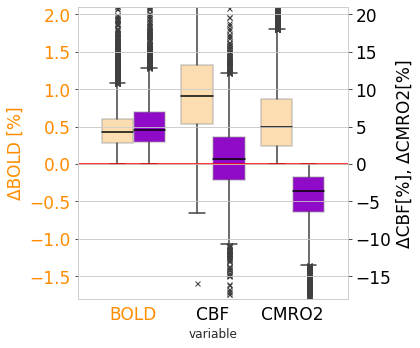

In [38]:
## pos
colormap = (["navajowhite", "darkviolet" ])
fig, ax = plt.subplots(1, figsize= (6,5))

sns.boxplot(x='variable', y='value', hue='ROI', data=df_percchange_pos_melted, ax=ax, palette=colormap, saturation=0.9,
                   boxprops={"edgecolor": (.6, .6, .6, .5)}, flierprops={"marker": "x"},
                   medianprops={"color": "black"})

for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontsize(fontsize)
    #ax.set_title('coupling CBF/BOLD, CMRO2/BOLD')

if task[0] != 'mem':
    color = 'darkorange'
if task[0] == 'mem':
    color = 'darkorange'
ax.set_ylim(-1.8, 2.1)
ax.set_yticks([-1.5, -1,  -0.5, 0,  0.5,  1, 1.5, 2])

#ax.set_ylim(-0.2, 1.25)
#ax.set_yticks([0, 0.25, 0.5, 0.75, 1, 1.25])
## set line at y=0
ax.hlines(0, -0.7, 2.7, colors='red', linestyles='solid')
ax.tick_params(axis='y', labelcolor=color)
ax.set_ylabel('ΔBOLD [%]', fontsize = fontsize, color=color)  # we already handled the x-label with ax1
ax.set_xticklabels(['BOLD', 'CBF', 'CMRO2'])  # we already handled the x-label with ax1
[t.set_color(i) for (i,t) in zip([color,'black','black'],ax.xaxis.get_ticklabels())]
#ax.legend(fontsize=fontsize-5,loc="upper left")
ax.legend_.remove()

ax2 = ax.twinx()  # instantiate a second axes that shares the same x-axis

color = 'black'
#ax2.plotsns.barplot(x="ROI", y="percchange", hue="parameter", data=df_percchange_median, estimator=np.median, ci=95, capsize=.05, n_boot=2000, errwidth=1,
#                 saturation=0.9, alpha=0.8)
ax2.tick_params(axis='y', labelcolor=color)
ax2.set_ylim(-18, 21)
ax2.set_yticks([-15, -10, -5, 0, 5, 10, 15, 20])

#ax2.set_ylim(-2, 12.5)
#ax2.set_yticks([0, 2.5, 5, 7.5, 10, 12.5])

ax2.set_ylabel('ΔCBF[%], ΔCMRO2[%]', color=color, fontsize = fontsize)  # we already handled the x-label with ax1

#set x-tick and y-ticke label size
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontsize(fontsize)
for label in (ax2.get_xticklabels() + ax2.get_yticklabels()):
    label.set_fontsize(fontsize)

fig.tight_layout()  # otherwise the right y-label is slightly clipped
fig.show()

fig.savefig(results_dir + '/N' + N_subj + '_BOLD' + '_' + par + '_inline_oppos_BOLD_CMRO2_CBF_pos.png', dpi=300, bbox_inches='tight')

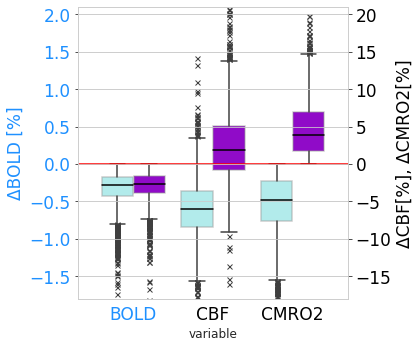

In [39]:
## neg
colormap = (["paleturquoise", "darkviolet" ])
fig, ax = plt.subplots(1, figsize= (6,5))

sns.boxplot(x='variable', y='value', hue='ROI', data=df_percchange_neg_melted, ax=ax, palette=colormap, saturation=0.9,
                   boxprops={"edgecolor": (.6, .6, .6, .5)}, flierprops={"marker": "x"},
                   medianprops={"color": "black"})
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
        label.set_fontsize(fontsize)
    #ax.set_title('coupling CBF/BOLD, CMRO2/BOLD')

if task[0] != 'mem':
    color = 'dodgerblue'
if task[0] == 'mem':
    color = 'dodgerblue'
ax.set_ylim(-1.8, 2.1)
ax.set_yticks([-1.5, -1,  -0.5, 0,  0.5,  1, 1.5, 2])
if baseline == 'rest':
    ax.set_ylim(-2, 3)
    ax.set_yticks([-1, -0.5, 0,  0.5, 1.5,  2])
#ax.set_ylim(-0.2, 1.25)
#ax.set_yticks([0, 0.25, 0.5, 0.75, 1, 1.25])
## set line at y=0
ax.hlines(0, -0.7, 2.7, colors='red', linestyles='solid')
ax.tick_params(axis='y', labelcolor=color)
ax.set_ylabel('ΔBOLD [%]', fontsize = fontsize, color=color)  # we already handled the x-label with ax1
ax.set_xticklabels(['BOLD', 'CBF', 'CMRO2'])  # we already handled the x-label with ax1
[t.set_color(i) for (i,t) in zip([color,'black','black'],ax.xaxis.get_ticklabels())]
#ax.legend(fontsize=fontsize-5,loc="upper left")
ax.legend_.remove()

ax2 = ax.twinx()  # instantiate a second axes that shares the same x-axis

color = 'black'
#ax2.plotsns.barplot(x="ROI", y="percchange", hue="parameter", data=df_percchange_median, estimator=np.median, ci=95, capsize=.05, n_boot=2000, errwidth=1,
#                 saturation=0.9, alpha=0.8)
ax2.tick_params(axis='y', labelcolor=color)
ax2.set_ylim(-18, 21)
ax2.set_yticks([-15, -10, -5, 0, 5, 10, 15, 20])

#ax2.set_ylim(-2, 12.5)
#ax2.set_yticks([0, 2.5, 5, 7.5, 10, 12.5])

ax2.set_ylabel('ΔCBF[%], ΔCMRO2[%]', color=color, fontsize = fontsize)  # we already handled the x-label with ax1

#set x-tick and y-ticke label size
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontsize(fontsize)
for label in (ax2.get_xticklabels() + ax2.get_yticklabels()):
    label.set_fontsize(fontsize)

fig.tight_layout()  # otherwise the right y-label is slightly clipped
fig.show()

fig.savefig(results_dir + '/N' + N_subj + '_BOLD' + '_' + par + '_inline_oppos_BOLD_CMRO2_CBF_neg.png', dpi=300, bbox_inches='tight')        

## plot in brain

### within PLS BOLD group mask

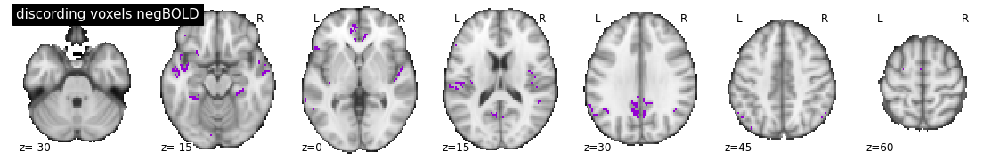

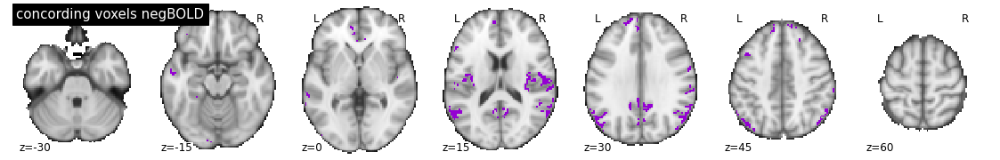

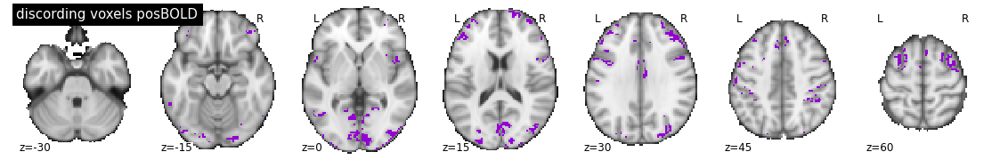

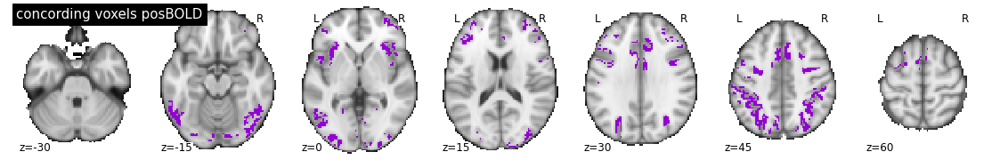

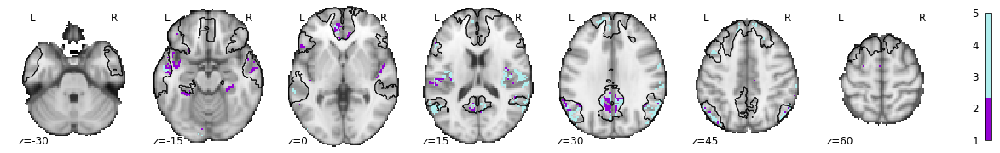

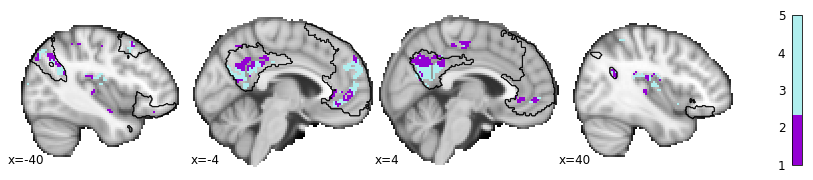

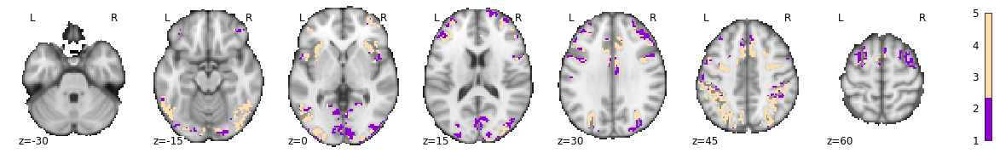

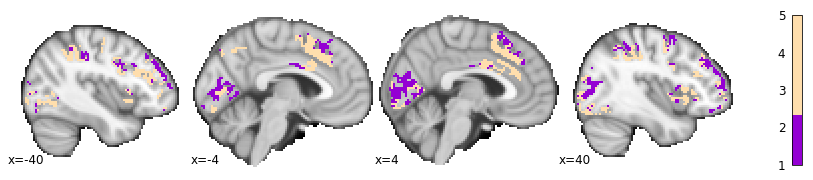

In [46]:
from matplotlib.colors import ListedColormap
DMN = os.path.join(derivatives_dir,'Yeo2011_7Networks_MNI152_FreeSurferConformed2mm_MNI_DMN.nii.gz')

cmap_neg = ListedColormap(["darkviolet", "darkviolet", "paleturquoise", "paleturquoise"  ])
cmap_pos = ListedColormap(["darkviolet", "darkviolet", "navajowhite","navajowhite"])

neg_BOLD_idx = np.where(BOLD_percchange_median<0)
pos_BOLD_idx = np.where(BOLD_percchange_median>0)

neg_CMRO2_idx = np.where(CMRO2_percchange_median<0)
pos_CMRO2_idx = np.where(CMRO2_percchange_median>0)

neg_BOLD_pos_CMRO2 = np.intersect1d(neg_BOLD_idx[0], pos_CMRO2_idx[0])
neg_BOLD_neg_CMRO2 = np.intersect1d(neg_BOLD_idx[0], neg_CMRO2_idx[0])
pos_BOLD_neg_CMRO2 = np.intersect1d(pos_BOLD_idx[0], neg_CMRO2_idx[0])
pos_BOLD_pos_CMRO2 = np.intersect1d(pos_BOLD_idx[0], pos_CMRO2_idx[0])

##create niftis 
neg_BOLD_pos_CMRO2_nii = np.zeros(len(BOLD_percchange_median))
neg_BOLD_pos_CMRO2_nii[neg_BOLD_pos_CMRO2] = 1
neg_BOLD_pos_CMRO2_nifti = masker.inverse_transform(neg_BOLD_pos_CMRO2_nii)
nib.save(neg_BOLD_pos_CMRO2_nifti, os.path.join(results_dir, 'negBOLD_posCMRO2_' + contrast +'_' + whole_brain_masking + '.nii.gz'))
disp=plotting.plot_img(neg_BOLD_pos_CMRO2_nifti, bg_img=MNI_2mm_brain, threshold = 0, display_mode='z', cmap=cmap_neg, 
                cut_coords = coords, vmin = 1, vmax = 5, title='discording voxels negBOLD')

neg_BOLD_neg_CMRO2_nii = np.zeros(len(BOLD_percchange_median))
neg_BOLD_neg_CMRO2_nii[neg_BOLD_neg_CMRO2] = 1
neg_BOLD_neg_CMRO2_nifti = masker.inverse_transform(neg_BOLD_neg_CMRO2_nii)
nib.save(neg_BOLD_neg_CMRO2_nifti, os.path.join(results_dir, 'negBOLD_negCMRO2_' + contrast +'_' + whole_brain_masking  +'.nii.gz'))
disp=plotting.plot_img(neg_BOLD_neg_CMRO2_nifti, bg_img=MNI_2mm_brain, threshold = 0, display_mode='z', cmap=cmap_neg, 
                cut_coords = coords, vmin = 1, vmax = 5, title='concording voxels negBOLD')

pos_BOLD_neg_CMRO2_nii = np.zeros(len(BOLD_percchange_median))
pos_BOLD_neg_CMRO2_nii[pos_BOLD_neg_CMRO2] = 1
pos_BOLD_neg_CMRO2_nifti = masker.inverse_transform(pos_BOLD_neg_CMRO2_nii)
nib.save(pos_BOLD_neg_CMRO2_nifti, os.path.join(results_dir,  'posBOLD_negCMRO2_' + contrast + '_' + whole_brain_masking+ '.nii.gz'))
disp=plotting.plot_img(pos_BOLD_neg_CMRO2_nifti, bg_img=MNI_2mm_brain, threshold = 0, display_mode='z', cmap=cmap_neg, 
                cut_coords = coords, vmin = 1, vmax = 5, title='discording voxels posBOLD')

pos_BOLD_pos_CMRO2_nii = np.zeros(len(BOLD_percchange_median))
pos_BOLD_pos_CMRO2_nii[pos_BOLD_pos_CMRO2] = 1
pos_BOLD_pos_CMRO2_nifti = masker.inverse_transform(pos_BOLD_pos_CMRO2_nii)
nib.save(pos_BOLD_pos_CMRO2_nifti, os.path.join(results_dir, 'posBOLD_posCMRO2_' + contrast +'_' + whole_brain_masking + '.nii.gz'))
disp=plotting.plot_img(pos_BOLD_pos_CMRO2_nifti, bg_img=MNI_2mm_brain, threshold = 0, display_mode='z', cmap=cmap_neg, 
                cut_coords = coords, vmin = 1, vmax = 5, title='concording voxels posBOLD')

##create nifti :negative BOLD
neg_BOLD_pos_CMRO2_nii = np.zeros(len(BOLD_percchange_median))
neg_BOLD_pos_CMRO2_nii[neg_BOLD_pos_CMRO2] = 2 ## discordant
neg_BOLD_pos_CMRO2_nii[neg_BOLD_neg_CMRO2] = 4 ## concordant
neg_BOLD_pos_CMRO2_nifti = masker.inverse_transform(neg_BOLD_pos_CMRO2_nii)
disp=plotting.plot_img(neg_BOLD_pos_CMRO2_nifti, bg_img=MNI_2mm_brain, threshold = 0, display_mode='z', cmap=cmap_neg, 
                cut_coords = coords, vmin = 1, vmax = 5, colorbar=True)
if task == 'calc':
    disp.add_contours(DMN,  colors='black', alpha = 1, linewidths=0.3)
disp=plotting.plot_img(neg_BOLD_pos_CMRO2_nifti, bg_img=MNI_2mm_brain, threshold = 0, display_mode='z', cmap=cmap_neg, 
                cut_coords = coords, vmin = 1, vmax = 5,
                output_file=results_dir + '/CMRO2_deviation_negBOLD_' + contrast +  '.png')
disp=plotting.plot_img(neg_BOLD_pos_CMRO2_nifti, bg_img=MNI_2mm_brain, threshold = 0, display_mode='x', cmap=cmap_neg, 
                cut_coords = [-40,-4,4, 40], vmin = 1, vmax = 5, colorbar=True)
if task == 'calc':
    disp.add_contours(DMN,  colors='black', alpha = 1, linewidths=0.3)
disp=plotting.plot_img(neg_BOLD_pos_CMRO2_nifti, bg_img=MNI_2mm_brain, threshold = 0, display_mode='x', cmap=cmap_neg, 
                cut_coords = [-40,-4,4, 40], vmin = 1, vmax = 5,
                output_file=results_dir + '/CMRO2_deviation_negBOLD_' + contrast +  '_sag.png')



##create nifti :positive BOLD

pos_BOLD_neg_CMRO2_nii = np.zeros(len(BOLD_percchange_median))
pos_BOLD_neg_CMRO2_nii[pos_BOLD_neg_CMRO2] = 2 ## discordant
pos_BOLD_neg_CMRO2_nii[pos_BOLD_pos_CMRO2] = 4 ## concordant
pos_BOLD_neg_CMRO2_nii_nifti = masker.inverse_transform(pos_BOLD_neg_CMRO2_nii)

disp=plotting.plot_img(pos_BOLD_neg_CMRO2_nii_nifti, bg_img=MNI_2mm_brain, threshold = 0, display_mode='z', cmap=cmap_pos, 
                cut_coords = coords, vmin = 1, vmax =5, colorbar=True)
if task == 'mem':
    disp.add_contours(DMN,  colors='black', alpha = 1, linewidths=0.3)
disp=plotting.plot_img(pos_BOLD_neg_CMRO2_nii_nifti, bg_img=MNI_2mm_brain, threshold = 0, display_mode='z', cmap=cmap_pos, 
                cut_coords = coords, vmin = 1, vmax = 5,
                output_file=results_dir + '/CMRO2_deviation_posBOLD_'+ contrast +  '.png')
disp=plotting.plot_img(pos_BOLD_neg_CMRO2_nii_nifti, bg_img=MNI_2mm_brain, threshold = 0, display_mode='x', cmap=cmap_pos, 
                cut_coords = [-40,-4,4, 40], vmin = 1, vmax = 5, colorbar=True)
if task == 'mem':
    disp.add_contours(DMN,  colors='black', alpha = 1, linewidths=0.3)
disp=plotting.plot_img(pos_BOLD_neg_CMRO2_nii_nifti, bg_img=MNI_2mm_brain, threshold = 0, display_mode='x', cmap=cmap_pos, 
                cut_coords = [-40,-4,4, 40], vmin = 1, vmax = 5,
                output_file=results_dir + '/CMRO2_deviation_posBOLD_' + contrast +  '_sag.png')

